# Study - E vs Delta-Z

In [1]:
import time
print("Last updated on ", time.asctime())

Last updated on  Fri Nov 30 20:46:00 2018


In [2]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [3]:
import os
import time
import datetime

import tables            as tb
import numpy             as np
import matplotlib.pyplot as plt
import matplotlib.dates  as md
import collections       as collections
import pandas            as pd

from   scipy import optimize
import invisible_cities.core.fit_functions as fitf
from  invisible_cities.core .core_functions import in_range

import krcal.utils.plt_functions          as krplot
import krcal.utils.hst_extend_functions   as hst

import csth.utils.cepeak_plot             as cpkplot

In [4]:
# Plotting style
default_cmap = "jet"
figure_size  = 14, 8
font_size    = 14

plt.rcParams["figure.figsize"] =   figure_size
plt.rcParams[  "font.size"   ] =   font_size

In [5]:
run_numbers = [6341,]
trigger    = 'trigger2'
#input_filename = f"$IC_DATA/{run_number}/pmaps/cepks_{run_number}_90_9188_{trigger}.h5"
tag = '6q0min_v1'
input_filenames = [f"$IC_DATA/{run_number}/cepks/cepks_{run_number}_0000_11999_{tag}.h5" for run_number in run_numbers]
input_files     = [os.path.expandvars(ifile) for ifile in input_filenames]

In [6]:
def esum_from_hdf(filename, clear = True):
    print(filename)
    h = pd.HDFStore(filename)
    esum = h['esum']
    print('total events :', len(esum))
    esum.dropna()
    sel_base = (esum.nslices > 0) & (esum.nhits > 0) & (esum.s1e > 0) & (esum.q0 > 0) & (esum.e0 > 0)
    esum = esum[sel_base]
    print('clean events :', len(esum) )
    #esum0 = esum[sel_base]
    #h.close()
    return esum

In [7]:
esums = [esum_from_hdf(ifile) for ifile in input_files]

/Users/hernando/investigacion/NEXT/data/runIV//6341/cepks/cepks_6341_0000_11999_6q0min_v1.h5
total events : 203104
clean events : 203104


In [8]:
#cpkplot.df(esum)

In [9]:
Ea = hst.Vaxis((0., 700e3), 500)
def canvas_e(esums):
    alpha = 1./len(esums)
    #c = hst.Canvas(1, 1)
    for i, esum in enumerate(esums):
        plt.hist(esum.e, Ea.bins, alpha = alpha) 
        plt.xlabel('E (pes)')
    plt.yscale('log')
    plt.legend()
    plt.tight_layout()

No handles with labels found to put in legend.


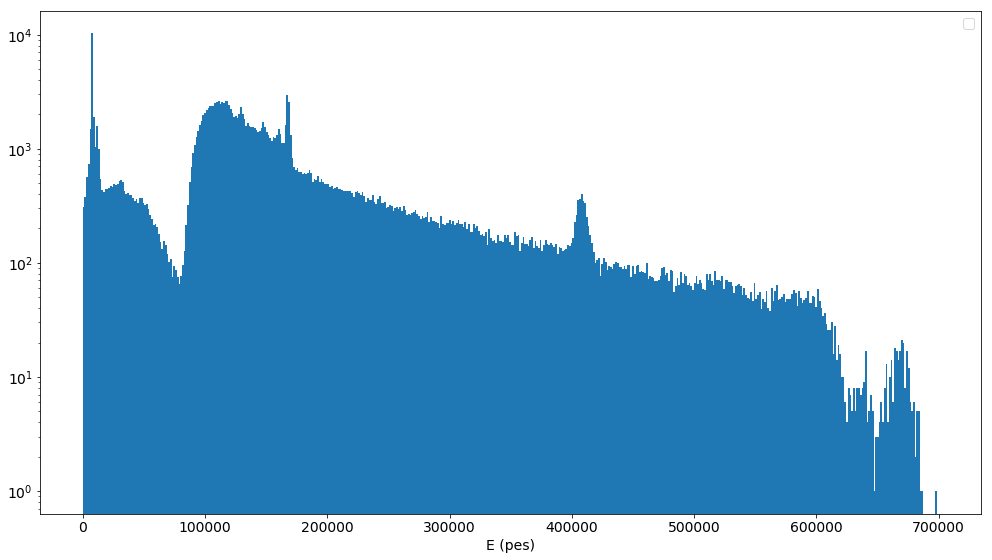

In [10]:
canvas_e(esums)

In [11]:
tags = [str(run) for run in run_numbers]
Exra = hst.Vaxis((  5e3,  10e3), 100)
Ecsa = hst.Vaxis((110e3, 190e3), 100)
Edsa = hst.Vaxis((350e3, 450e3), 100)
Etha = hst.Vaxis((500e3, 750e3), 100)
def canvas_eregions(esums, i0 = 0):
    alpha = 1./len(esums)
    c = hst.Canvas(2, 2)
    for i, esum in enumerate(esums):
        hst.hist(esum.e, Exra.bins, alpha = alpha, stats = None, canvas = c(1), label = tags[i + i0], xylabels=('E (pes)',''))
        hst.hist(esum.e, Ecsa.bins, alpha = alpha, stats = None, canvas = c(2), label = tags[i + i0], xylabels=('E (pes)',''))
        hst.hist(esum.e, Edsa.bins, alpha = alpha, stats = None, canvas = c(3), label = tags[i + i0], xylabels=('E (pes)',''))
        hst.hist(esum.e, Etha.bins, alpha = alpha, stats = None, canvas = c(4), label = tags[i + i0], xylabels=('E (pes)',''))
    plt.legend()
    plt.tight_layout()

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


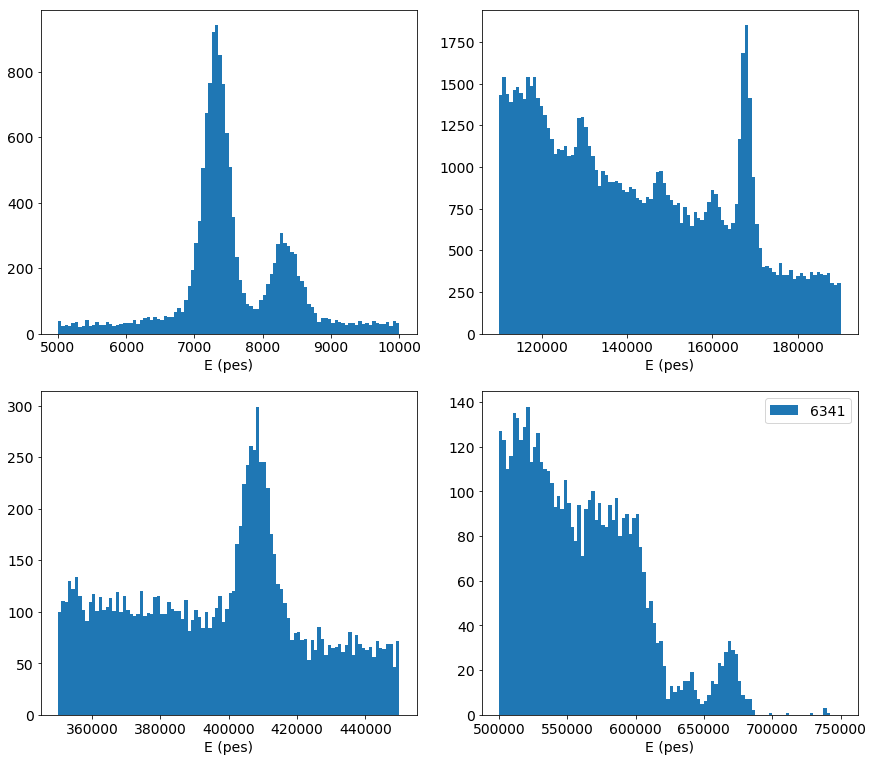

In [12]:
canvas_eregions(esums, 0)
#canvas_eregions(esums[4:],  4)

In [13]:
import csth.utils.photopeak_fit as phfit

In [14]:
import csth.utils.fits as efit

def plot_extll_fit_dev(es, e0, e1, mushat, nbins = 100, alpha = 0.5, tag = ''):
    pg = efit.Pol1DGaus(a = e0, b = e1, shapes = 'mu, sigma, mslope, f')
    mu, sigma, mslope, nug, nup = mushat[0], mushat[1], mushat[2], mushat[3], mushat[4]
    ntot = nug + nup
    f = float(nug)/float(nug+nup)
    pf = efit.Pol1DGaus(a = e0, b = e1, shapes = 'mu, sigma, mslope, f')
    xs = np.linspace(e0, e1, nbins)
    dx = xs[1]-xs[0]
    ys = ntot * dx * pg.pdf(xs, mu = mu, sigma = sigma, mslope = mslope, f = f)
    plt.hist(es, nbins, range = (e0, e1), alpha = alpha)
    fwhm = 235.* sigma/mu
    label = tag + ' n = ' + str(int(nug)) + ', $\mu$ = ' + "{0:.0f}".format(mu) + ', FWHM (%) = ' + "{0:.2f}".format(fwhm)
    plt.plot(xs, ys, ls= '-', lw = 2, label = label, alpha = alpha)
    plt.xlim(e0, e1)
    plt.legend(fontsize=11)
    return (xs, ys)
    


In [15]:
esum = esums[0]
print(len(esum))
for i, iesum in enumerate(esums[1:]):
    esum = esum.append(iesum, ignore_index = True)
print(len(esum))

203104
203104


In [16]:
def canvas_esigma(esum, erange, nbins= 100, tag='', alpha = 0.5):
    e0, e1 = erange
    dssel = in_range(esum.e, e0, e1)
    es = esum.e[dssel]
    n     = np.sum(dssel)
    mu    = np.mean(es)
    sigma = np.std(es)
    mslope = 0.
    f      = 0.5
    x0     = np.array([n/2, n/2, mslope, mu, sigma])
    
    res, cov = phfit.pkfit(es, (e0, e1), x0)
    xhat = res.x
    print('xhat ', xhat)
    nug, nup, slopehat, muhat, sighat = xhat[0], xhat[1], xhat[2], xhat[3], xhat[4]
    
    s  = 'n :'+str(int(nug))+'\n'
    s += '$\mu$ :'+ "{0:.1f}".format(muhat) +'\n'
    s += '$\sigma$ :'+ "{0:.1f}".format(sighat)
    
    
    #mushat = efit.extll_fit_pol1dgaus(es, e0, e1)
    print(es.min(), es.max())
    ys, xs, _ = plt.hist(es, nbins, range = erange, label = s)
    xs = 0.5*(xs[1:] + xs[:-1])

    ys = phfit.pkpdf(xs, xhat, erange)
    dx = xs[1] - xs[0]
    plt.plot(xs, ys * dx * n)
    plt.legend()
    
    #print(xs)
    
    #plt.xlim(e0, e1)
    #dat = plot_extll_fit(es, e0, e1, mushat, tag = tag, alpha = alpha)
    return xhat

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/scipy/optimize/optimize.py:1927: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/scipy/optimize/optimize.py:1928: RuntimeWarning: invalid value encountered in double_scalars
  p = (x - v) * tmp2 - (x - w) * tmp1


Optimization terminated successfully.
         Current function value: 115280.106801
         Iterations: 22
         Function evaluations: 1856
xhat  [7.31364361e+03 1.99835652e+03 1.83959206e-07 7.31599796e+03
 1.72490540e+02]
6502.124596998843 7999.805227981427
Optimization terminated successfully.
         Current function value: 257508.457146
         Iterations: 17
         Function evaluations: 1347
xhat  [ 4.58060667e+03  1.20993930e+04 -2.63895147e-09  1.67870999e+05
  1.12015200e+03]
160000.3125939338 177998.64955181297
Optimization terminated successfully.
         Current function value: 182447.842503
         Iterations: 17
         Function evaluations: 1985
xhat  [ 1.93665847e+03  8.80234303e+03 -6.26800312e-11  4.08144546e+05
  3.97838157e+03]
350008.52656668064 449967.138869489
Optimization terminated successfully.
         Current function value: 4159.821607
         Iterations: 12
         Function evaluations: 1362
xhat  [ 1.65917538e+02  1.23082461e+02 -5.44569431e

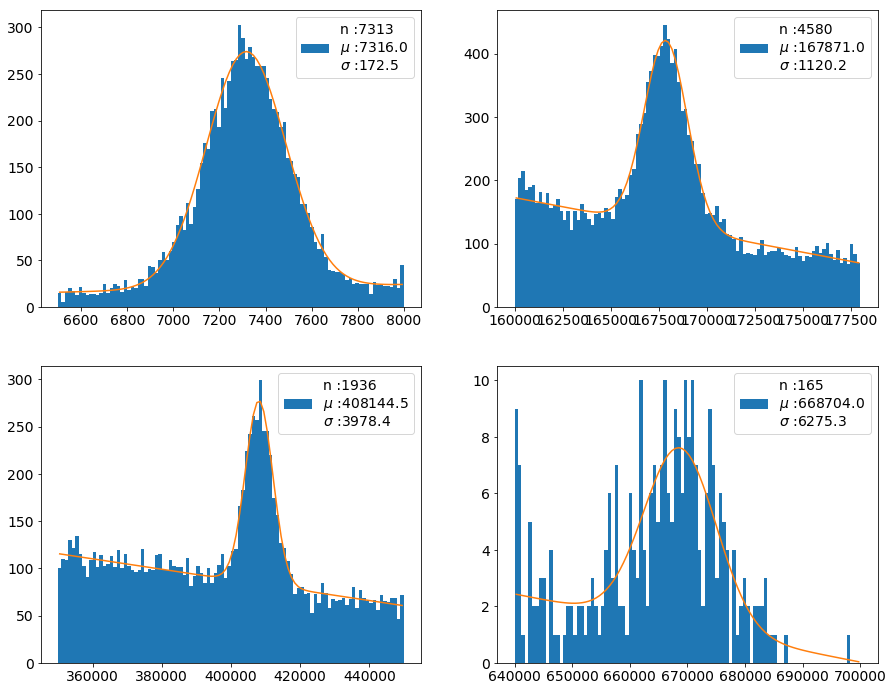

In [17]:
tag = '6341'
fig = plt.figure(figsize= (15, 12))
plt.subplot(2, 2, 1)
canvas_esigma(esum, (6.5e3, 8.0e3), tag = tag, alpha = 1.);
plt.subplot(2, 2, 2)
canvas_esigma(esum, (160e3, 178e3), tag = tag, alpha = 1.);
plt.subplot(2, 2, 3)
canvas_esigma(esum, (350e3, 450e3), tag = tag, alpha = 1.);
plt.subplot(2, 2, 4)
canvas_esigma(esum, (640e3, 700e3), tag = tag, alpha = 1.);

In [18]:
x, y = esum.x, esum.y
esum['r']    = np.sqrt(x*x + y*y )
esum['zmin'] = esum.zmax - esum.zsize
fidsel = esum.peak == 0

esum = esum[fidsel]
#fidsel = (esum.r < 1600) & (esum.zmin > 175.) & (esum.zmax < 375)

#esum0 = esum[fidsel]

## Studying E vs Z

In [19]:
def str_stats(xs, xrange = None, sig="{0:.3f}"):
    xrange = (xs.min(), xs.max()) if xrange is None else xrange
    xsel = in_range(xs, *xrange)
    xxs = xs[xsel]
    n, mu, std  = len(xxs), np.mean(xxs), np.std(xxs)
    s  = 'entries : '+ str(n)         + '\n'
    s += 'mean    : '+ sig.format(mu) +'\n'
    s += 'mean    : '+ sig.format(std)
    return s

def var_vs_var(esum, xname, xrange, yname, yrange, nbins = 50, sel = None, alpha = 0.01):

    xvar = esum[xname]
    yvar = esum[yname]

    xsel = (in_range(xvar, *xrange)) & (in_range(yvar, *yrange))
    if (sel is not None):
        xsel = xsel & sel
    
    c = hst.Canvas(1, 2)
    c(1)
    plt.scatter(xvar[xsel], yvar[xsel], alpha = alpha)
    xs, ys, eys = fitf.profileX(xvar[xsel], yvar[xsel], nbins)
    plt.errorbar(xs, ys, yerr=eys, fmt='*', c='black', alpha = 0.3) 
    xs, ys, eys = fitf.profileX(yvar[xsel], xvar[xsel], nbins)
    plt.errorbar(ys, xs, xerr=eys, fmt='+', c='red', alpha = 0.3) 
    plt.xlabel(xname)
    plt.ylabel(yname)
    plt.ylim(*yrange)
    c(2)
    s = str_stats(yvar[xsel])
    plt.hist(yvar[xsel], nbins, yrange, label = s)
    plt.xlabel(yname)
    plt.legend()
    plt.tight_layout()


In [20]:
eax   = hst.Vaxis((0.   , 700e3), 200)
ecsax = hst.Vaxis((120e3, 180e3), 100)
edsax = hst.Vaxis((390e3, 430e3), 100)
etlax = hst.Vaxis((640e3, 700e3),  20)

esel  = in_range(esum.e, *eax.range)
cssel = in_range(esum.e, *ecsax.range)
dssel = in_range(esum.e, *edsax.range)
tlsel = in_range(esum.e, *etlax.range)

## Z-size

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


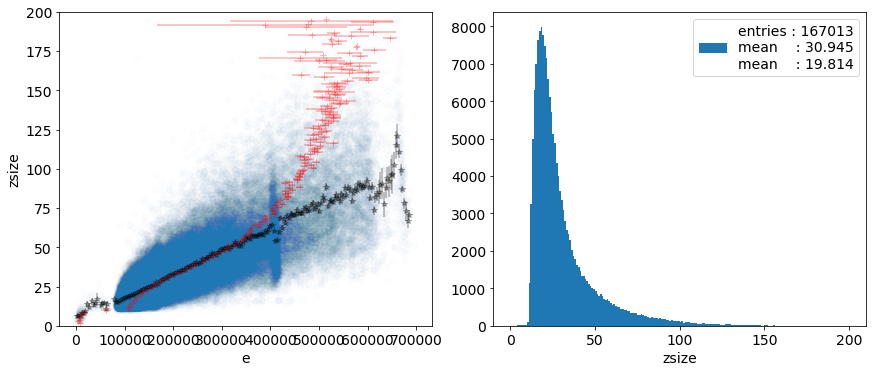

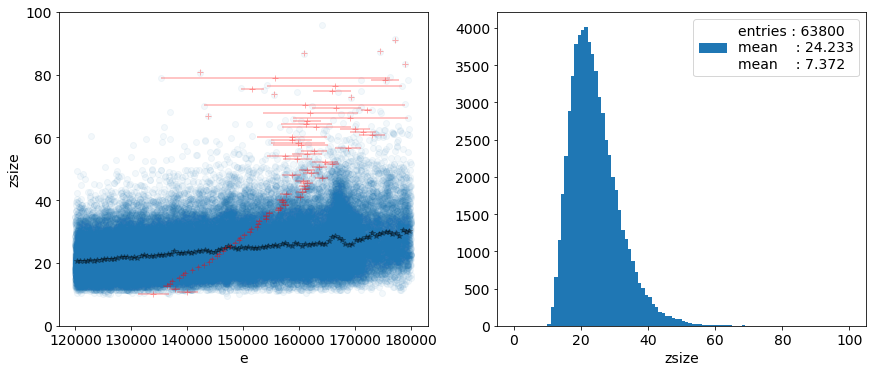

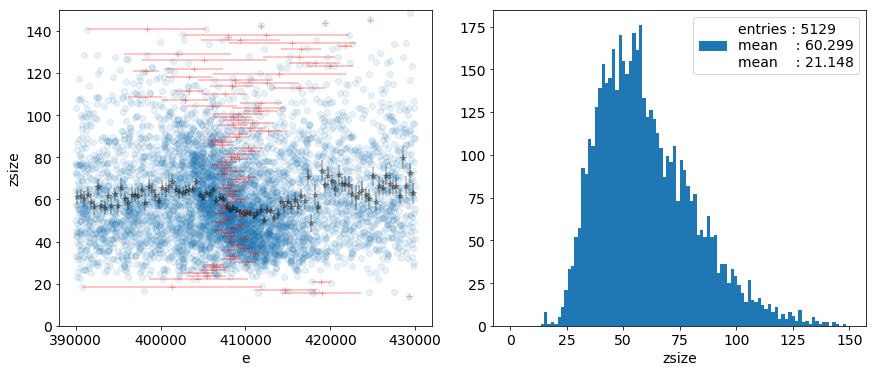

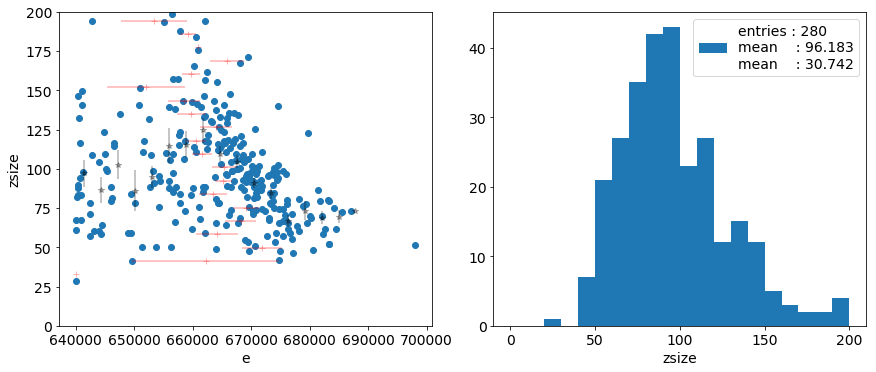

In [21]:
var_vs_var(esum, 'e', eax.range  , 'zsize', (0., 200), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'zsize', (0., 100), nbins = ecsax.nbins, alpha = 0.05)
var_vs_var(esum, 'e', edsax.range, 'zsize', (0., 150), nbins = edsax.nbins, alpha = 0.1)
var_vs_var(esum, 'e', etlax.range, 'zsize', (0., 200), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


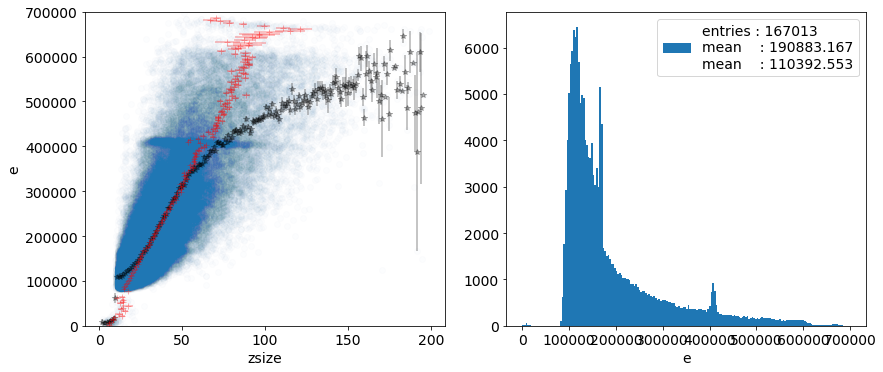

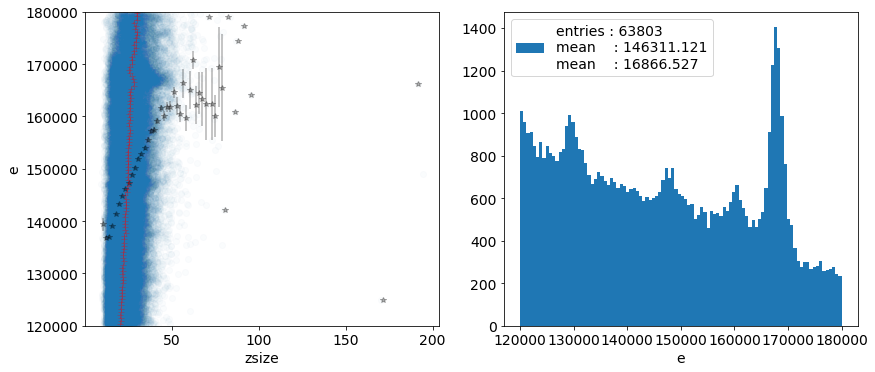

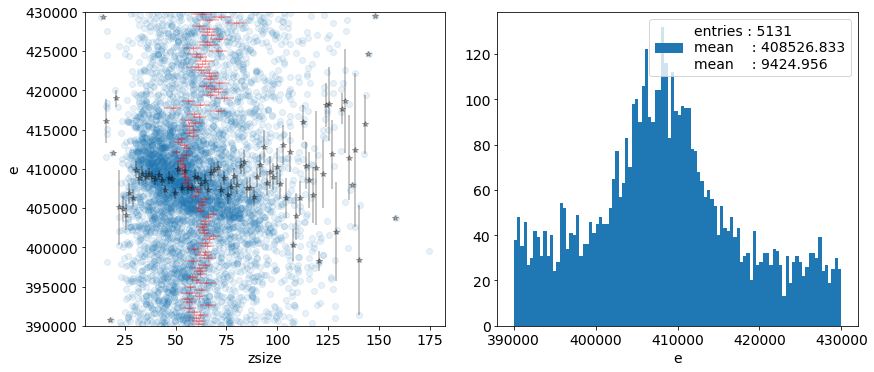

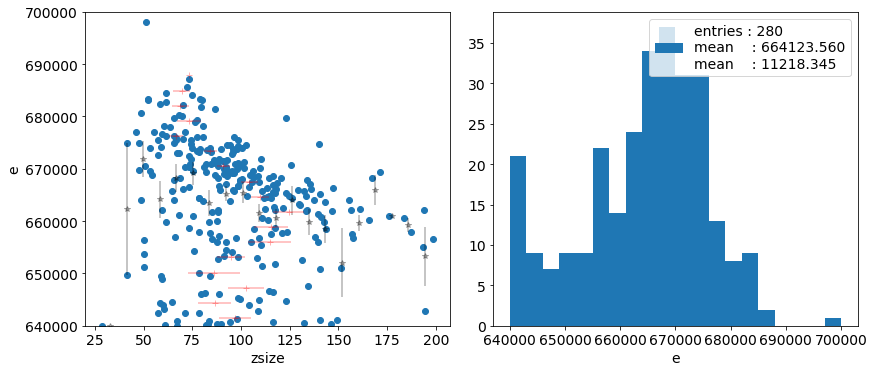

In [22]:
var_vs_var(esum, 'zsize', (0., 200), 'e',   eax.range, nbins =   eax.nbins, alpha = 0.01)
var_vs_var(esum, 'zsize', (0., 200), 'e', ecsax.range, nbins = ecsax.nbins, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 200), 'e', edsax.range, nbins = edsax.nbins, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'e', etlax.range, nbins = etlax.nbins, alpha = 1.)

## N-hits

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


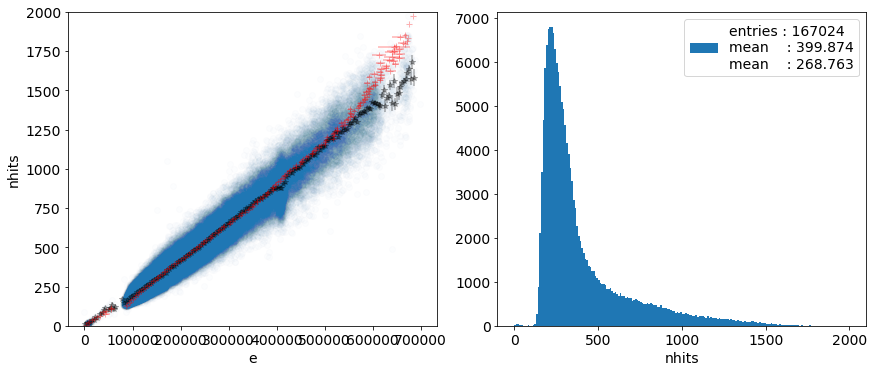

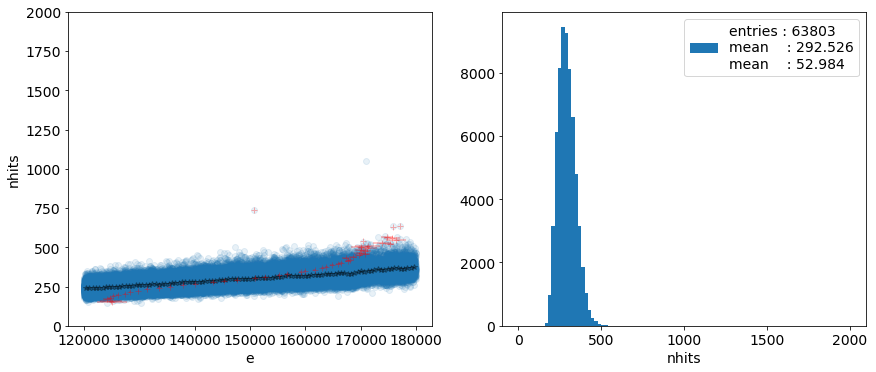

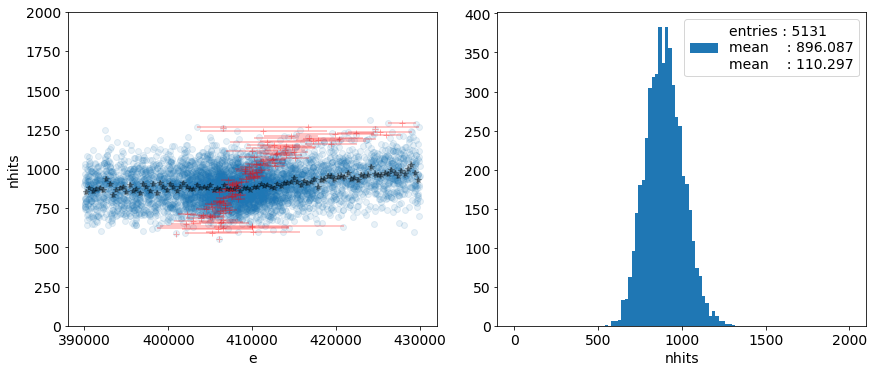

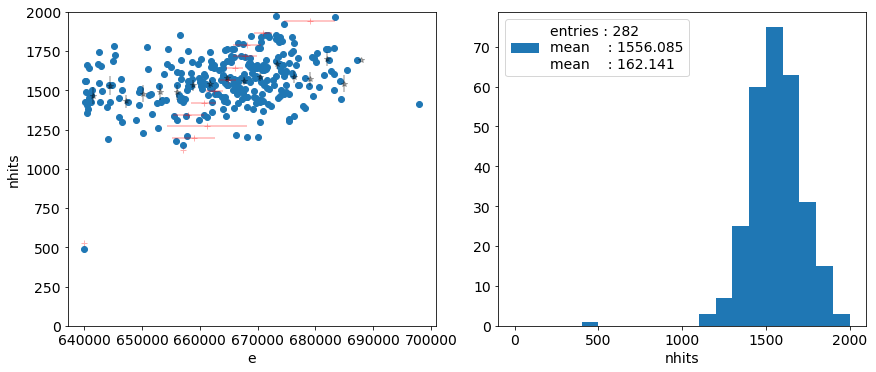

In [23]:
var_vs_var(esum, 'e', eax.range  , 'nhits', (0., 2000), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'nhits', (0., 2000), nbins = ecsax.nbins, alpha = 0.1)
var_vs_var(esum, 'e', edsax.range, 'nhits', (0., 2000), nbins = edsax.nbins, alpha = 0.1)
var_vs_var(esum, 'e', etlax.range, 'nhits', (0., 2000), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


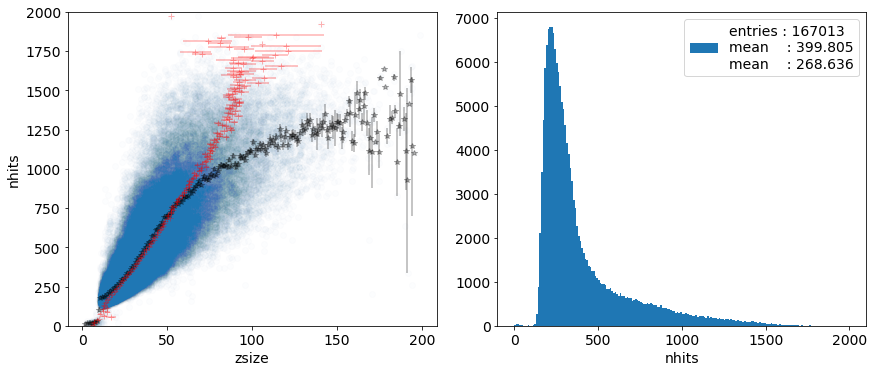

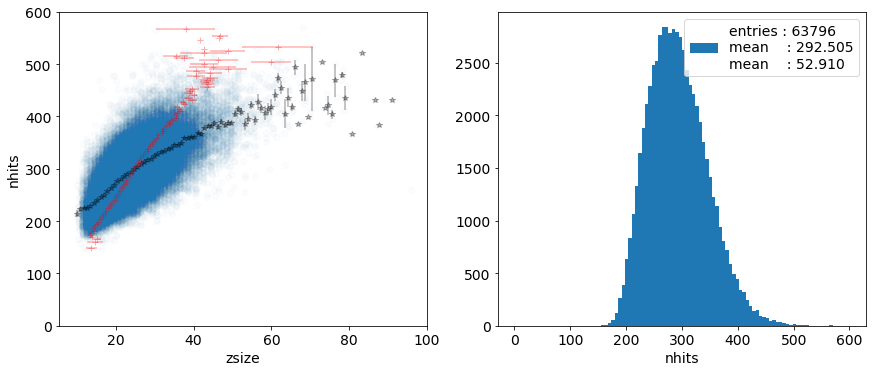

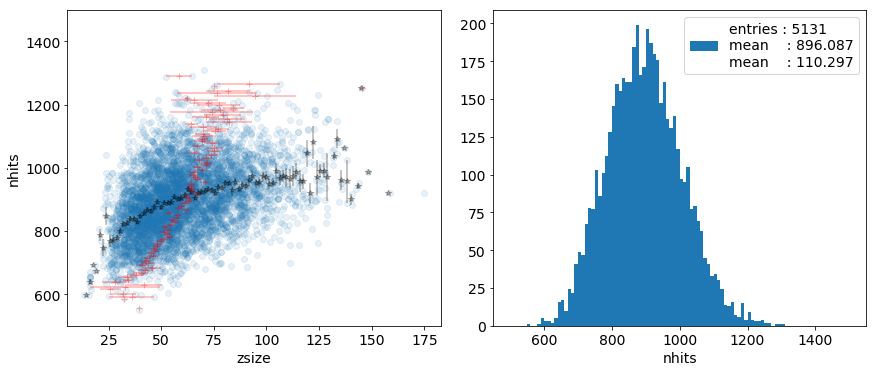

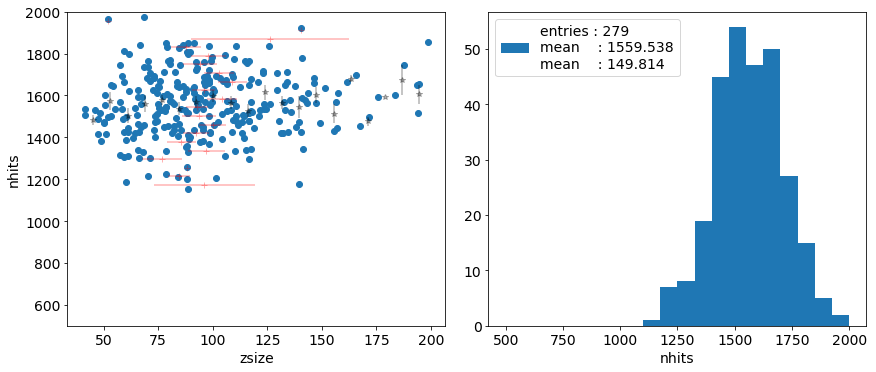

In [24]:
var_vs_var(esum, 'zsize', (0., 200), 'nhits', (0., 2000) , nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0., 100), 'nhits', (0., 600 ) , nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 200), 'nhits', (500, 1500), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'nhits', (500, 2000), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## Zmin

In [25]:
esum['zmin'] = esum.zmax - esum.zsize

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


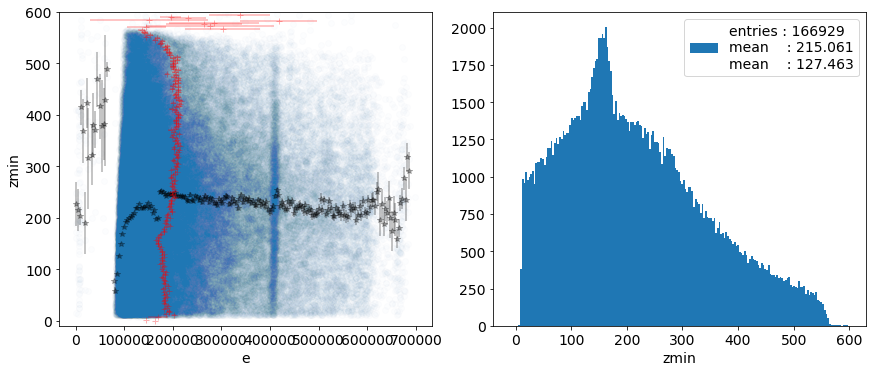

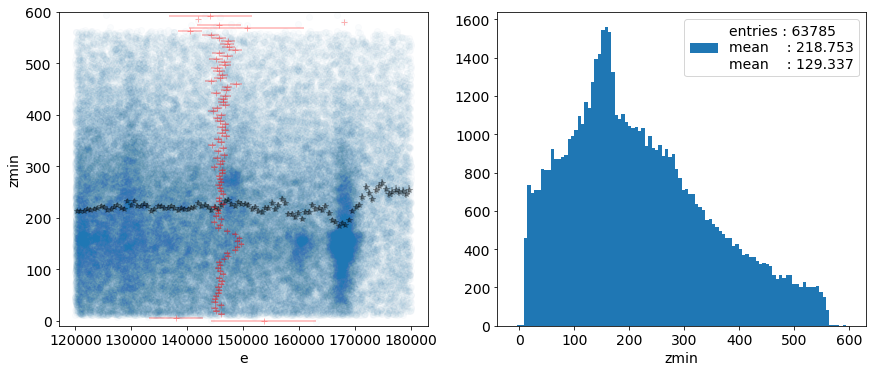

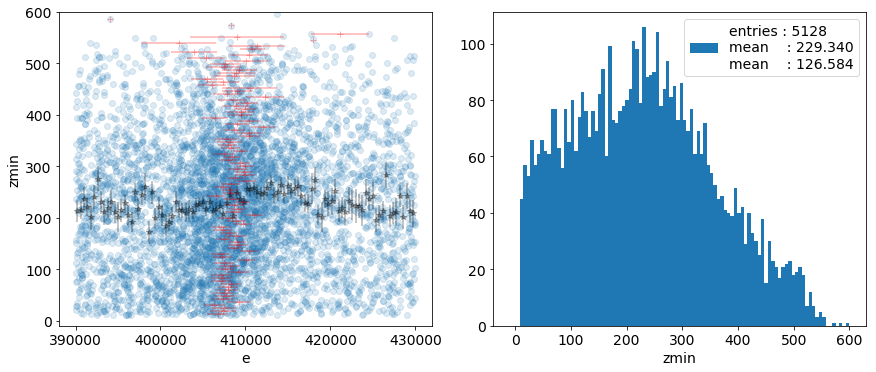

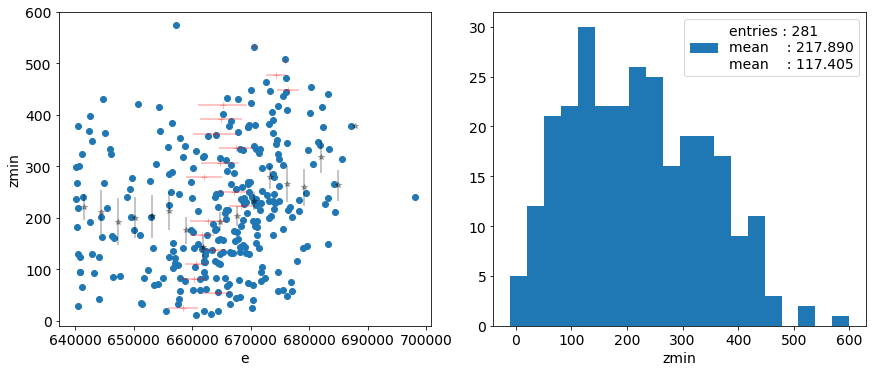

In [26]:
var_vs_var(esum, 'e', eax.range  , 'zmin', (-10., 600), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'zmin', (-10., 600), nbins = ecsax.nbins, alpha = 0.02)
var_vs_var(esum, 'e', edsax.range, 'zmin', (-10., 600), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'zmin', (-10., 600), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


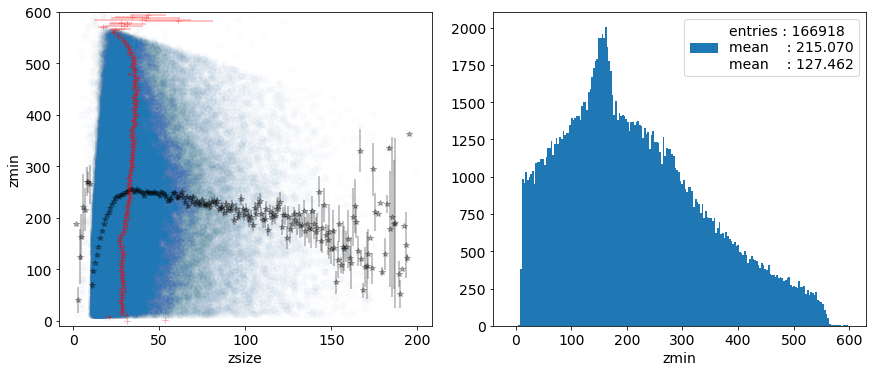

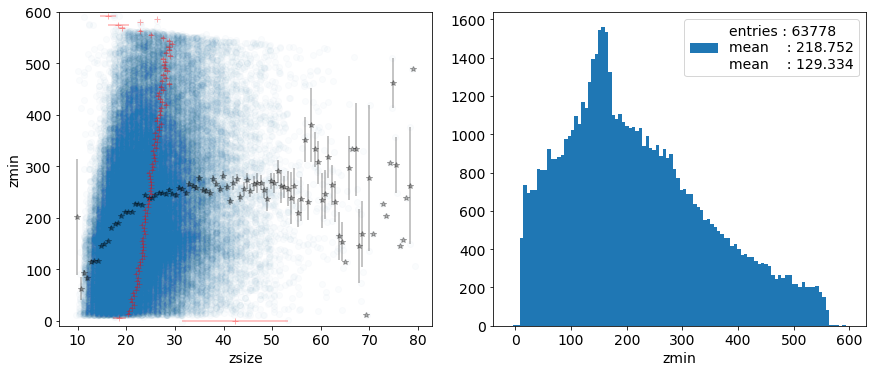

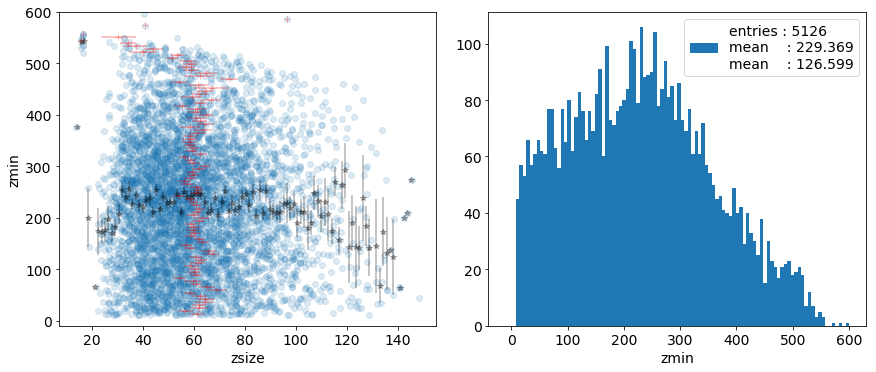

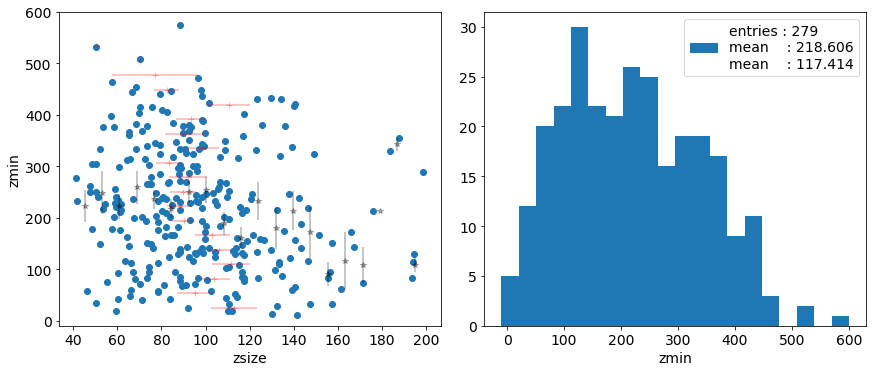

In [27]:
var_vs_var(esum, 'zsize', (0., 200), 'zmin', (-10, 600), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'zmin', (-10, 600), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'zmin', (-10, 600), nbins = edsax.nbins, sel = dssel, alpha = 0.15)
var_vs_var(esum, 'zsize', (0., 200), 'zmin', (-10, 600), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## Zmax

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


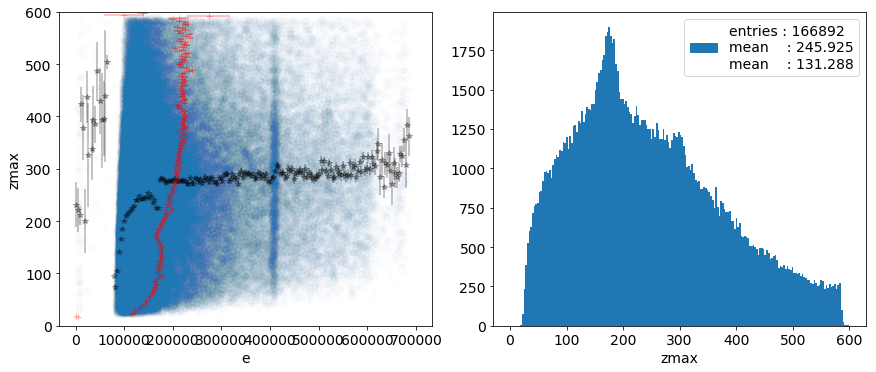

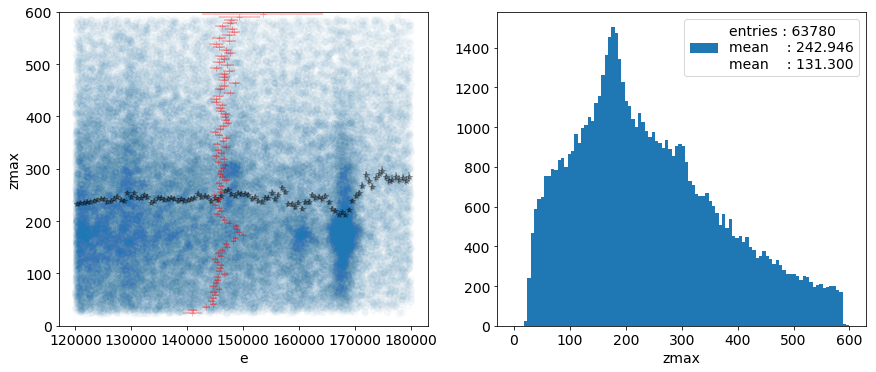

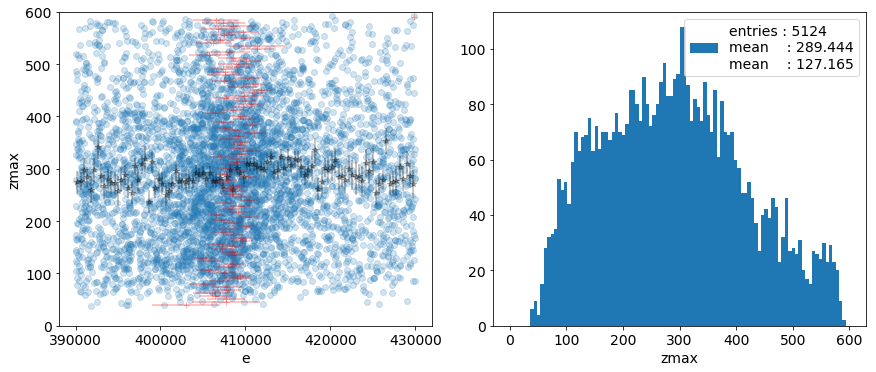

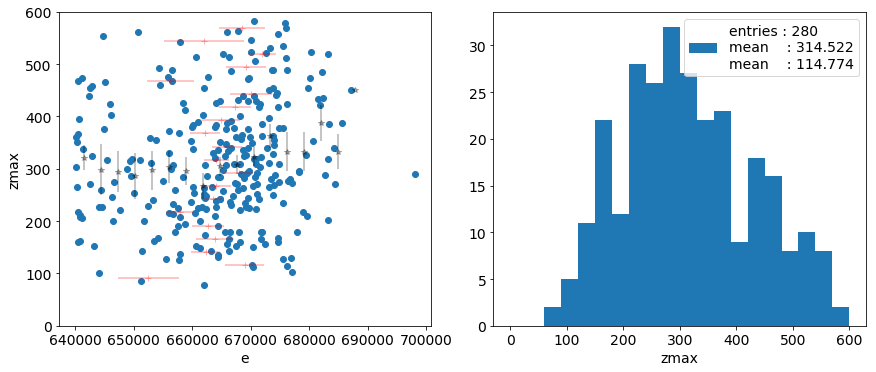

In [28]:
var_vs_var(esum, 'e', eax.range  , 'zmax', (0., 600), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'zmax', (0., 600), nbins = ecsax.nbins, alpha = 0.02)
var_vs_var(esum, 'e', edsax.range, 'zmax', (0., 600), nbins = edsax.nbins, alpha = 0.2)
var_vs_var(esum, 'e', etlax.range, 'zmax', (0., 600), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


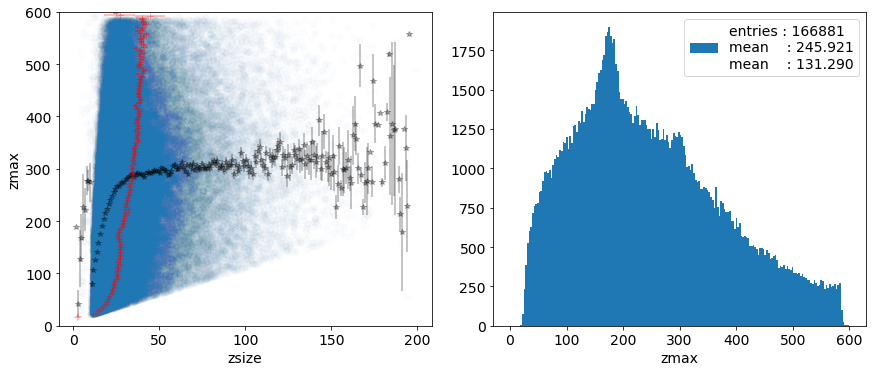

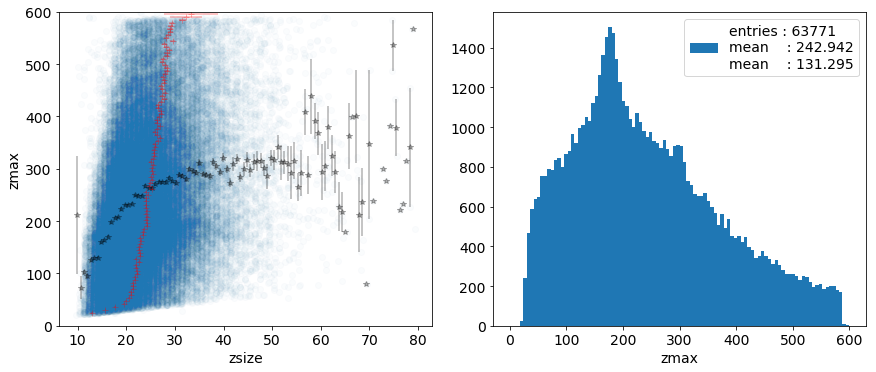

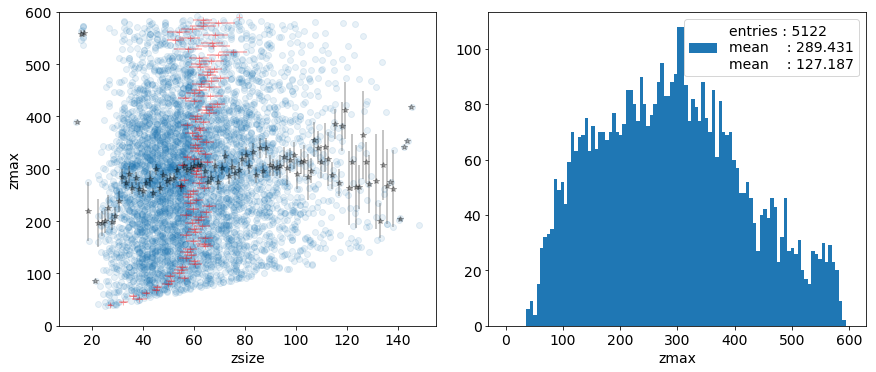

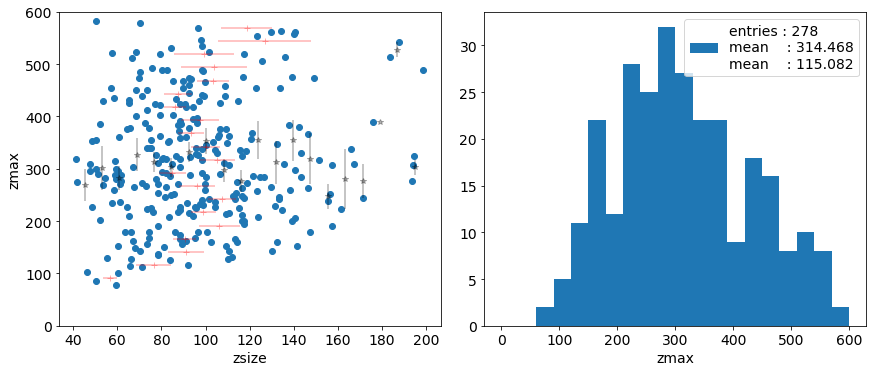

In [29]:
var_vs_var(esum, 'zsize', (0., 200), 'zmax', (0, 600), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'zmax', (0, 600), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'zmax', (0, 600), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'zmax', (0, 600), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## Z

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


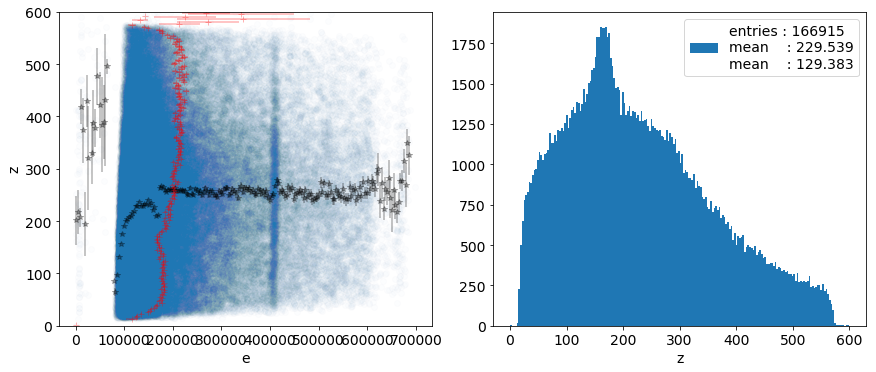

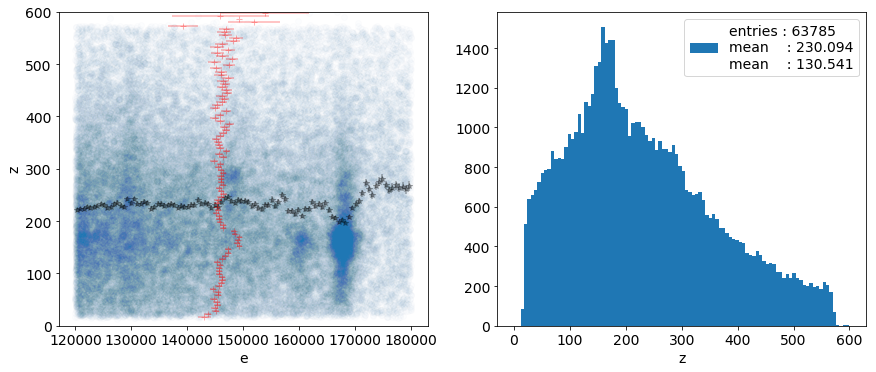

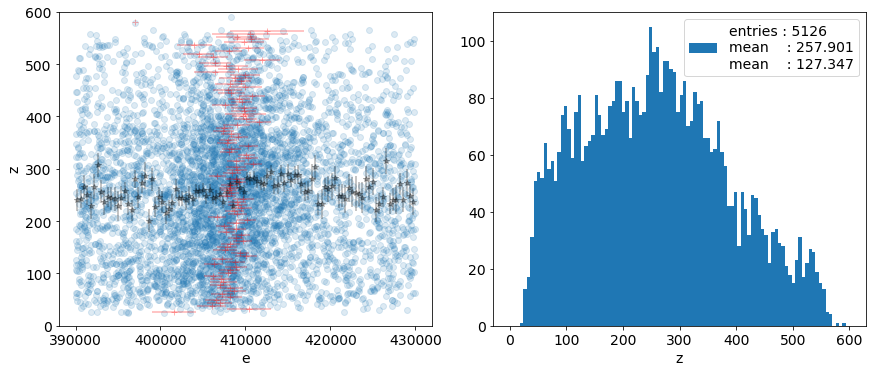

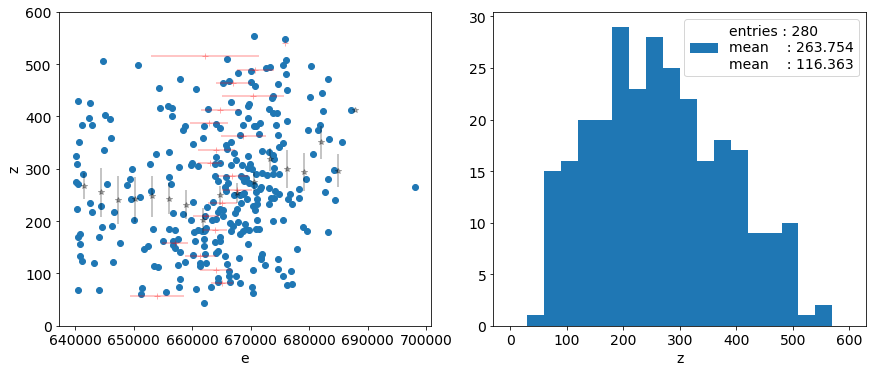

In [30]:
var_vs_var(esum, 'e', eax.range  , 'z', (0., 600), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'z', (0., 600), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'z', (0., 600), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'z', (0., 600), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


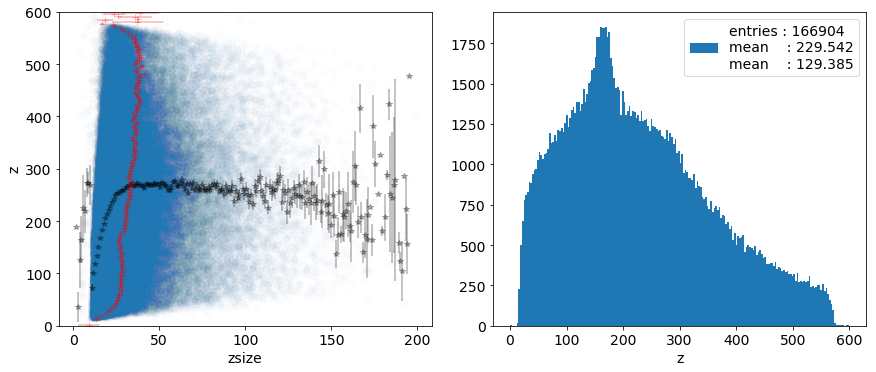

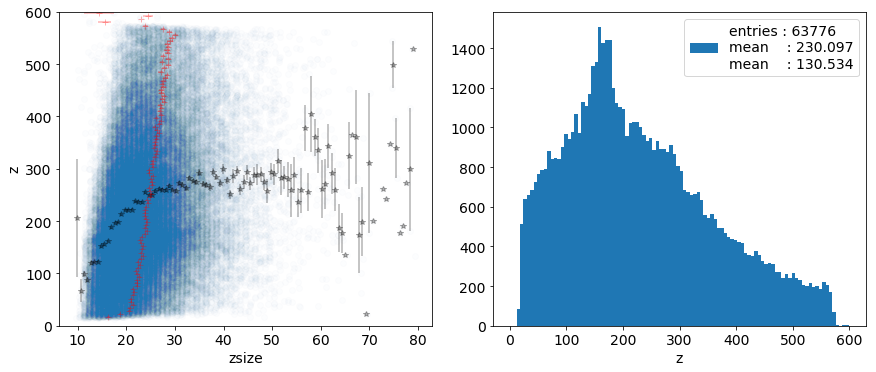

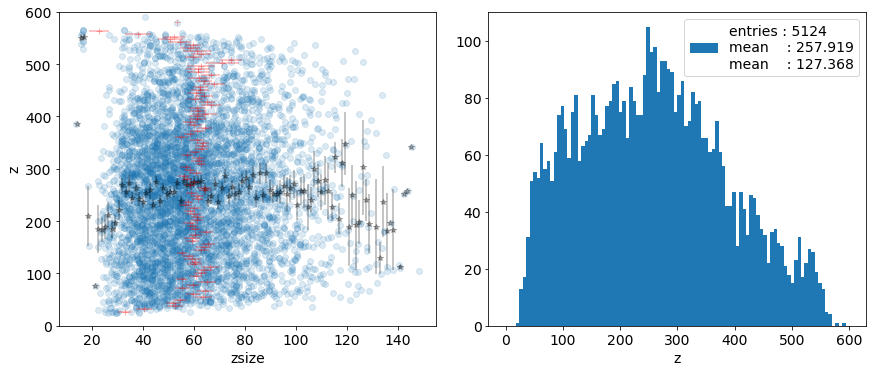

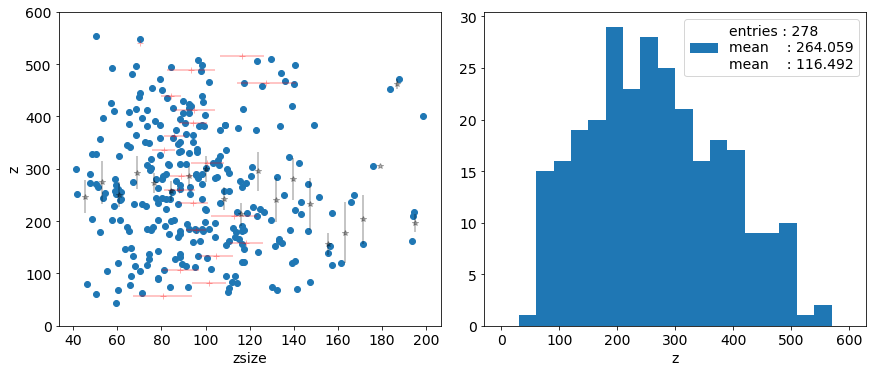

In [31]:
var_vs_var(esum, 'zsize', (0., 200), 'z', (0, 600), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'z', (0, 600), nbins = ecsax.nbins, sel = cssel, alpha = 0.01)
var_vs_var(esum, 'zsize', (0., 150), 'z', (0, 600), nbins = edsax.nbins, sel = dssel, alpha = 0.15)
var_vs_var(esum, 'zsize', (0., 200), 'z', (0, 600), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## Z1

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


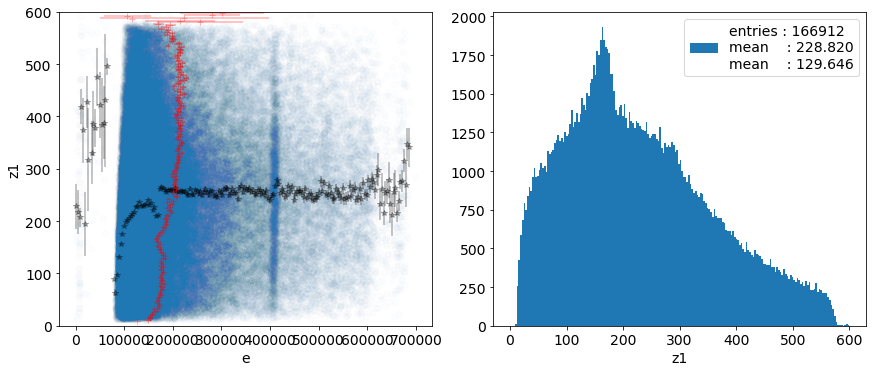

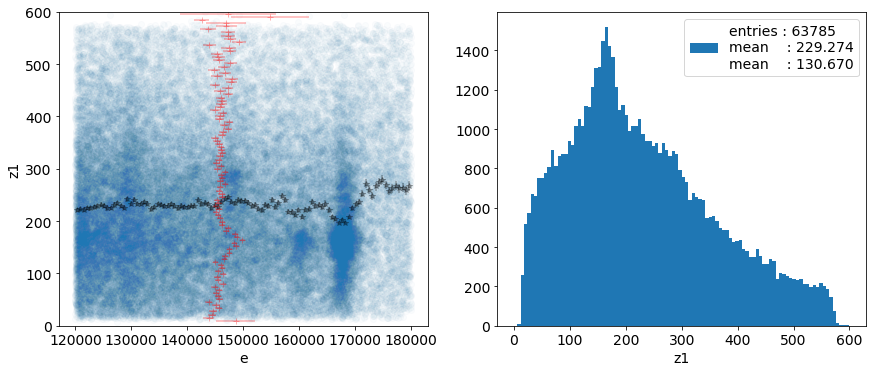

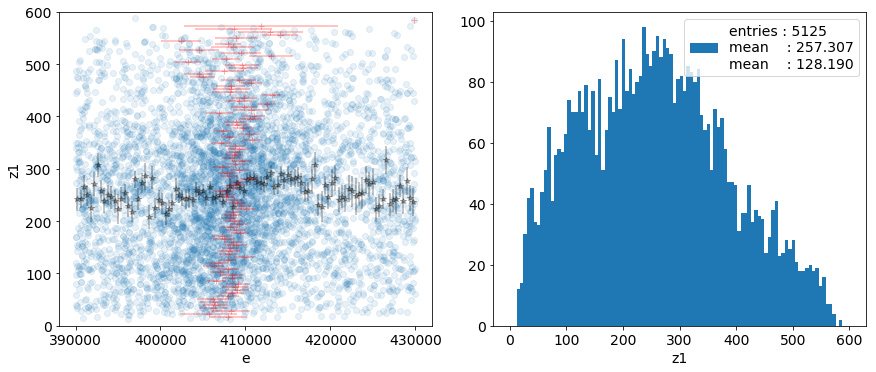

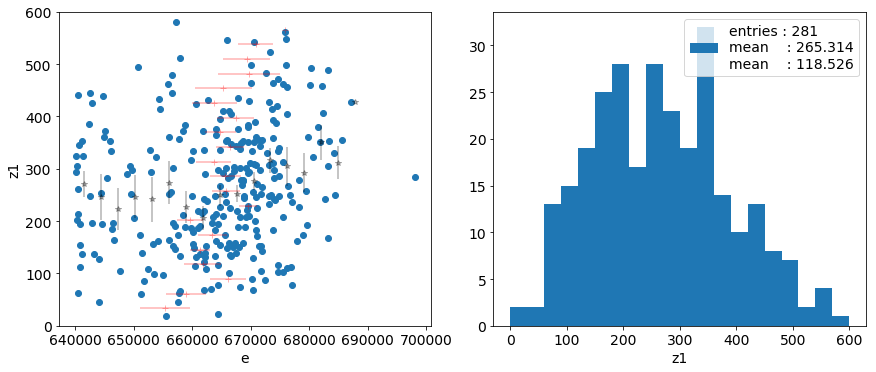

In [76]:
var_vs_var(esum, 'e', eax.range  , 'z1', (0., 600), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'z1', (0., 600), nbins = ecsax.nbins, alpha = 0.02)
var_vs_var(esum, 'e', edsax.range, 'z1', (0., 600), nbins = edsax.nbins, alpha = 0.1)
var_vs_var(esum, 'e', etlax.range, 'z1', (0., 600), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


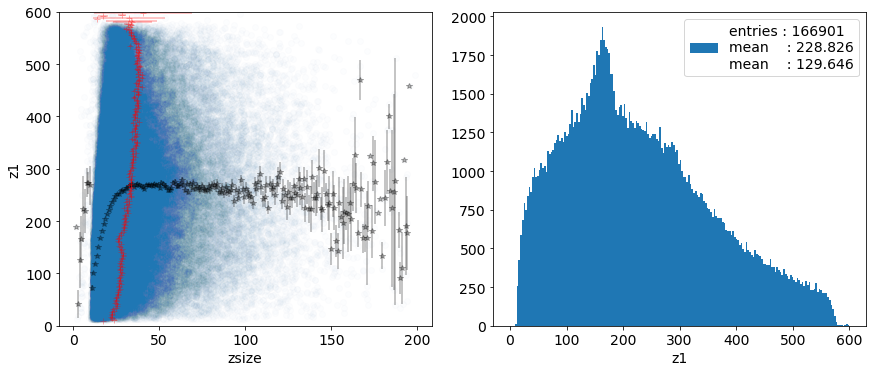

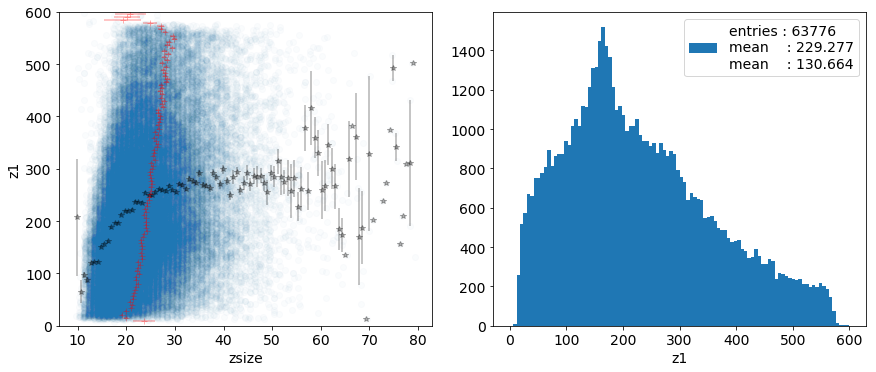

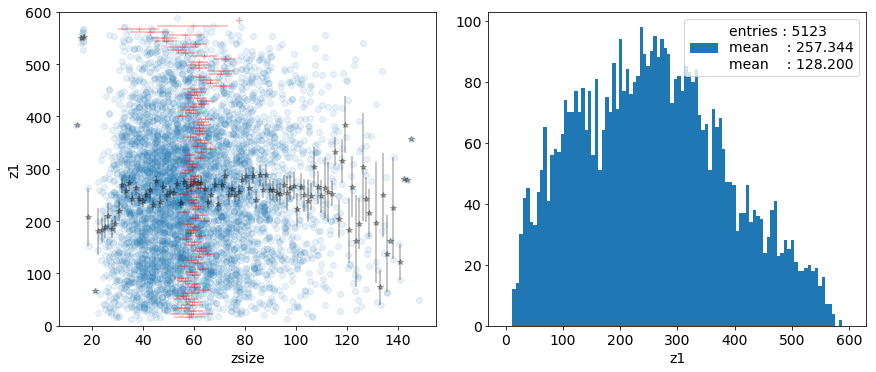

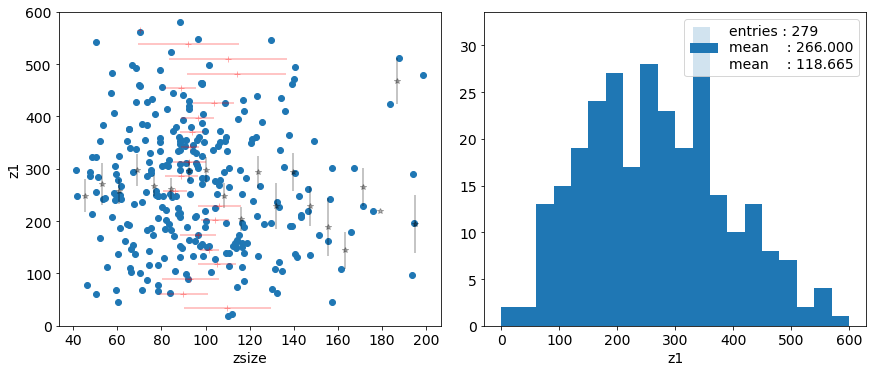

In [77]:
var_vs_var(esum, 'zsize', (0., 200), 'z1', (0, 600), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'z1', (0, 600), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'z1', (0, 600), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'z1', (0, 600), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## Z2

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


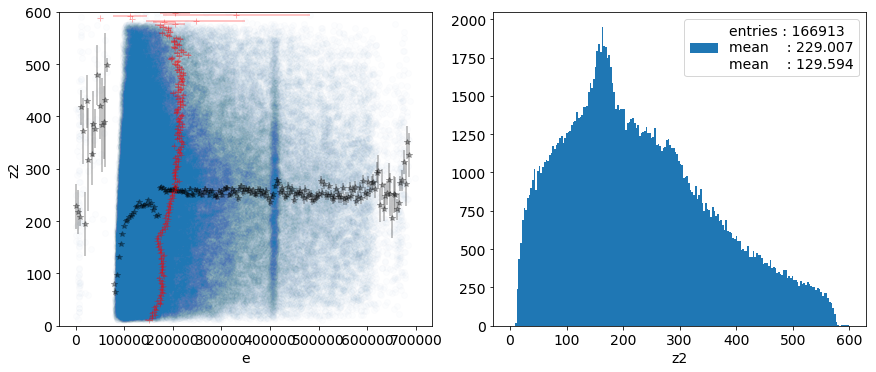

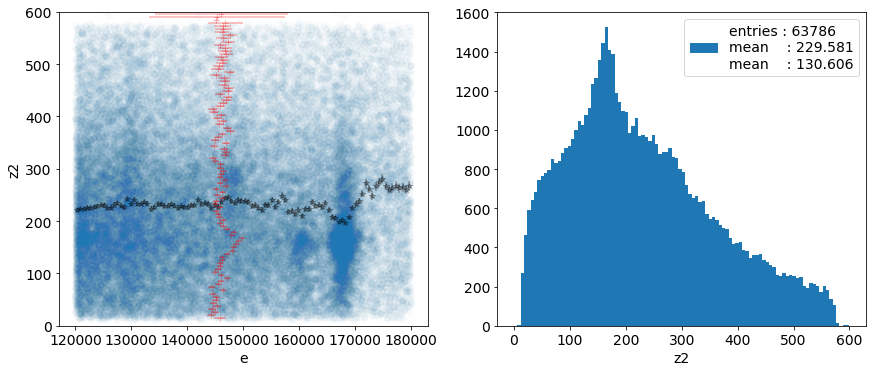

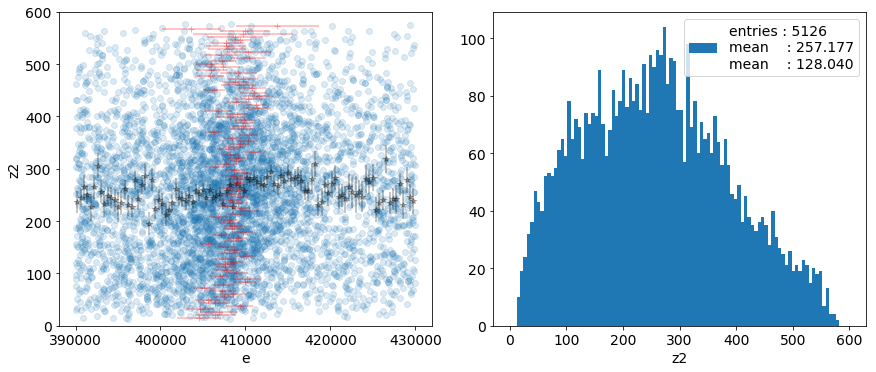

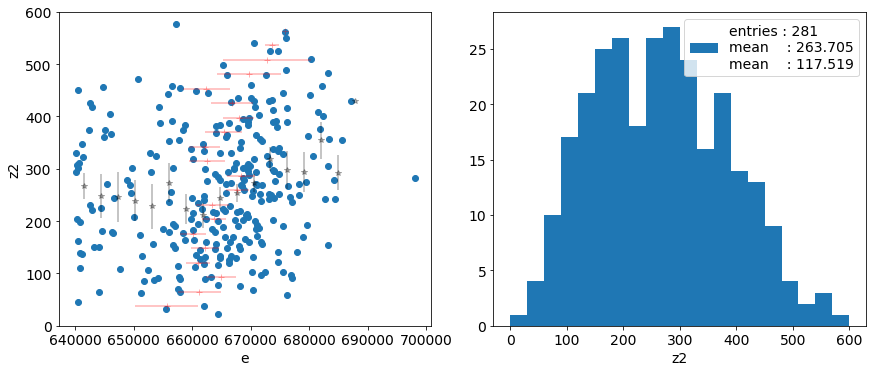

In [34]:
var_vs_var(esum, 'e', eax.range  , 'z2', (0., 600), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'z2', (0., 600), nbins = ecsax.nbins, alpha = 0.02)
var_vs_var(esum, 'e', edsax.range, 'z2', (0., 600), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'z2', (0., 600), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


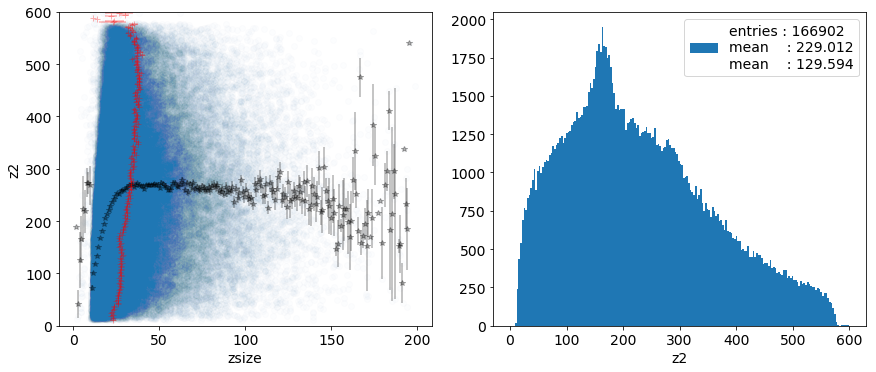

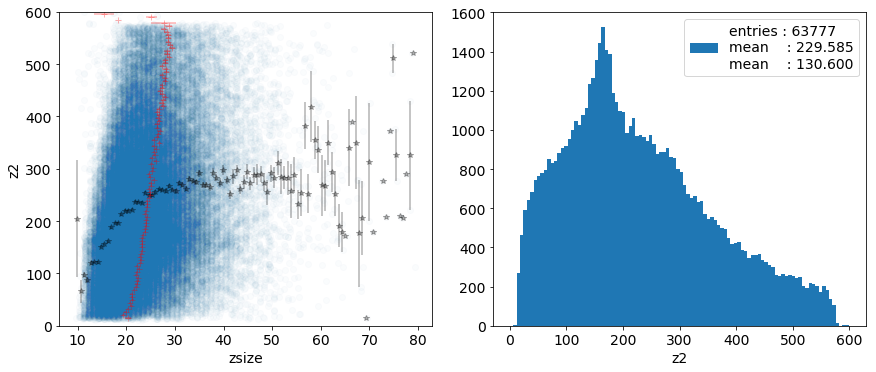

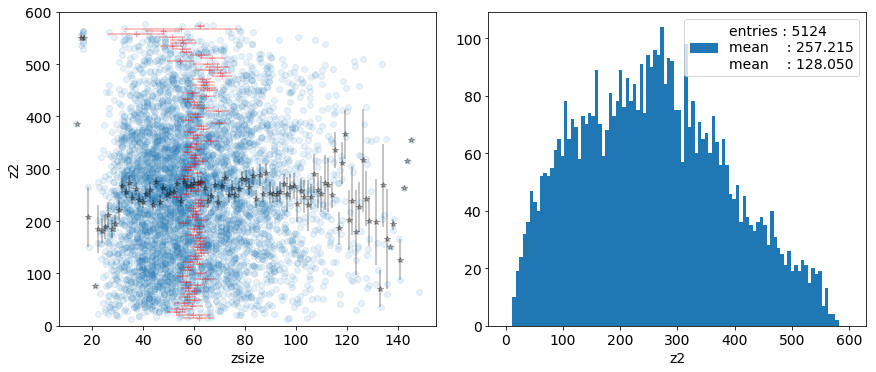

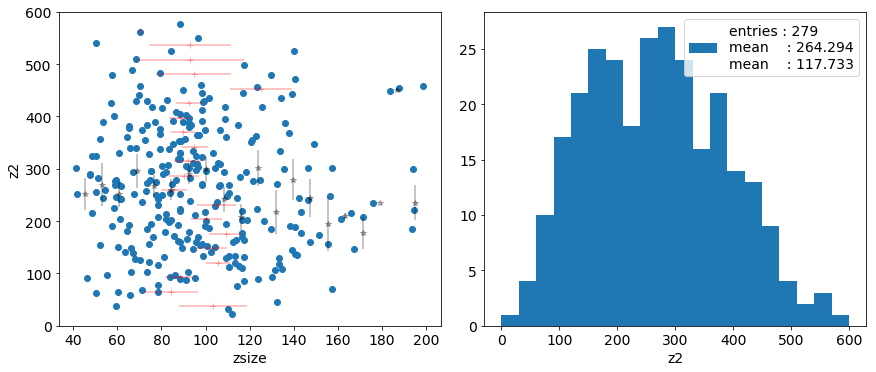

In [35]:
var_vs_var(esum, 'zsize', (0., 200), 'z2', (0, 600), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'z2', (0, 600), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'z2', (0, 600), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'z2', (0, 600), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## t0

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


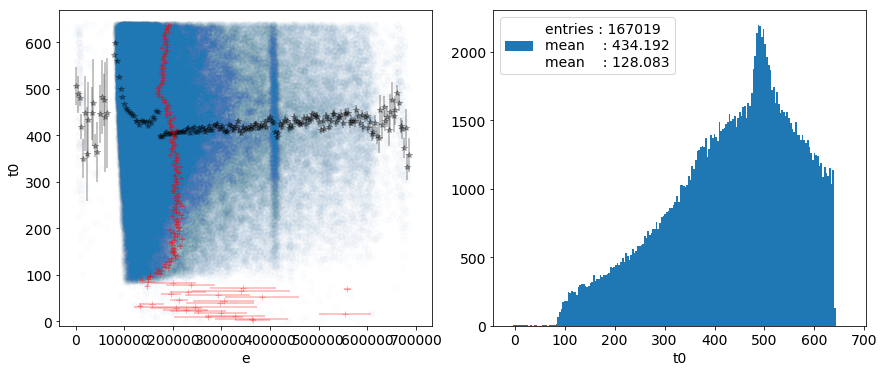

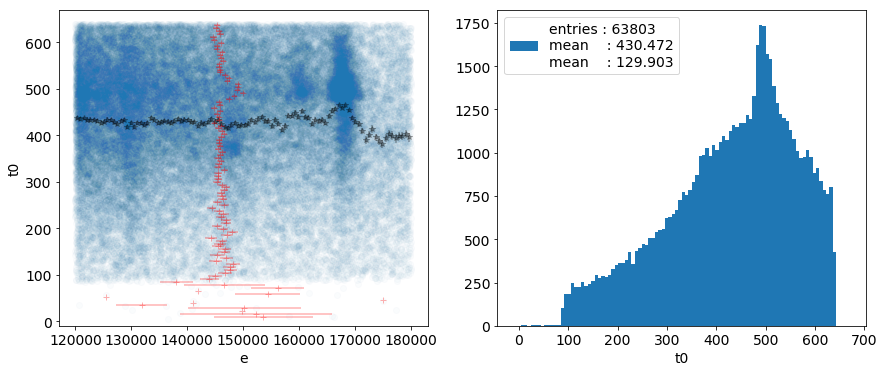

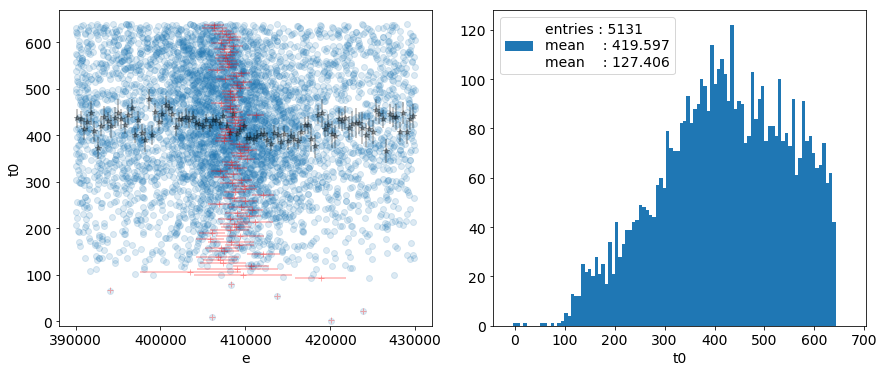

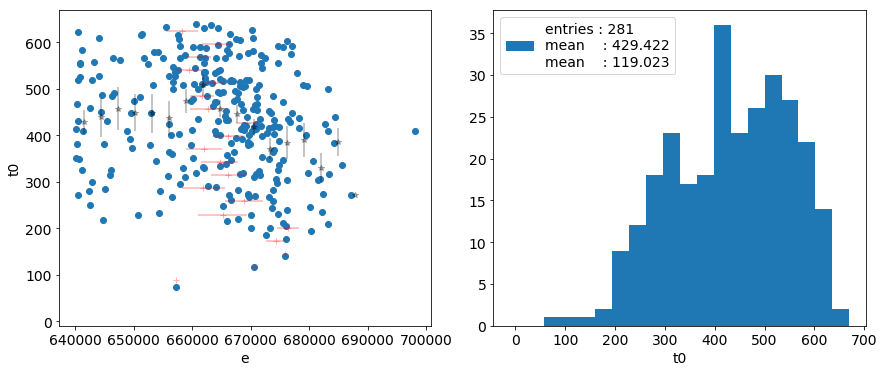

In [36]:
var_vs_var(esum, 'e', eax.range  , 't0', (-10., 670), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 't0', (-10., 670), nbins = ecsax.nbins, alpha = 0.02)
var_vs_var(esum, 'e', edsax.range, 't0', (-10., 670), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 't0', (-10., 670), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


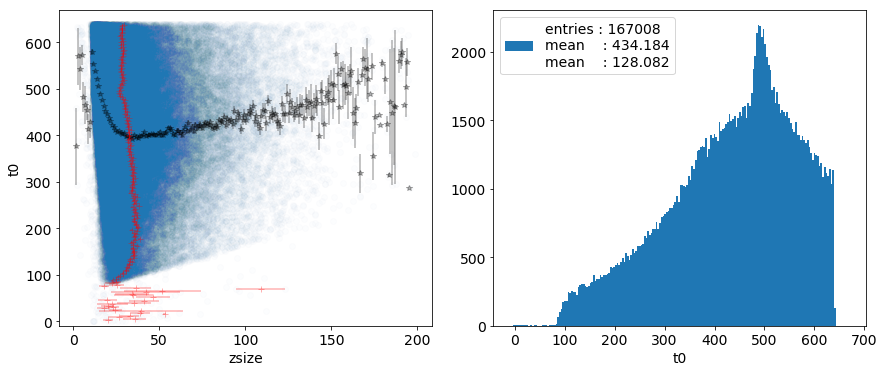

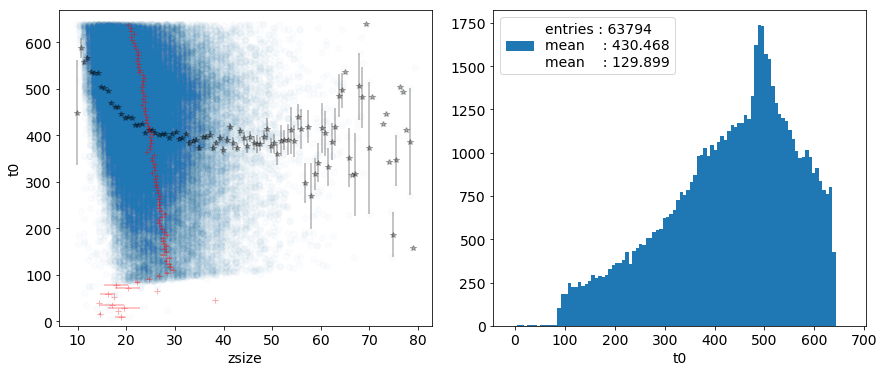

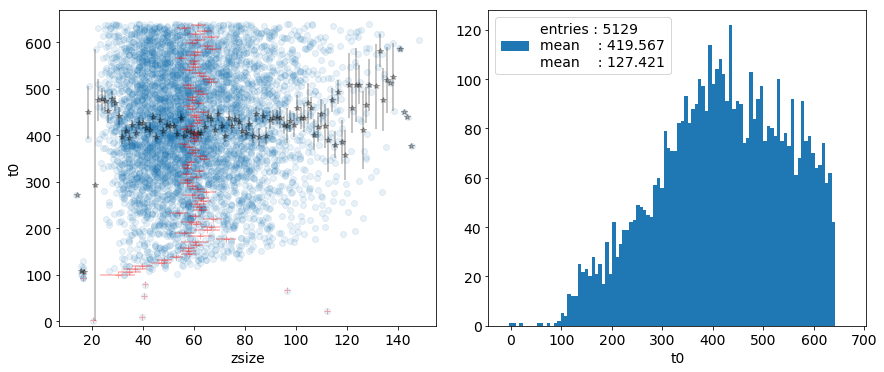

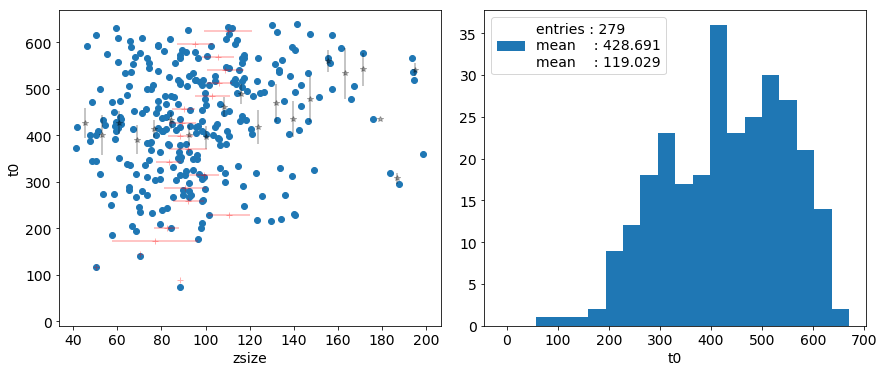

In [37]:
var_vs_var(esum, 'zsize', (0., 200), 't0', (-10, 670), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 't0', (-10, 670), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 't0', (-10, 670), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 't0', (-10, 670), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## S1

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


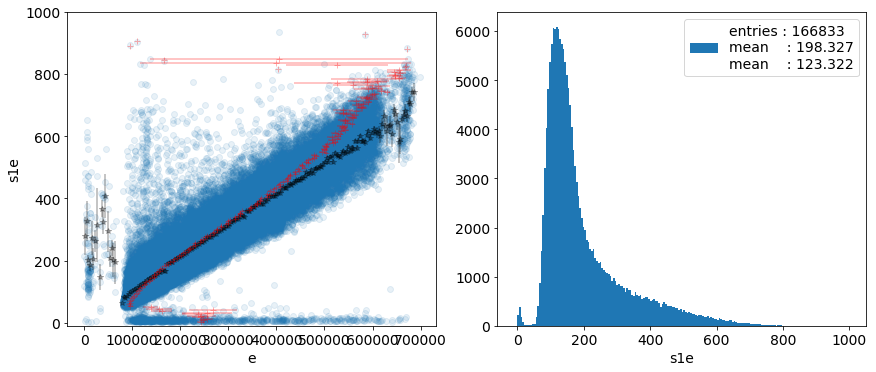

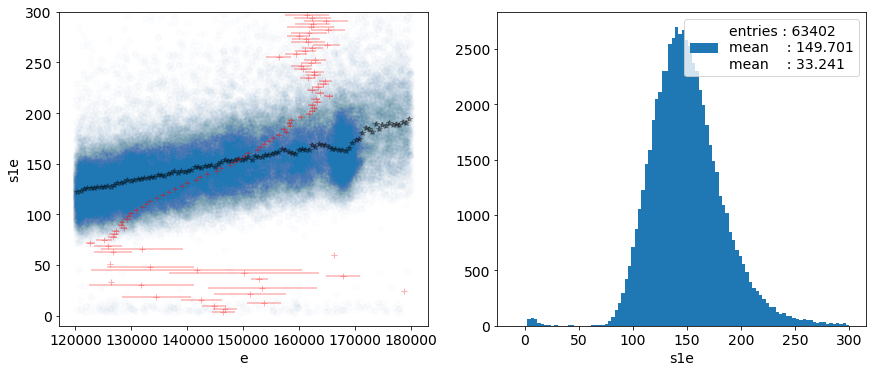

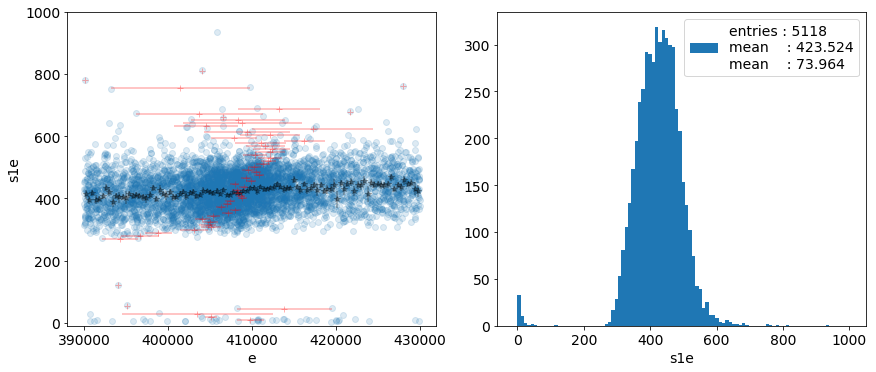

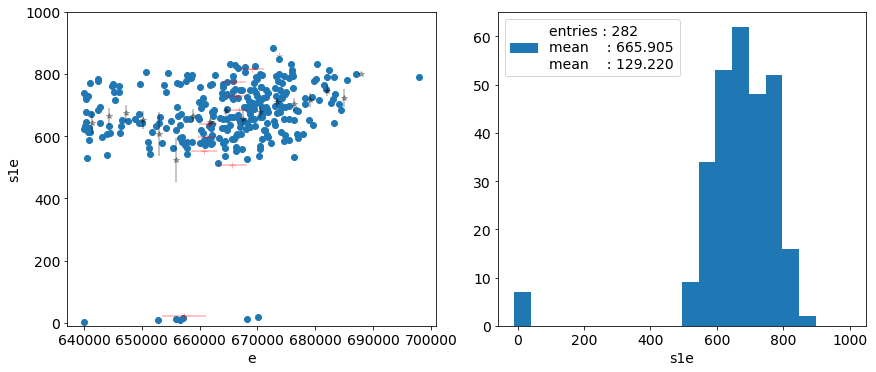

In [82]:
var_vs_var(esum, 'e', eax.range  , 's1e', (-10., 1e3), nbins = eax.nbins  , alpha = 0.1)
var_vs_var(esum, 'e', ecsax.range, 's1e', (-10., 3e2), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 's1e', (-10., 1e3), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 's1e', (-10., 1e3), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


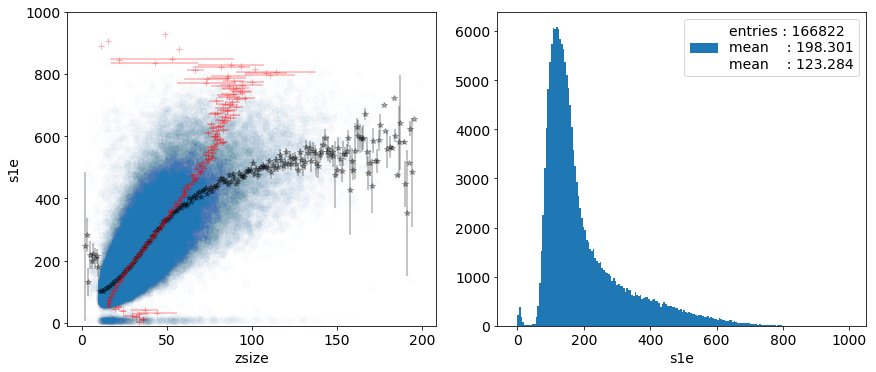

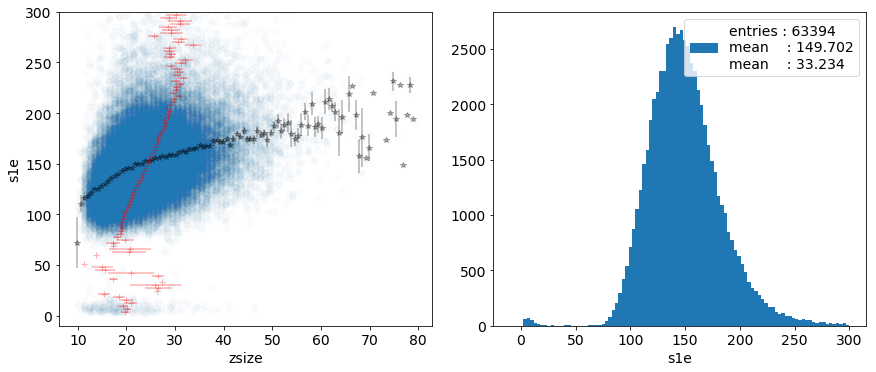

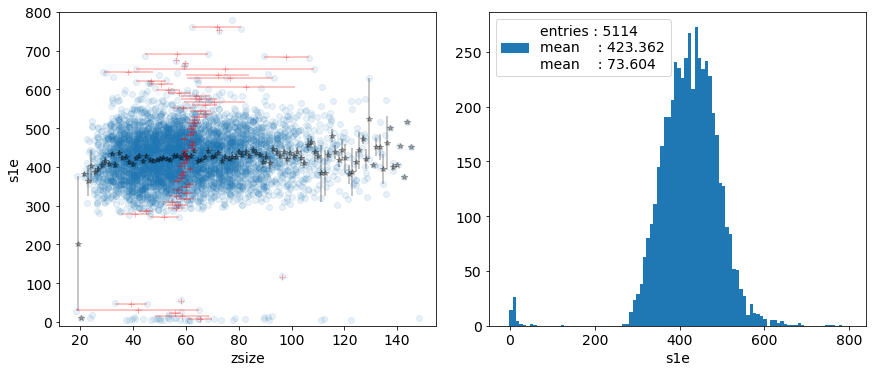

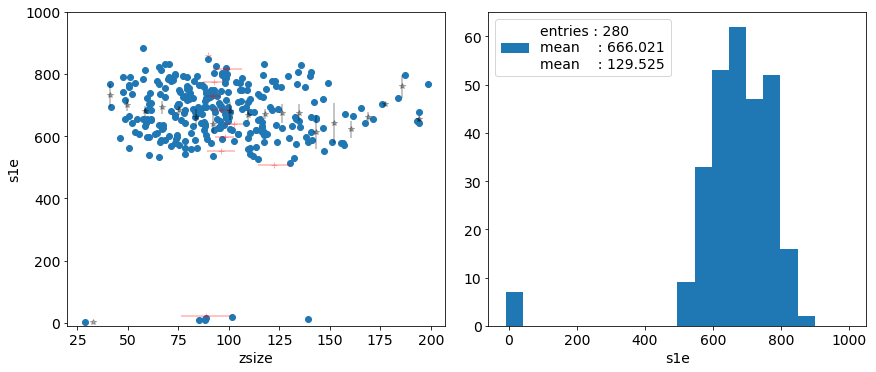

In [39]:
var_vs_var(esum, 'zsize', (0., 200), 's1e', (-10, 1000), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 's1e', (-10,  300), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 's1e', (-10,  800), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 's1e', (-10, 1000), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## time

In [40]:
esum['t'] = (esum.time - esum.time.min())/3600000.

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


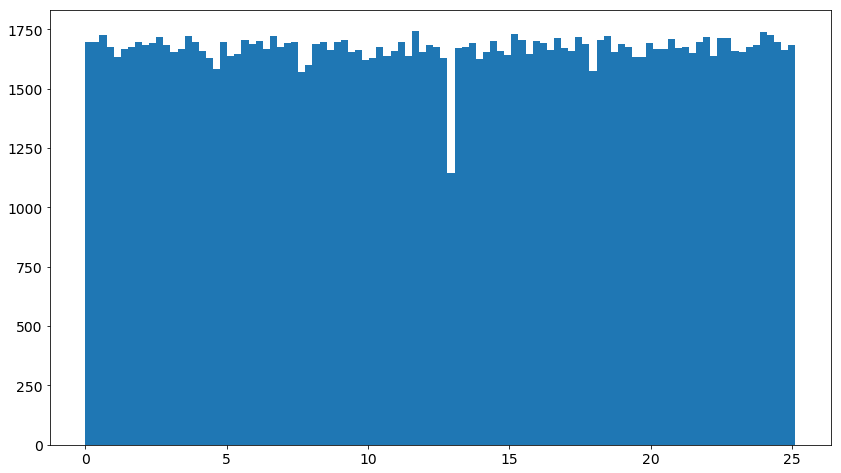

In [41]:
plt.hist(esum.t, 100);

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


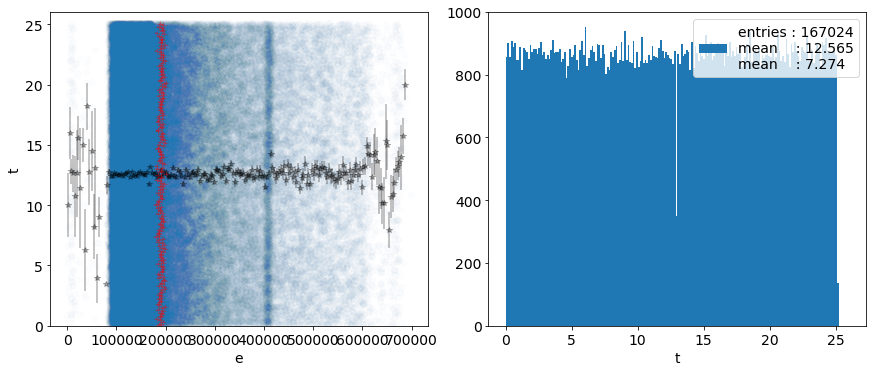

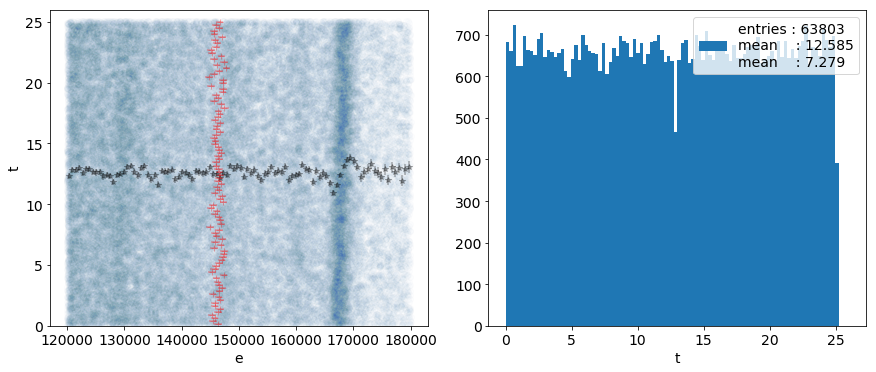

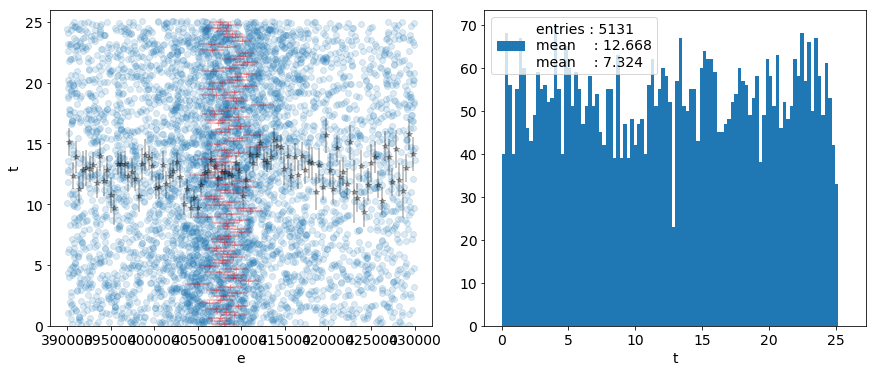

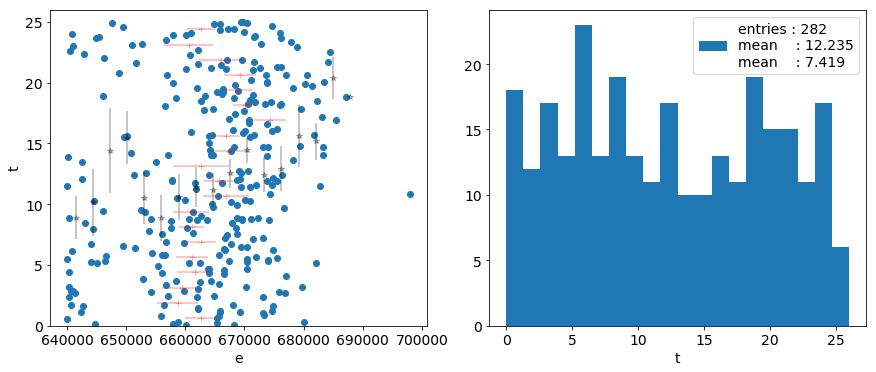

In [42]:
var_vs_var(esum, 'e', eax.range  , 't', (0., 26.), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 't', (0., 26.), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 't', (0., 26.), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 't', (0., 26), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


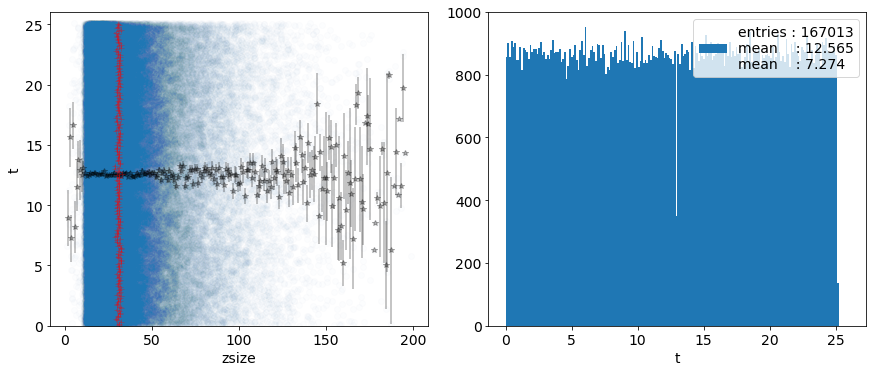

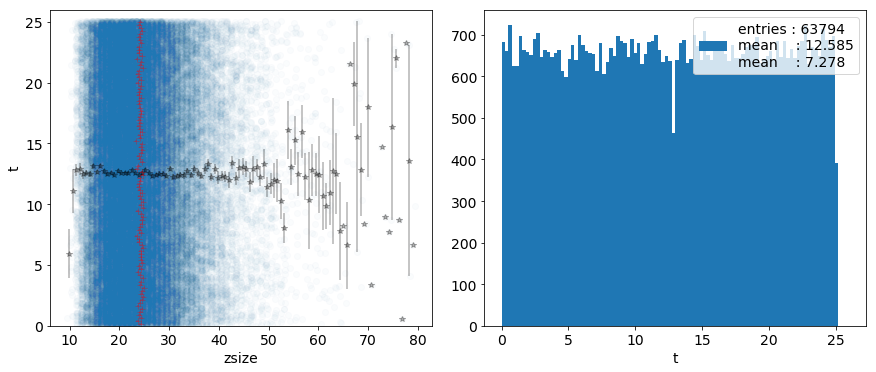

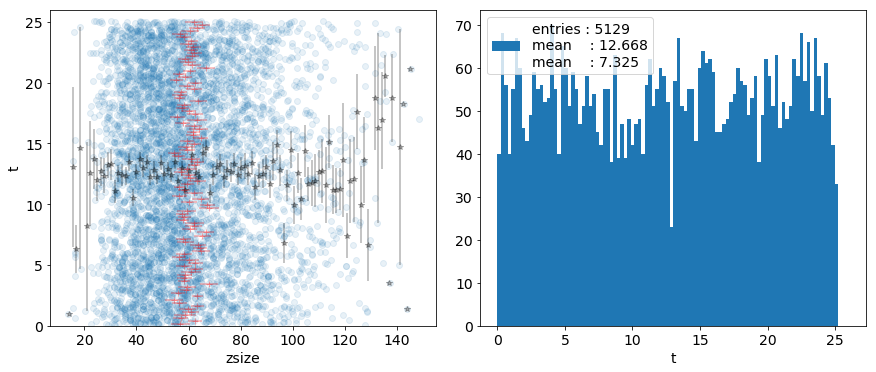

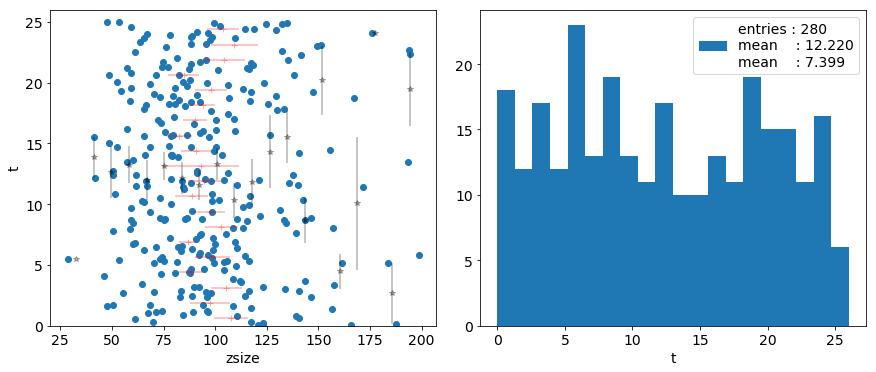

In [43]:
var_vs_var(esum, 'zsize', (0., 200), 't', (0, 26), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 't', (0, 26), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 't', (0, 26), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 't', (0, 26), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## x

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


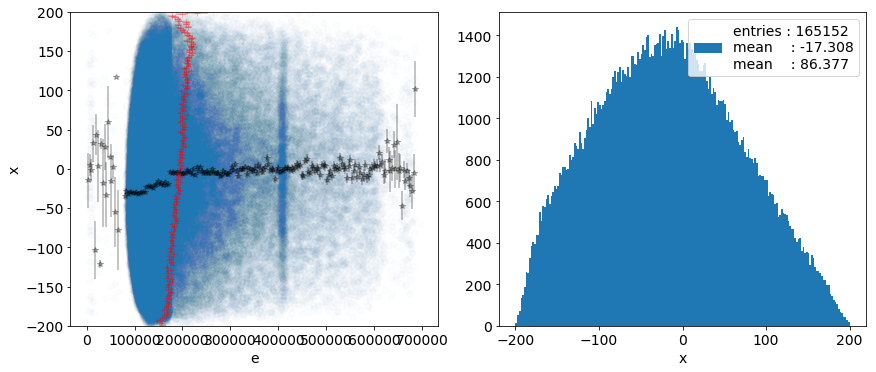

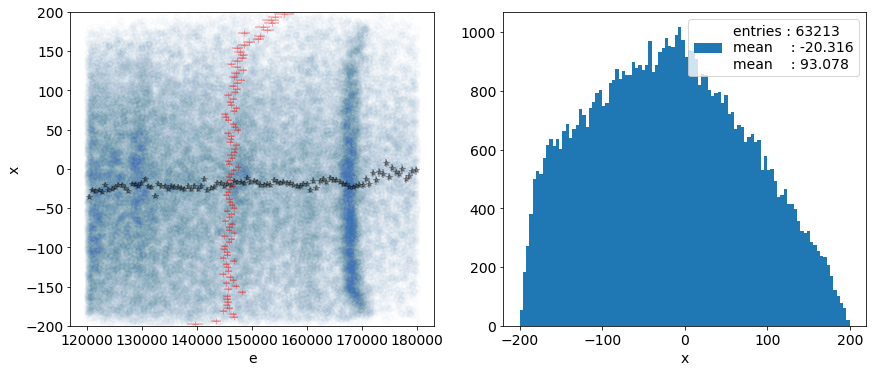

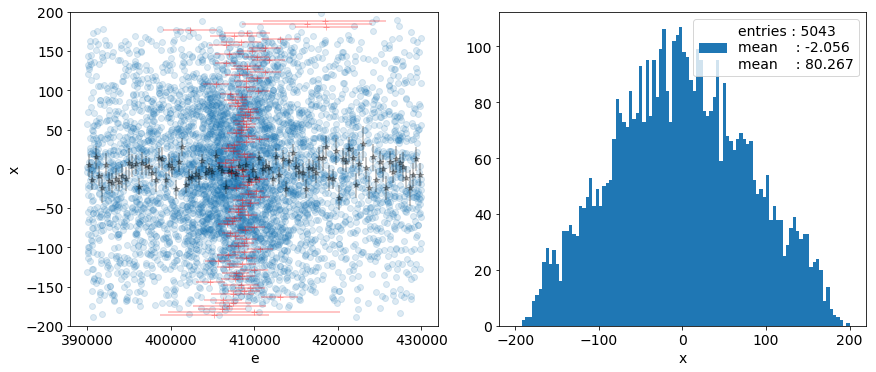

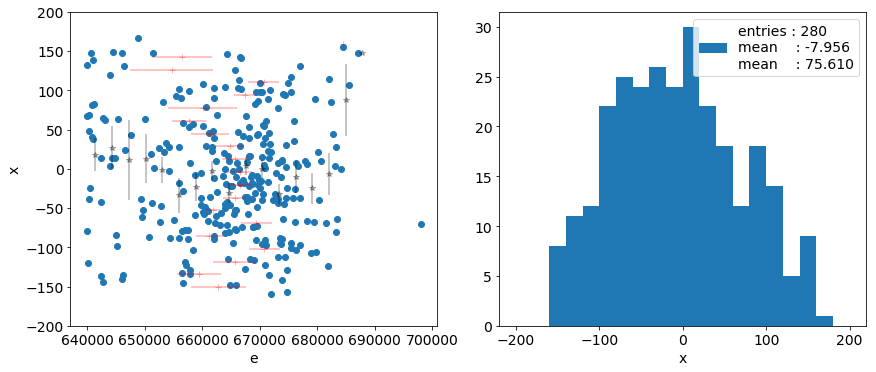

In [44]:
var_vs_var(esum, 'e', eax.range  , 'x', (-200., 200.), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'x', (-200., 200.), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'x', (-200., 200.), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'x', (-200., 200.), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


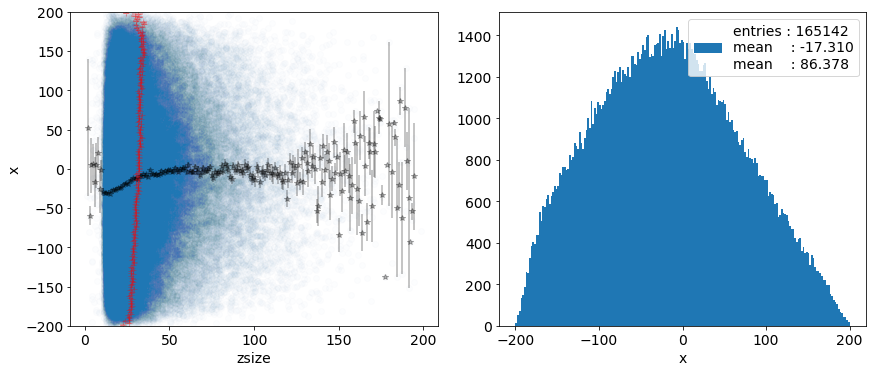

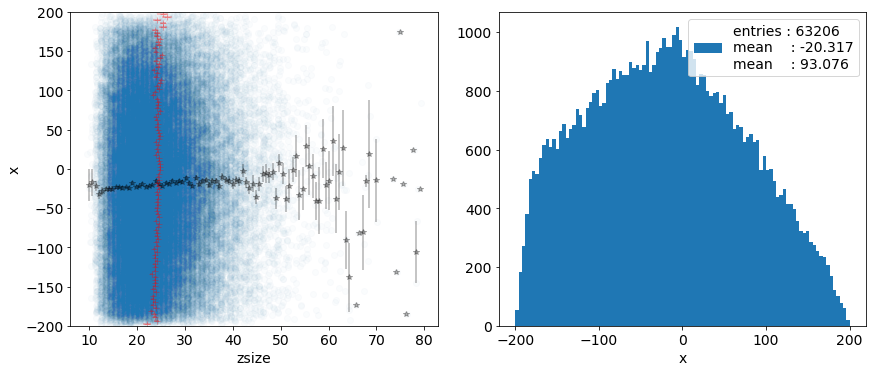

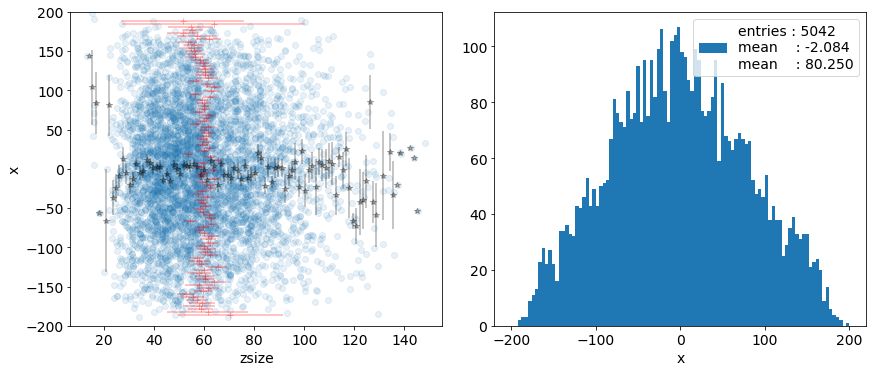

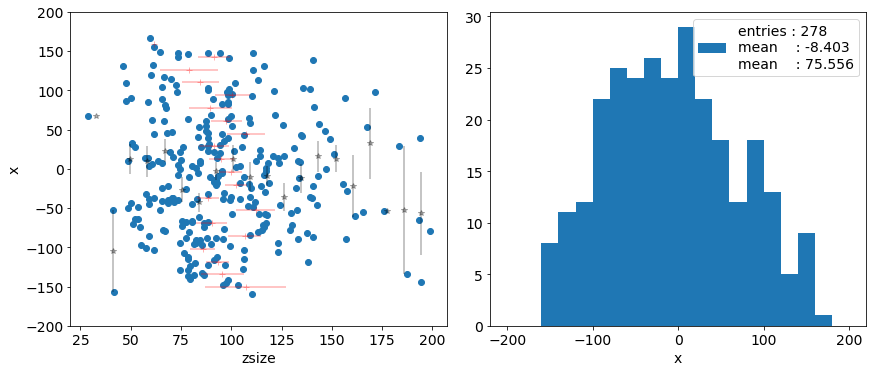

In [45]:
var_vs_var(esum, 'zsize', (0., 200), 'x', (-200, 200), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'x', (-200, 200), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'x', (-200, 200), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'x', (-200, 200), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## y 

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


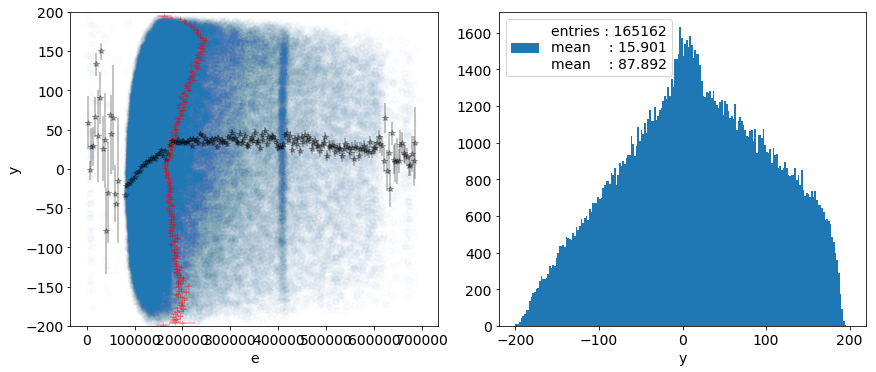

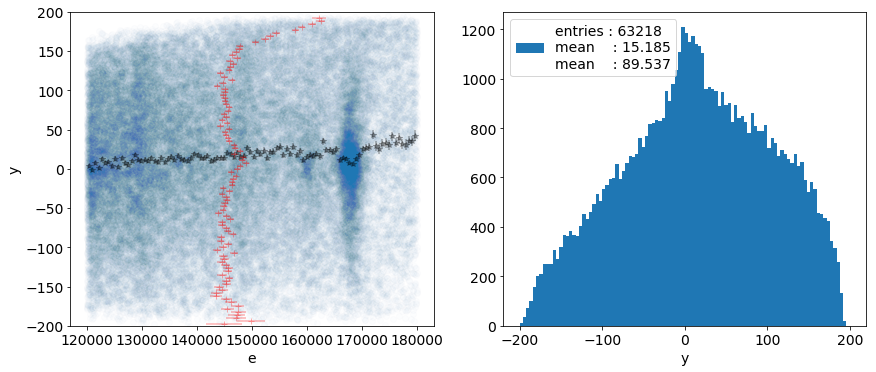

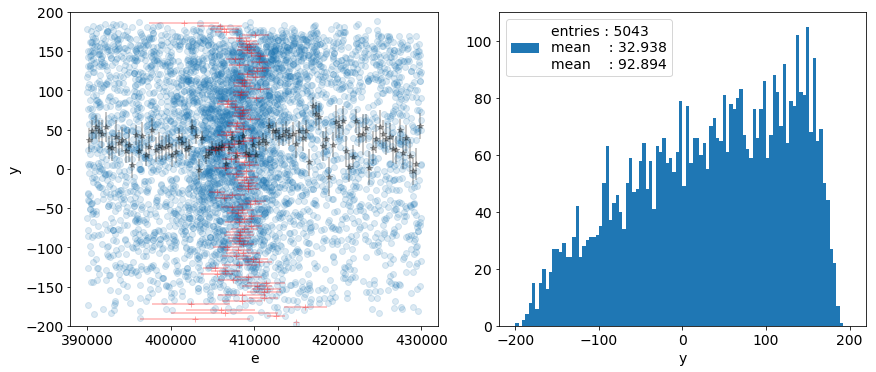

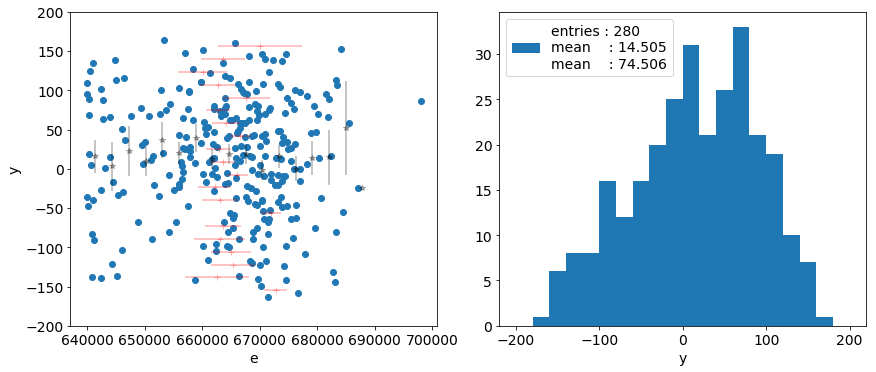

In [46]:
var_vs_var(esum, 'e', eax.range  , 'y', (-200., 200.), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'y', (-200., 200.), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'y', (-200., 200.), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'y', (-200., 200.), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


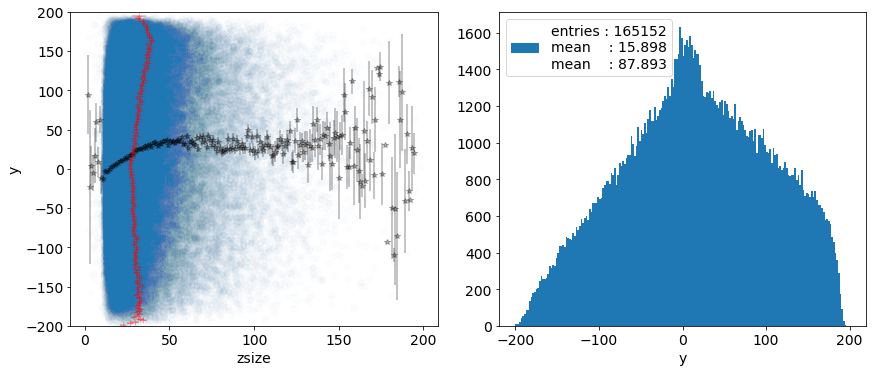

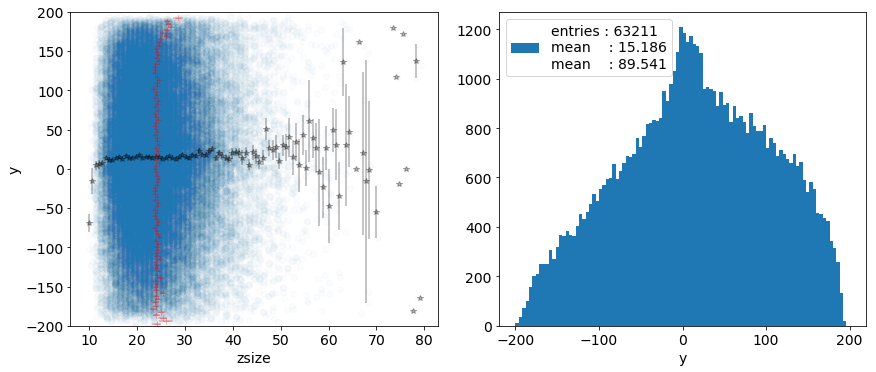

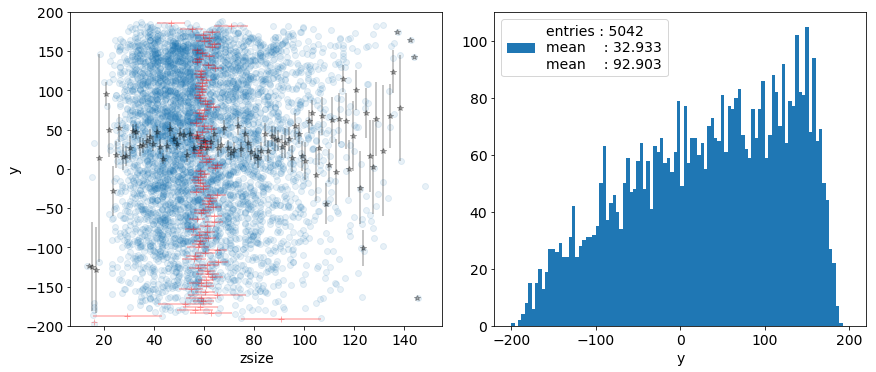

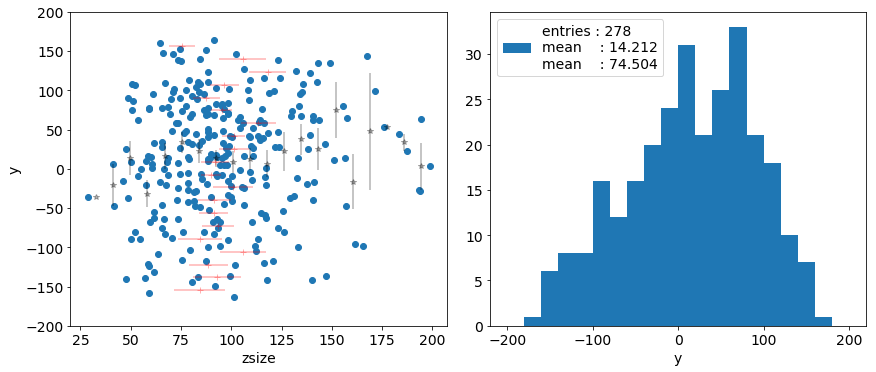

In [47]:
var_vs_var(esum, 'zsize', (0., 200), 'y', (-200, 200), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'y', (-200, 200), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'y', (-200, 200), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'y', (-200, 200), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## R

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


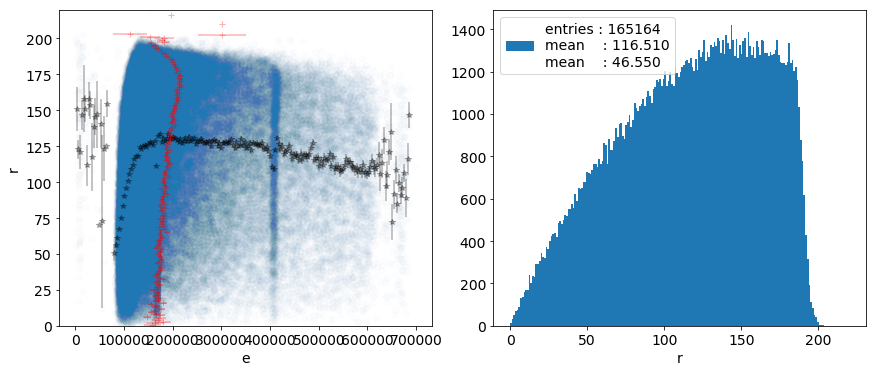

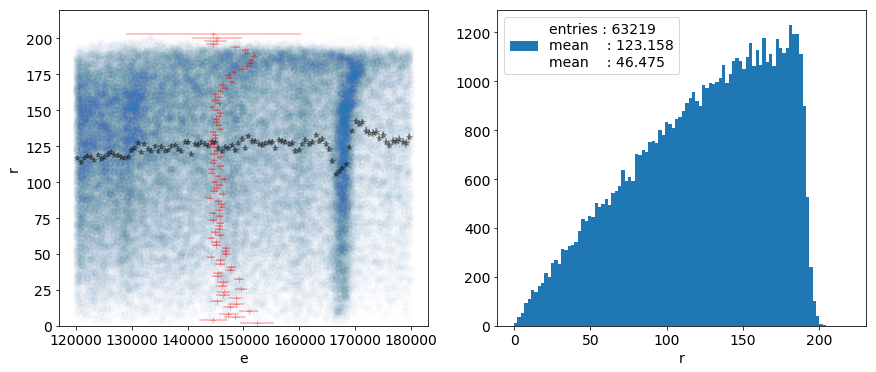

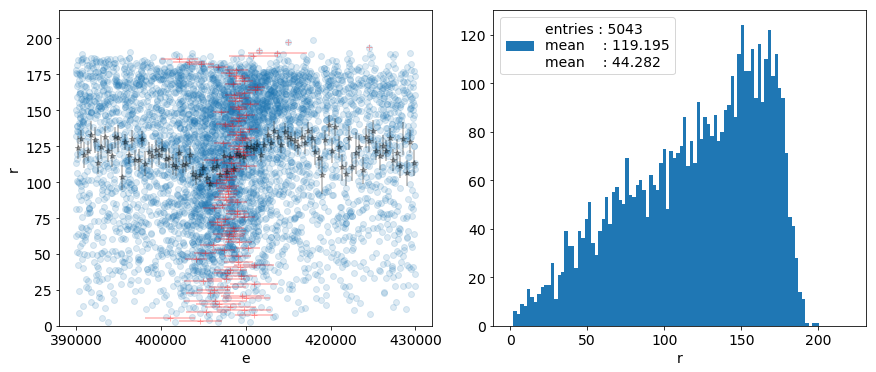

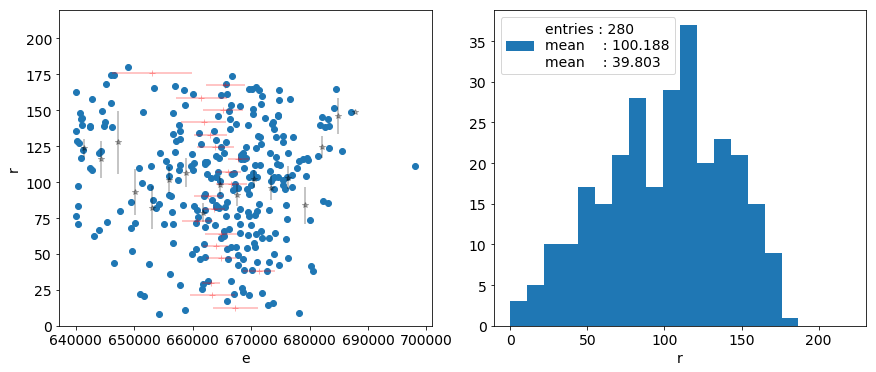

In [48]:
var_vs_var(esum, 'e', eax.range  , 'r', (0., 220.), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'r', (0., 220.), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'r', (0., 220.), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'r', (0., 220.), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


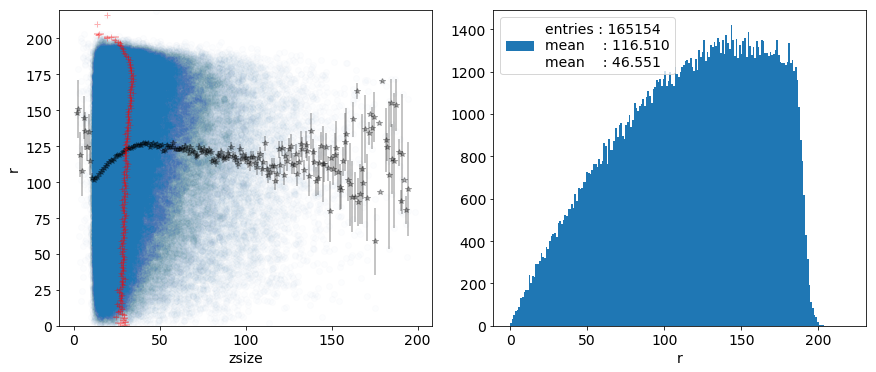

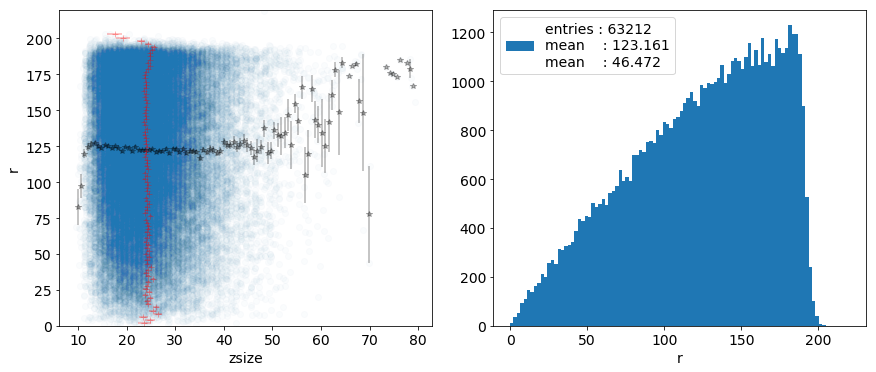

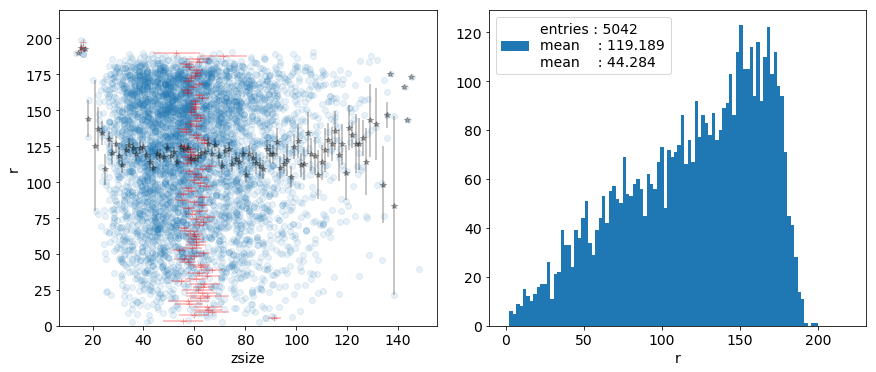

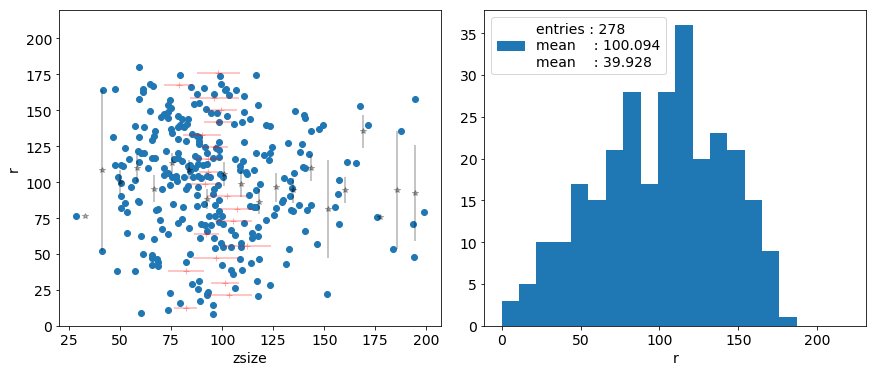

In [49]:
var_vs_var(esum, 'zsize', (0., 200), 'r', (0, 220), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'r', (0, 220), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'r', (0, 220), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'r', (0, 220), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## q

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


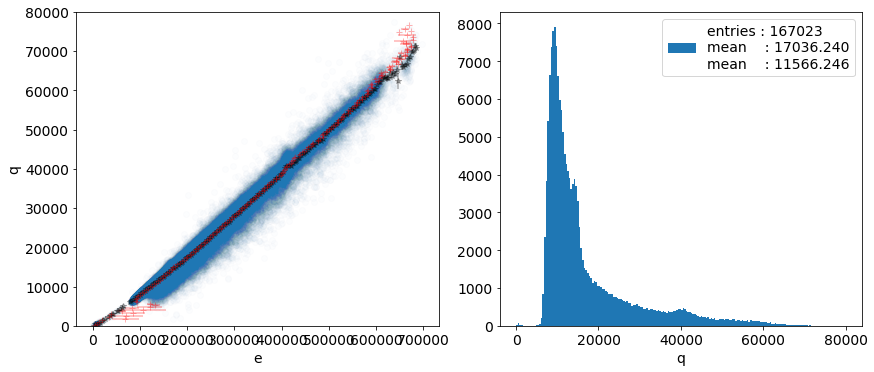

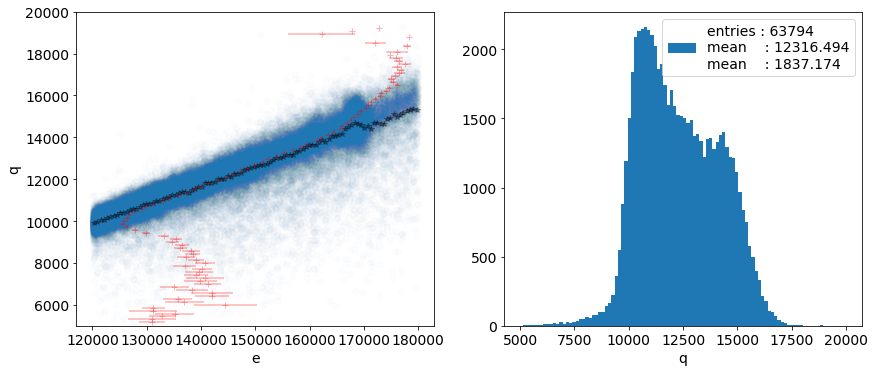

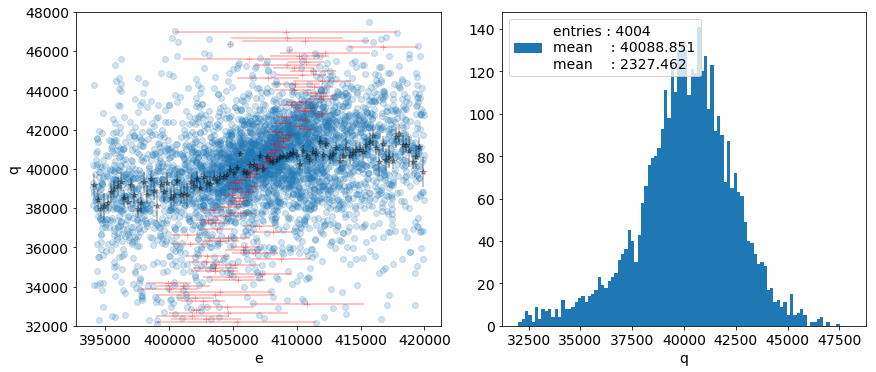

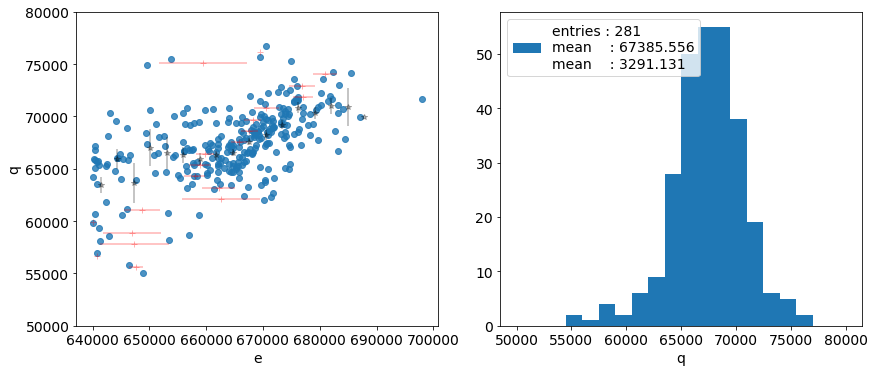

In [90]:
var_vs_var(esum, 'e', eax.range  , 'q', ( 0e3,  80e3), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'q', ( 5e3,  20e3), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', (394e3, 420e3), 'q', (32e3,  48e3), nbins = edsax.nbins, alpha = 0.2)
var_vs_var(esum, 'e', etlax.range, 'q', (50e3,  80e3), nbins = etlax.nbins, alpha = 0.8)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


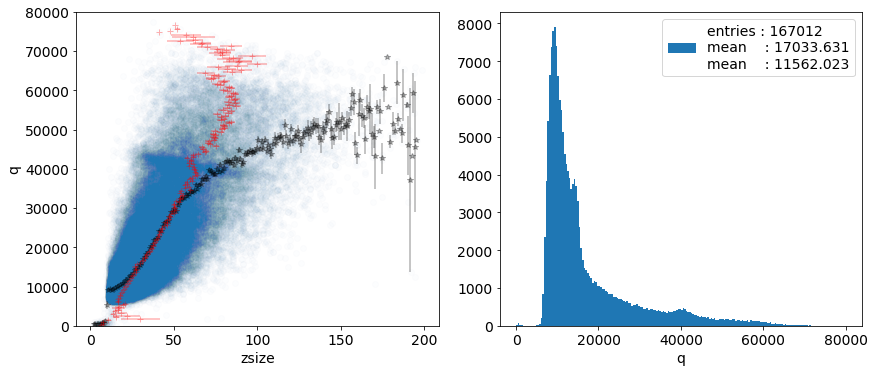

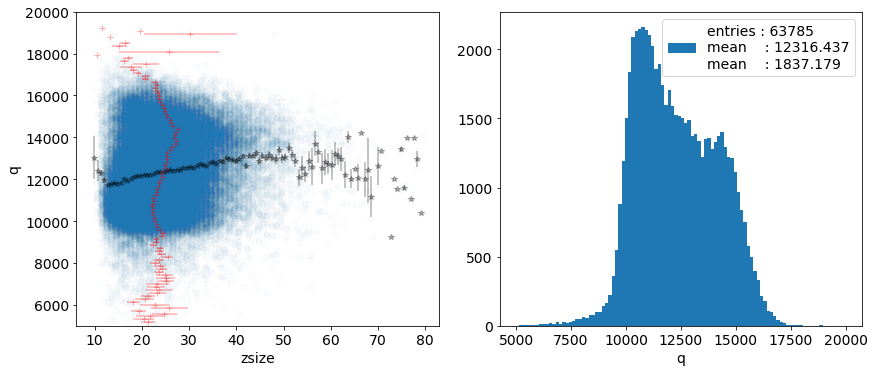

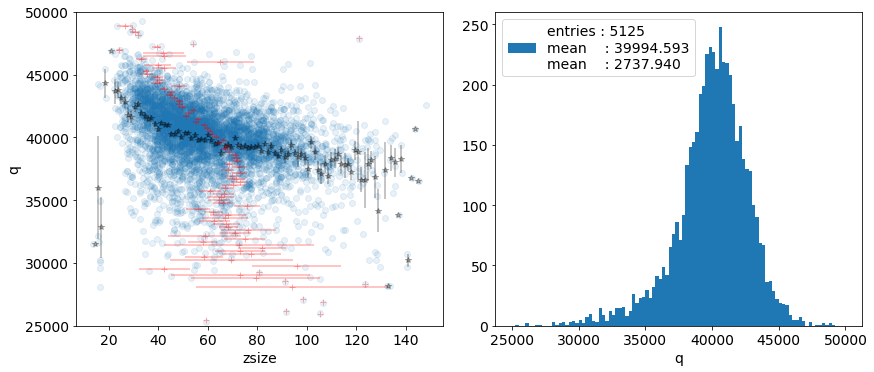

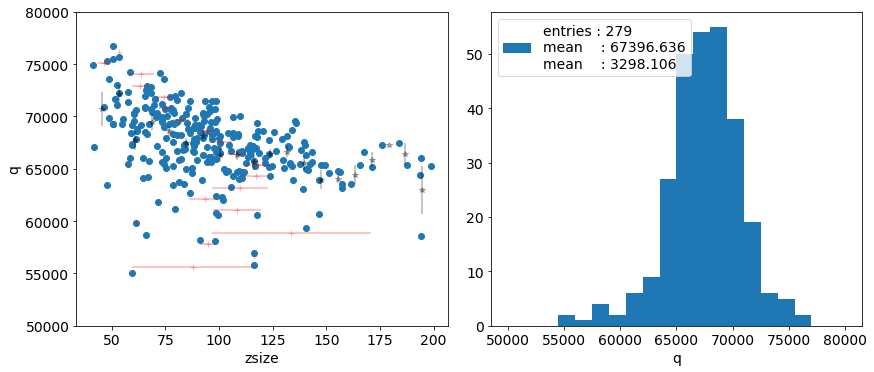

In [91]:
var_vs_var(esum, 'zsize', (0., 200), 'q', (   0, 80e3), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'q', ( 5e3, 20e3), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'q', (25e3, 50e3), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'q', (50e3, 80e3), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## eh

In [52]:
esum['eq'] = esum.e/esum.q

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


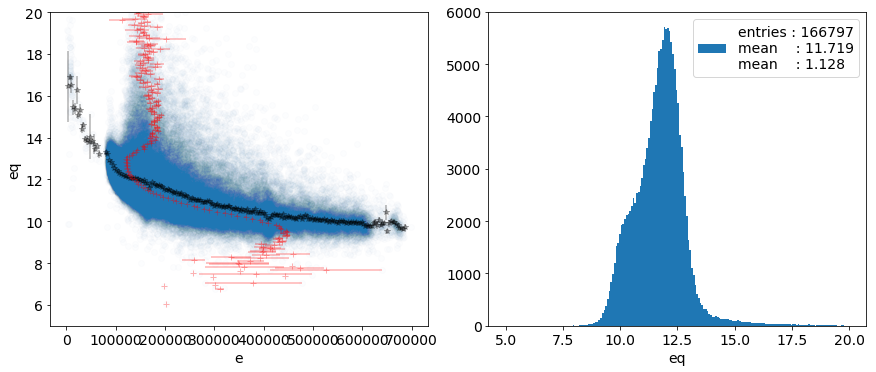

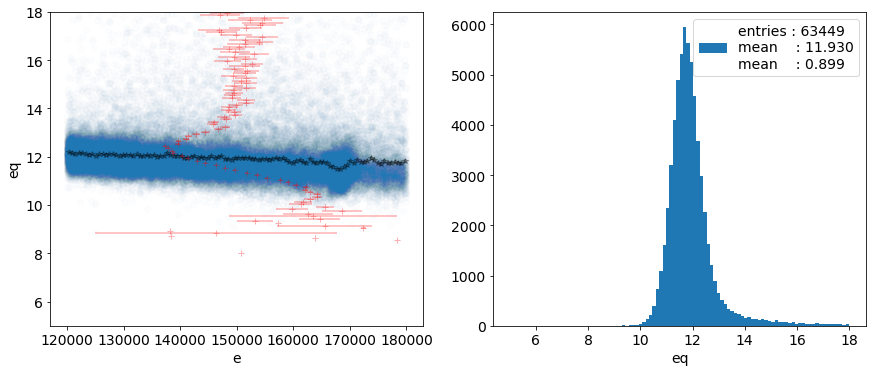

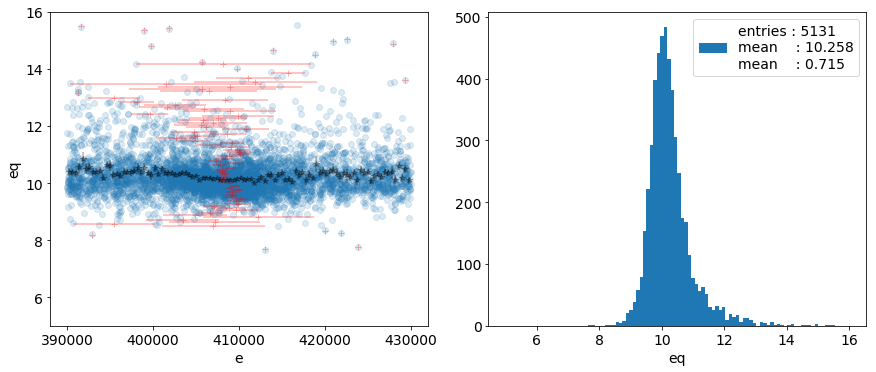

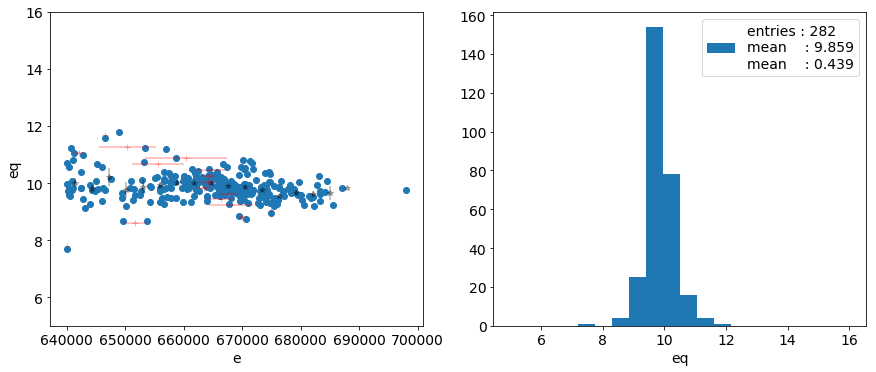

In [53]:
var_vs_var(esum, 'e', eax.range  , 'eq', ( 5,  20), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'eq', ( 5,  18), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'eq', ( 5,  16), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'eq', ( 5,  16), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


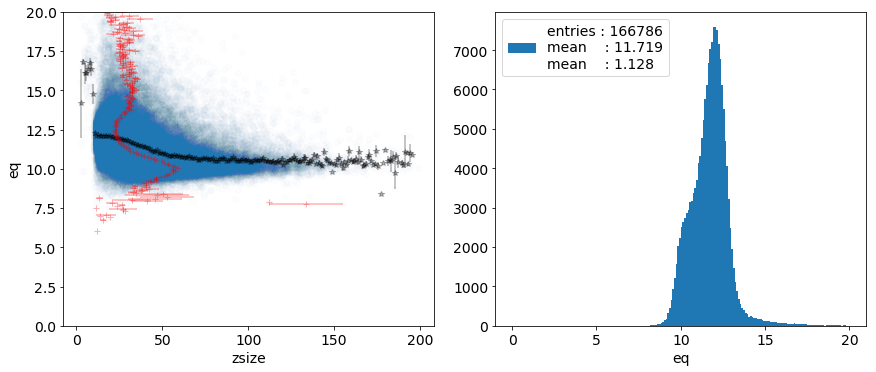

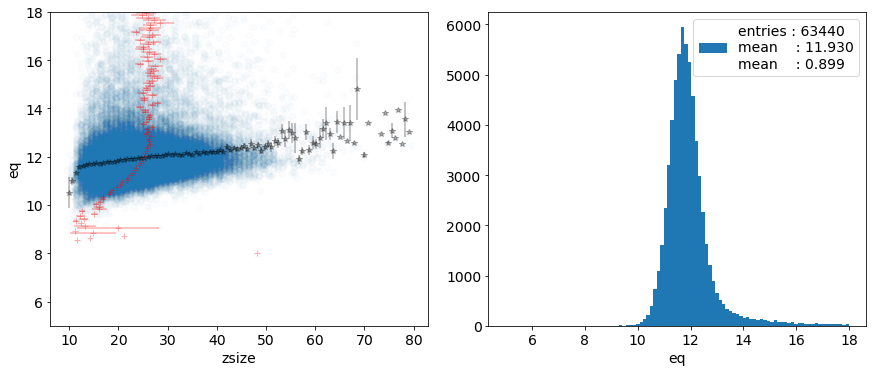

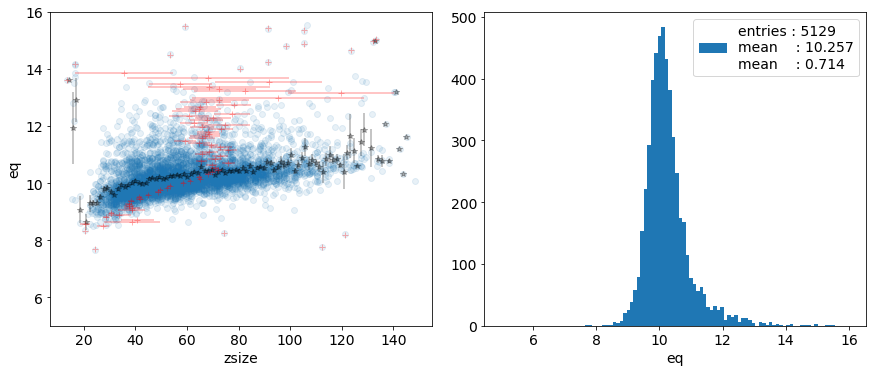

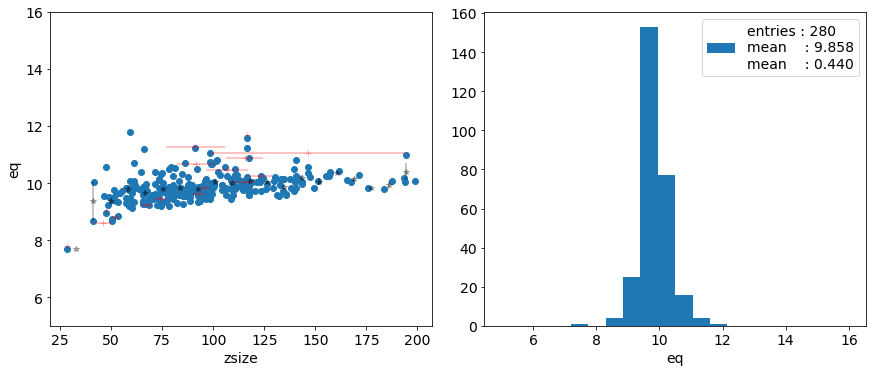

In [54]:
var_vs_var(esum, 'zsize', (0., 200), 'eq', ( 0, 20), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'eq', ( 5, 18), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'eq', ( 5, 16), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'eq', ( 5, 16), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## For-back

In [55]:
esum['afb'] = (esum.ef - esum.eb)/(esum.ef + esum.eb)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


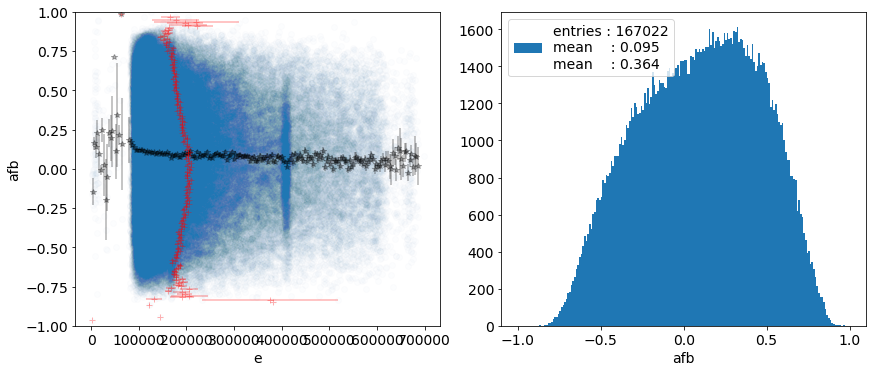

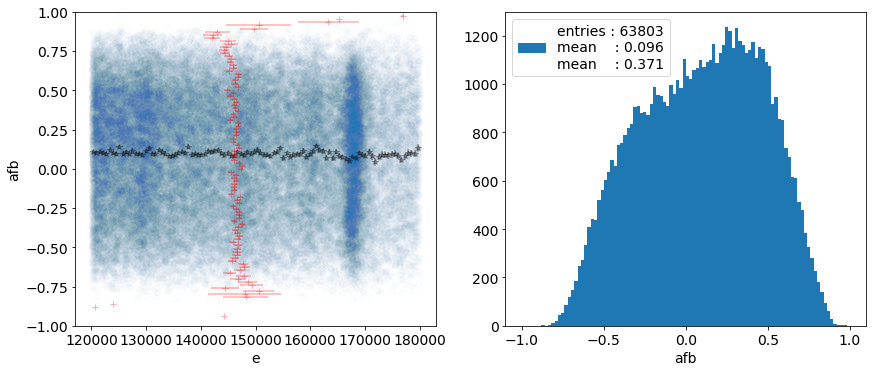

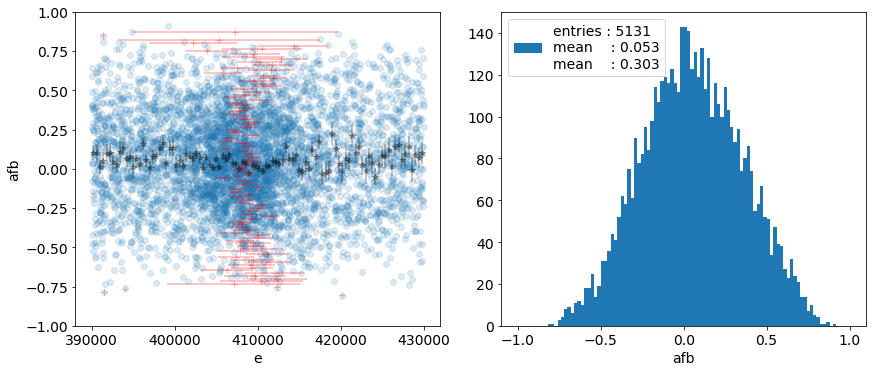

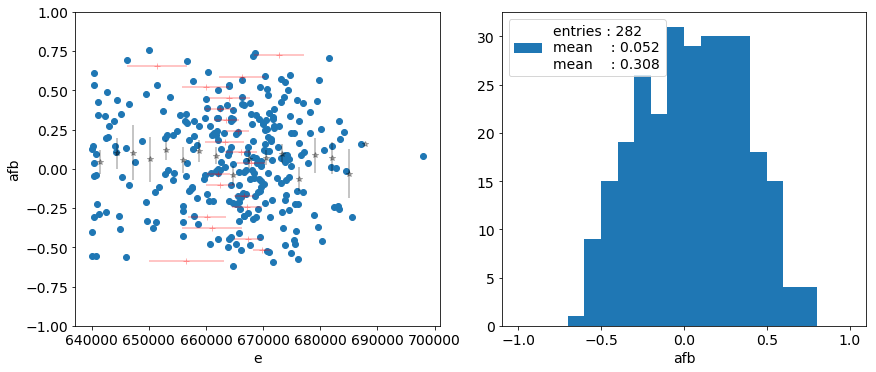

In [56]:
var_vs_var(esum, 'e', eax.range  , 'afb', ( -1,  1), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'afb', ( -1,  1), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'afb', ( -1,  1), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'afb', ( -1,  1), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


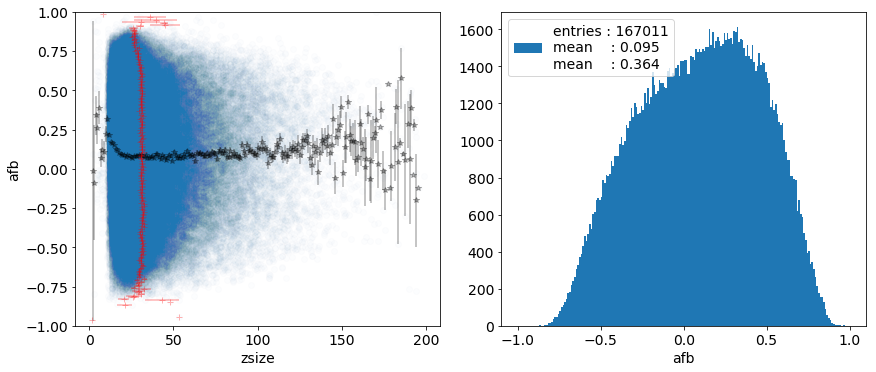

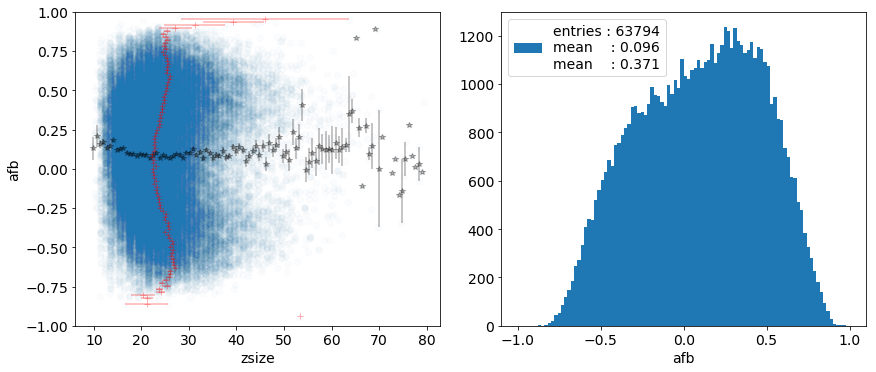

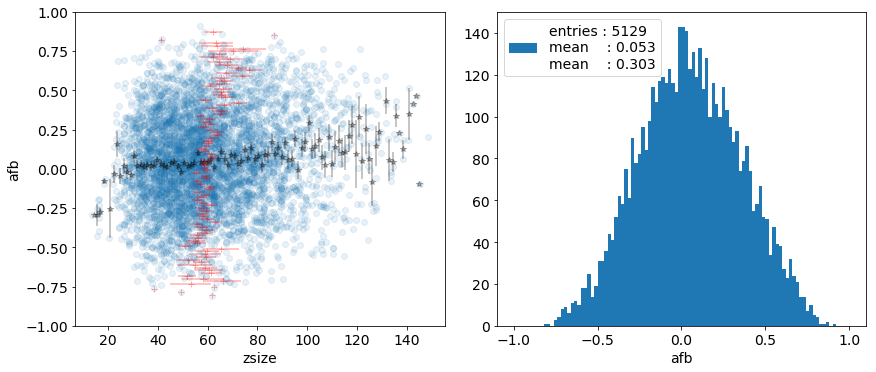

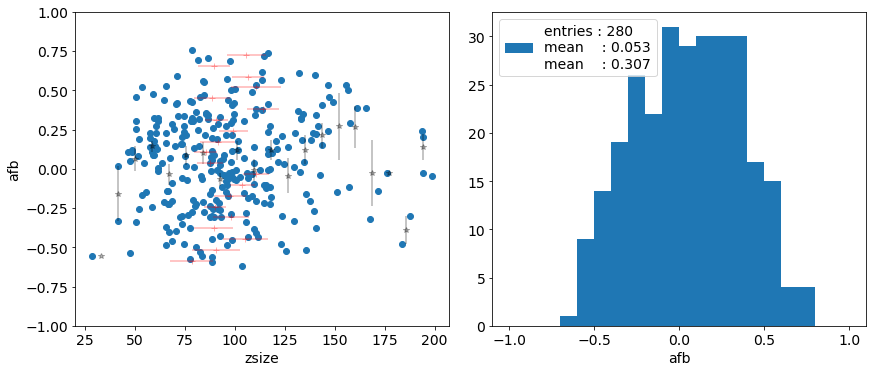

In [57]:
var_vs_var(esum, 'zsize', (0., 200), 'afb', ( -1, 1), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'afb', ( -1, 1), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'afb', ( -1, 1), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'afb', ( -1, 1), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

# fz1

In [58]:
esum['fz1'] = 2.*(esum.z1-esum.zu)/(esum.zsize)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


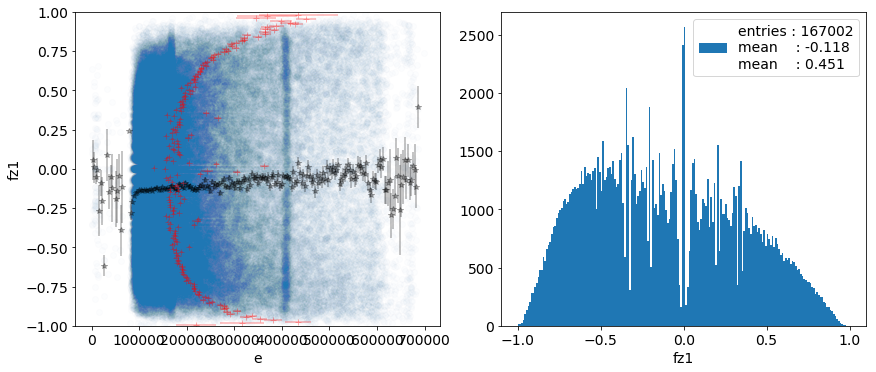

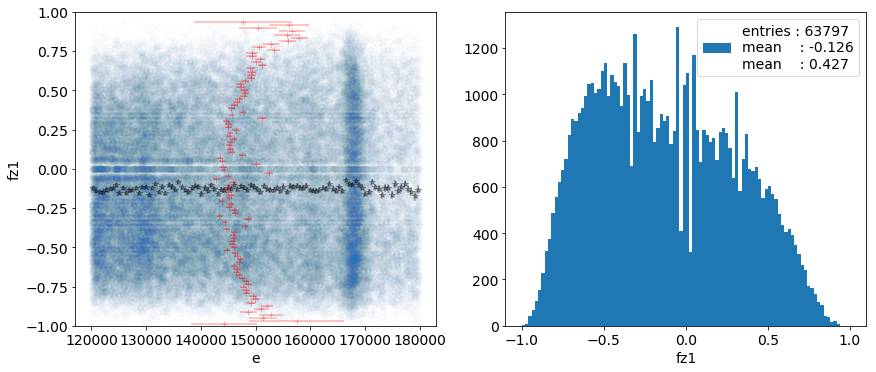

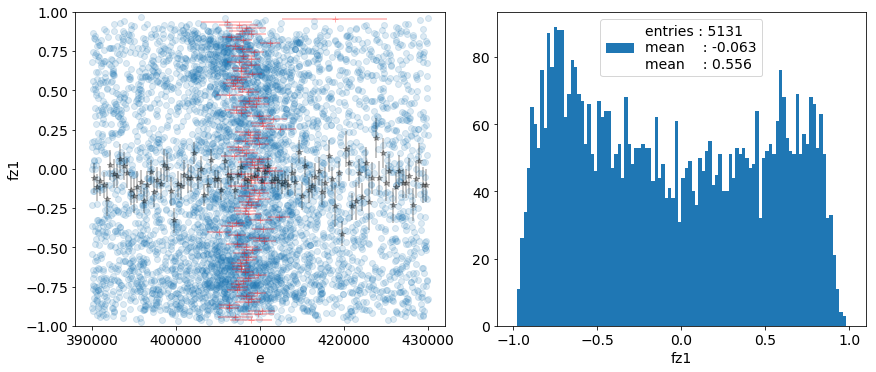

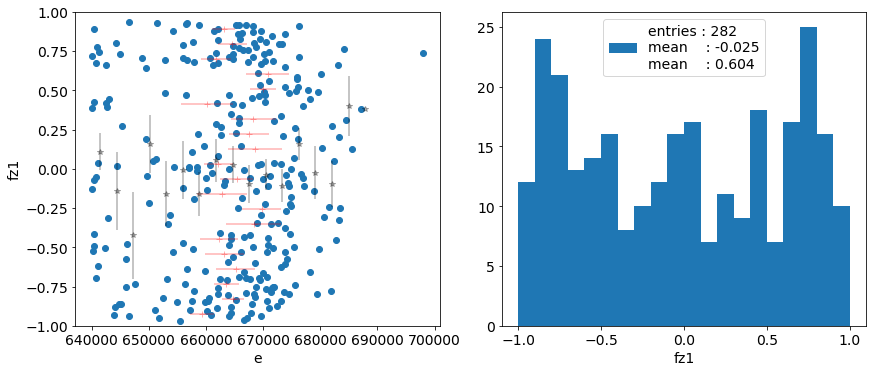

In [59]:
var_vs_var(esum, 'e', eax.range  , 'fz1', ( -1,  1), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'fz1', ( -1,  1), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'fz1', ( -1,  1), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'fz1', ( -1,  1), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


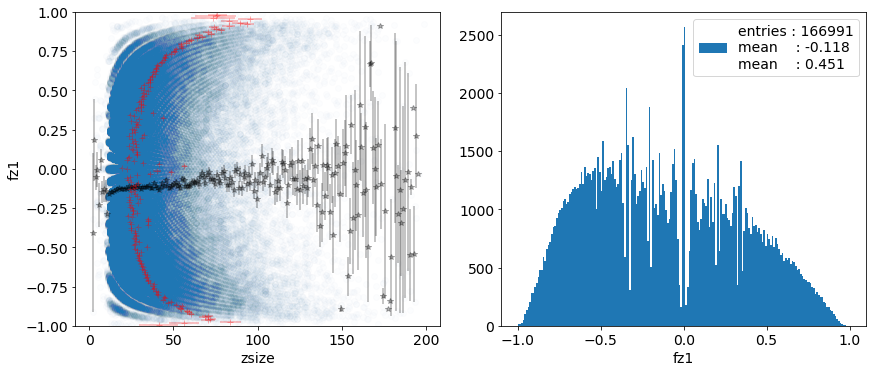

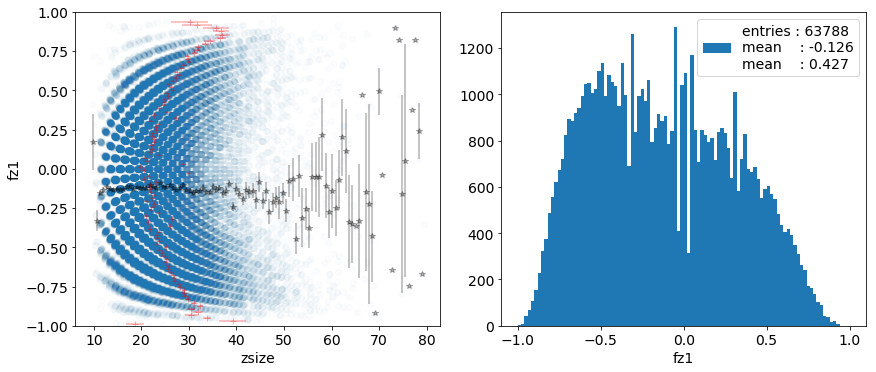

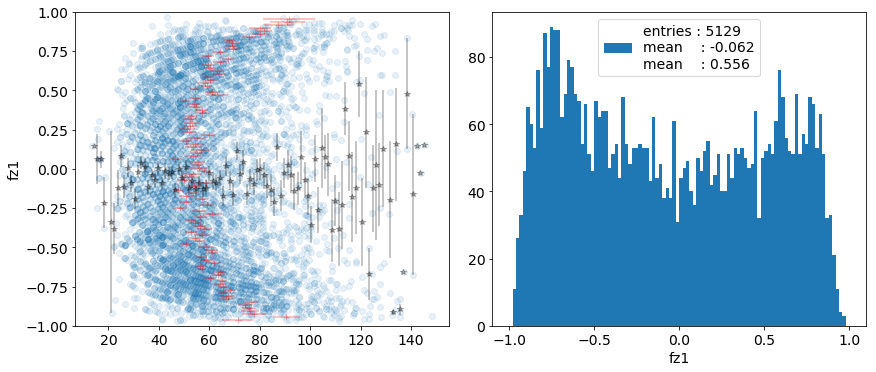

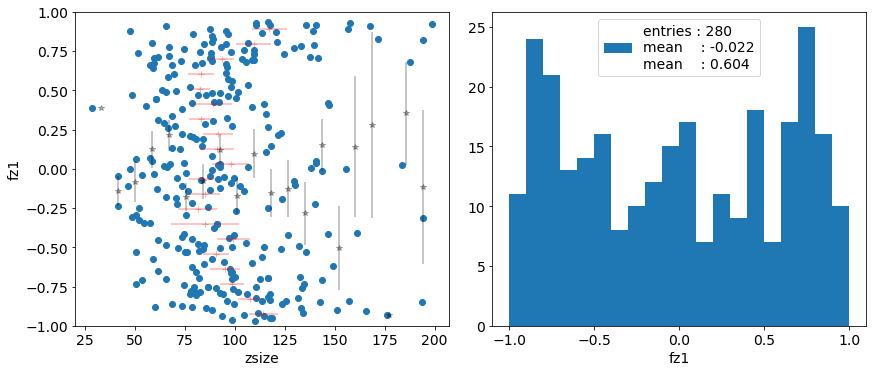

In [60]:
var_vs_var(esum, 'zsize', (0., 200), 'fz1', ( -1, 1), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'fz1', ( -1, 1), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'fz1', ( -1, 1), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'fz1', ( -1, 1), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## Fz2

In [61]:
esum['fz12'] = 2.*(esum.z2-esum.zu)/(esum.zsize)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


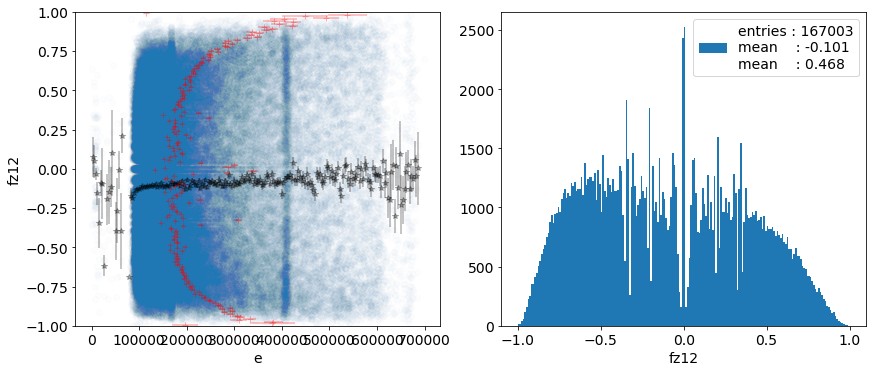

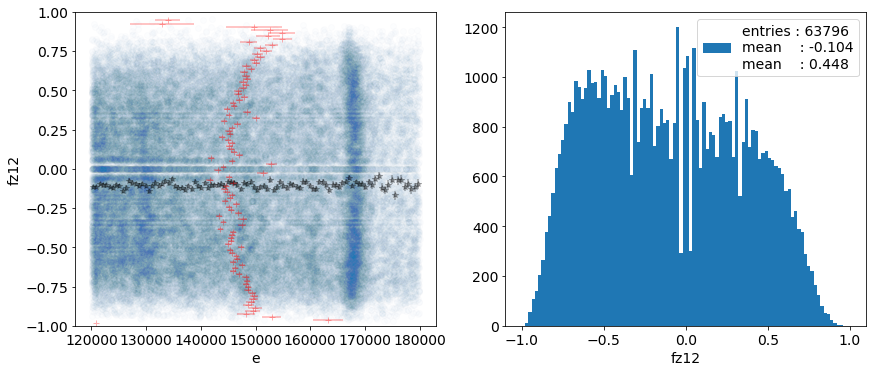

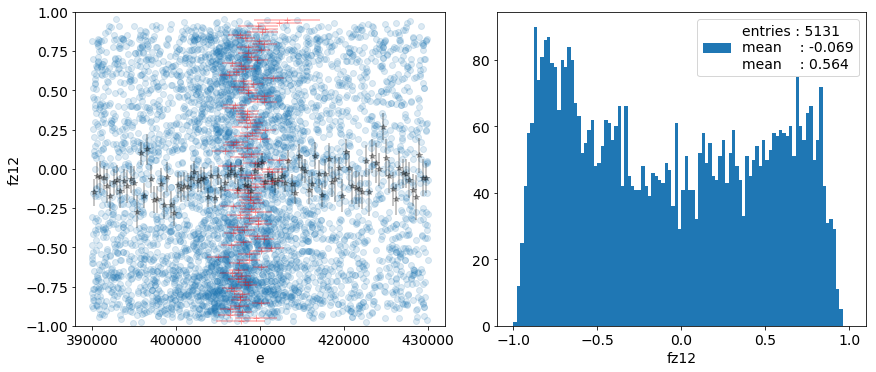

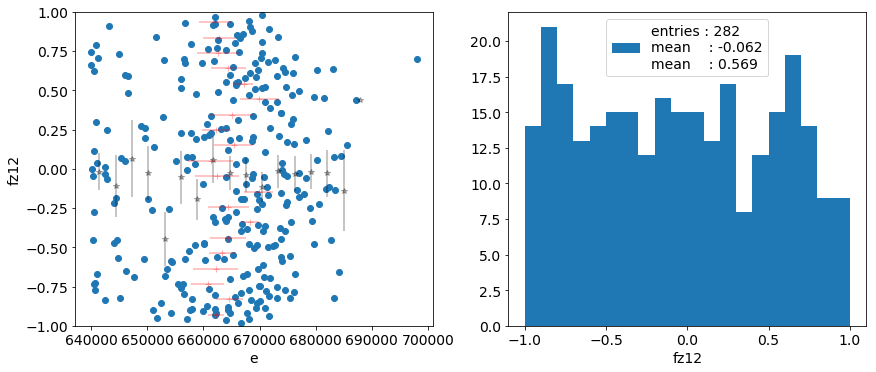

In [62]:
var_vs_var(esum, 'e', eax.range  , 'fz12', ( -1,  1), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'fz12', ( -1,  1), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'fz12', ( -1,  1), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'fz12', ( -1,  1), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


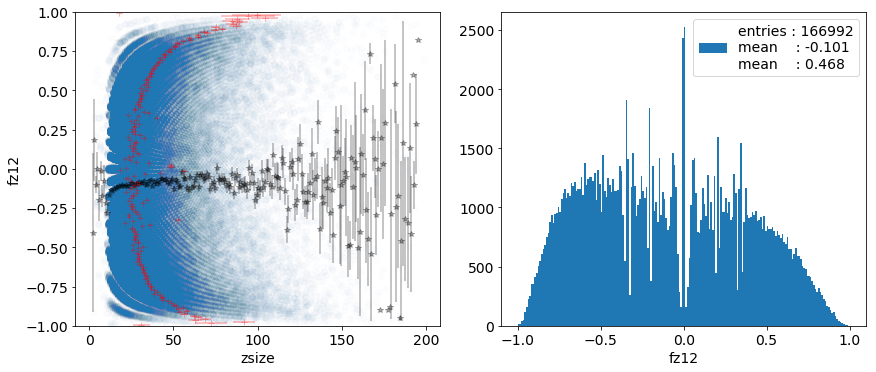

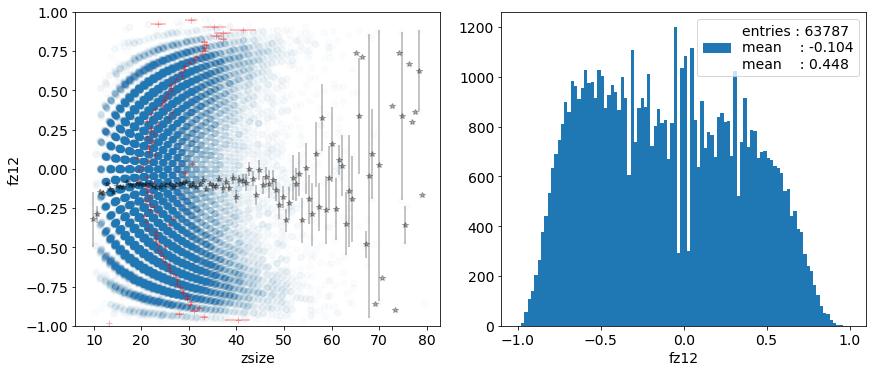

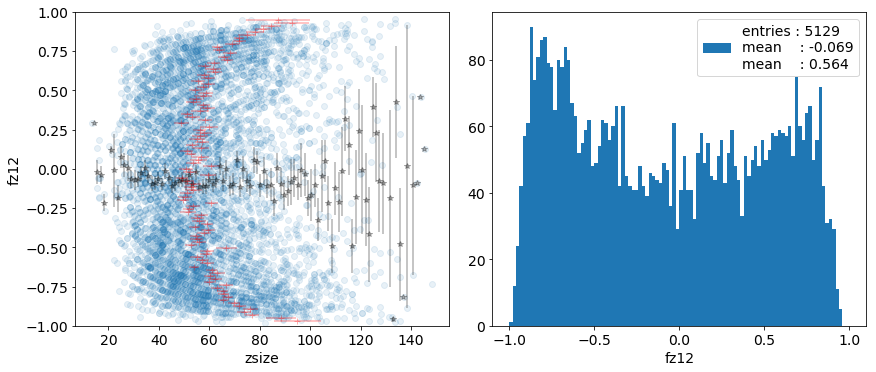

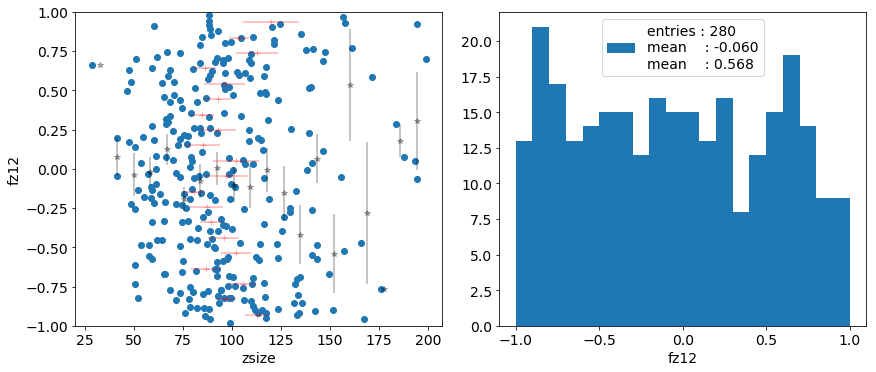

In [63]:
var_vs_var(esum, 'zsize', (0., 200), 'fz12', ( -1, 1), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'fz12', ( -1, 1), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'fz12', ( -1, 1), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'fz12', ( -1, 1), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## eblob1

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


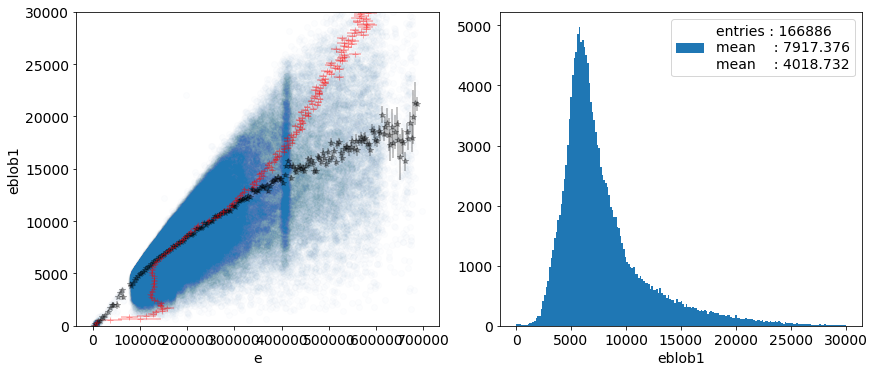

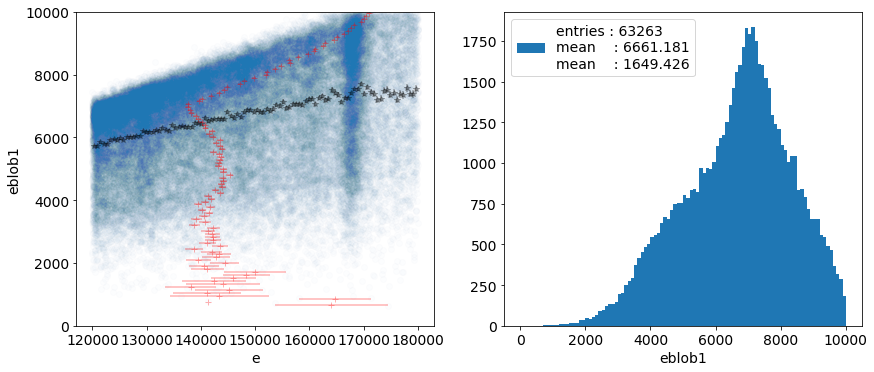

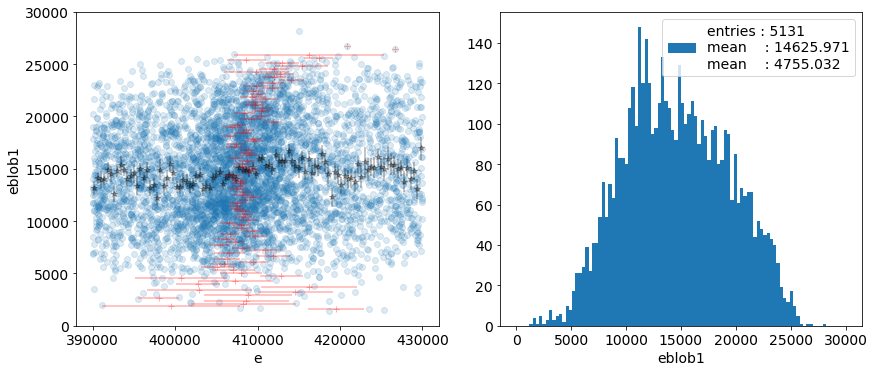

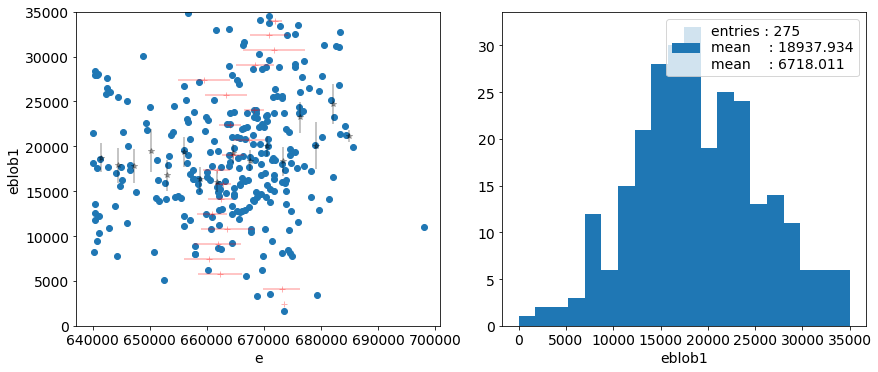

In [64]:
var_vs_var(esum, 'e', eax.range  , 'eblob1', ( 0,  30e3), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'eblob1', ( 0, 10e3), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'eblob1', ( 0, 30e3), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'eblob1', ( 0, 35e3), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


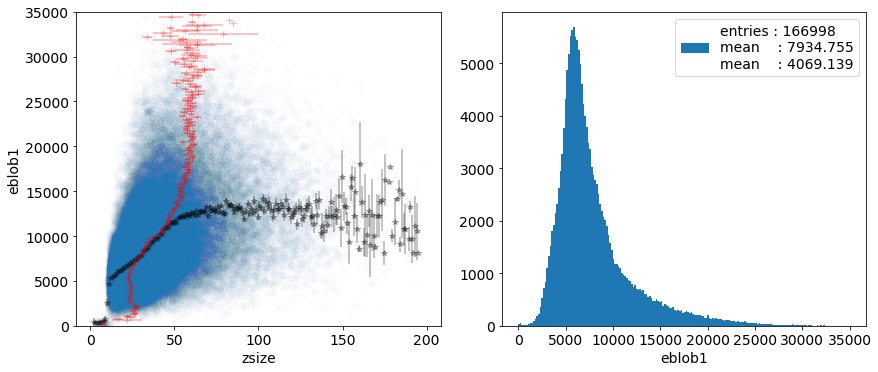

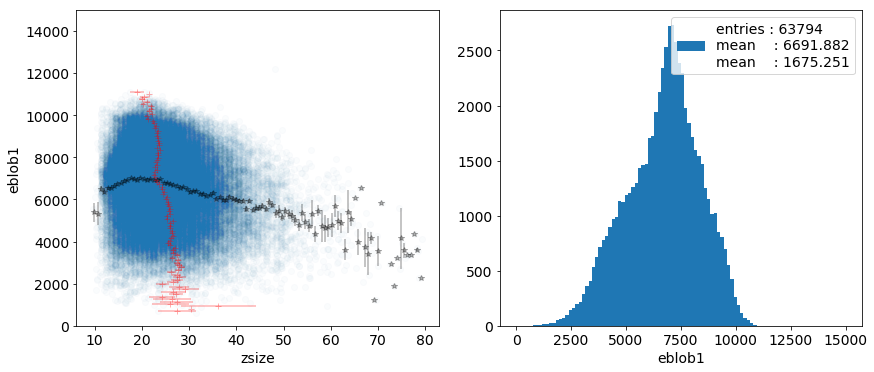

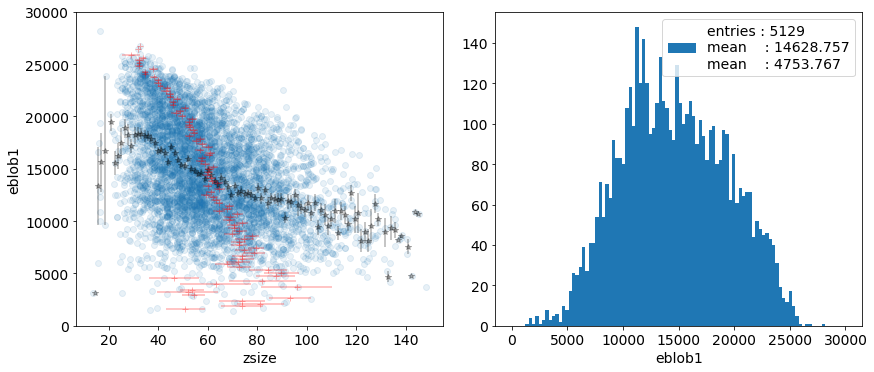

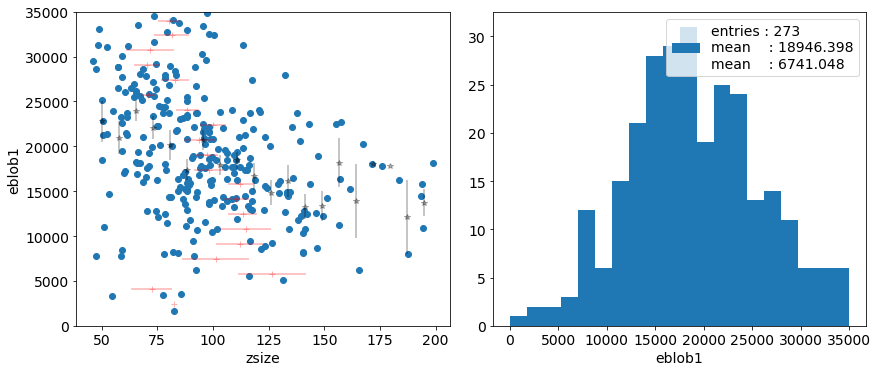

In [65]:
var_vs_var(esum, 'zsize', (0., 200), 'eblob1', ( 0, 35e3), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'eblob1', ( 0, 15e3), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'eblob1', ( 0, 30e3), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'eblob1', ( 0, 35e3), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

# eblob2

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


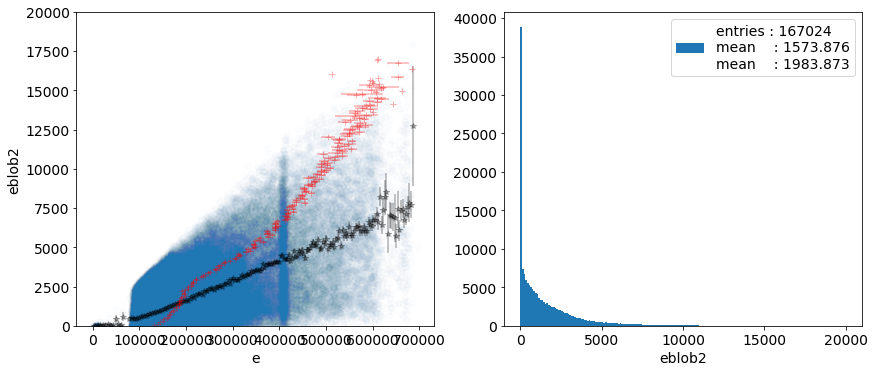

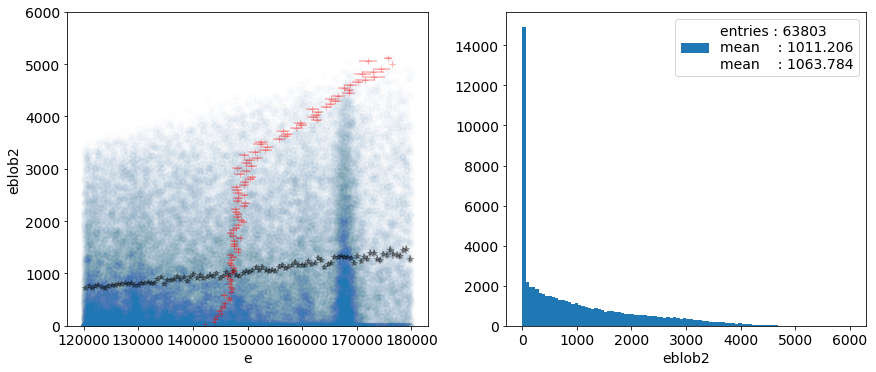

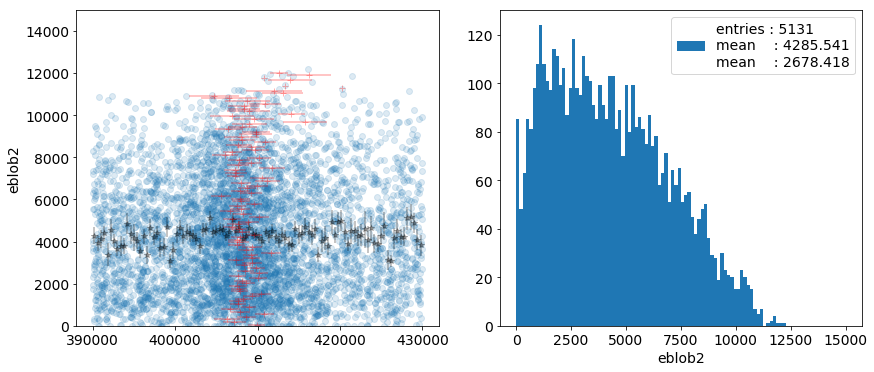

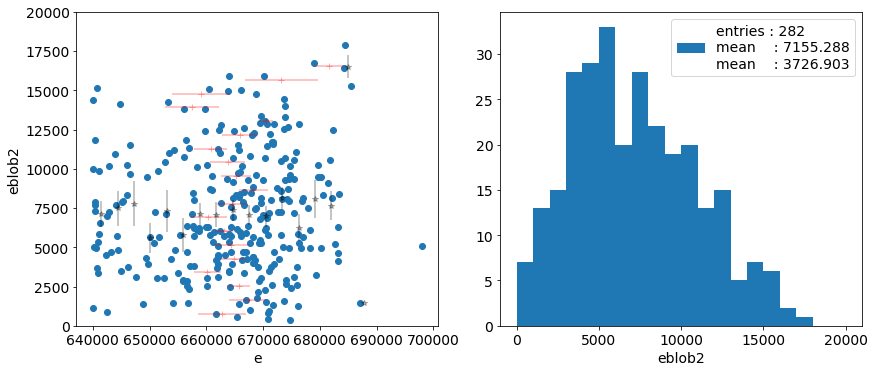

In [66]:
var_vs_var(esum, 'e', eax.range  , 'eblob2', ( 0, 20e3), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'eblob2', ( 0,  6e3), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'eblob2', ( 0, 15e3), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'eblob2', ( 0, 20e3), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


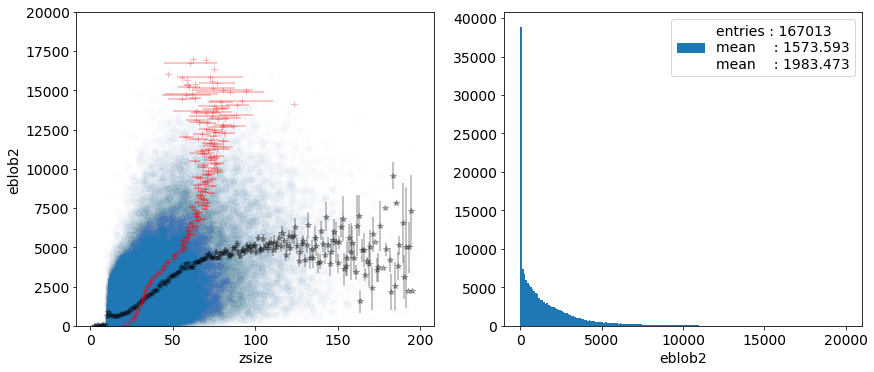

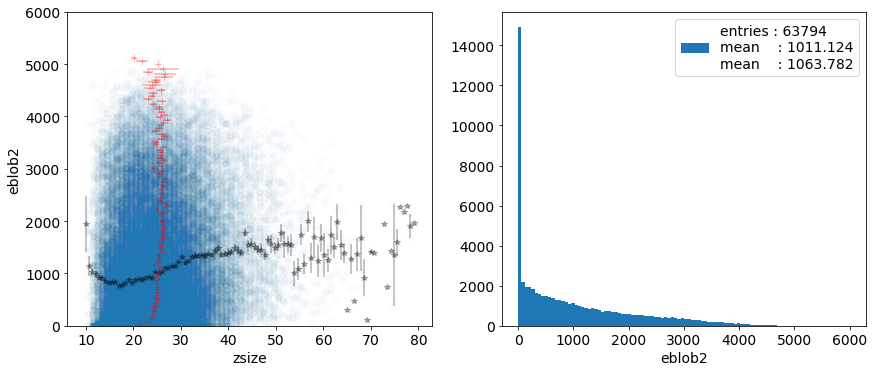

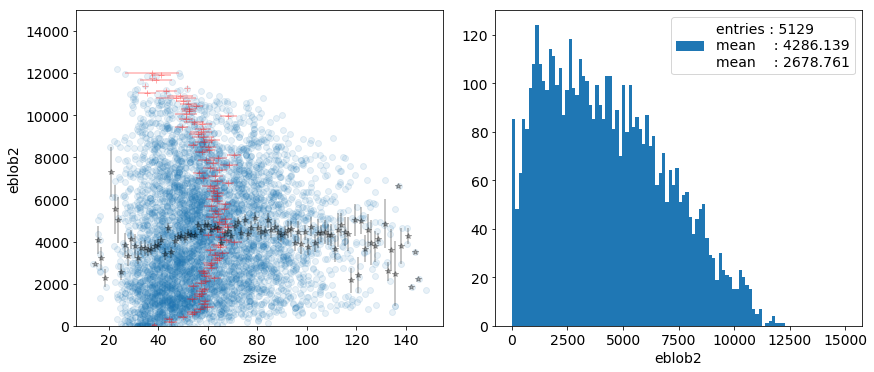

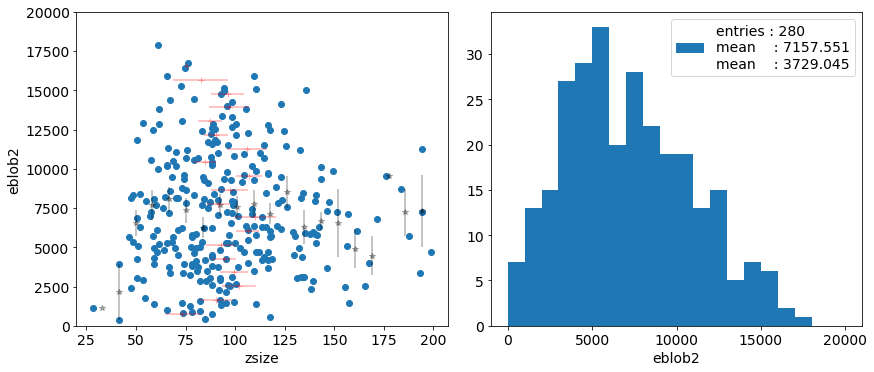

In [67]:
var_vs_var(esum, 'zsize', (0., 200), 'eblob2', ( 0, 20e3), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'eblob2', ( 0,  6e3), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'eblob2', ( 0, 15e3), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'eblob2', ( 0, 20e3), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## blob asymmetry

In [68]:
esum['ab'] = (esum.eblob1-esum.eblob2)/esum.eblob1

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


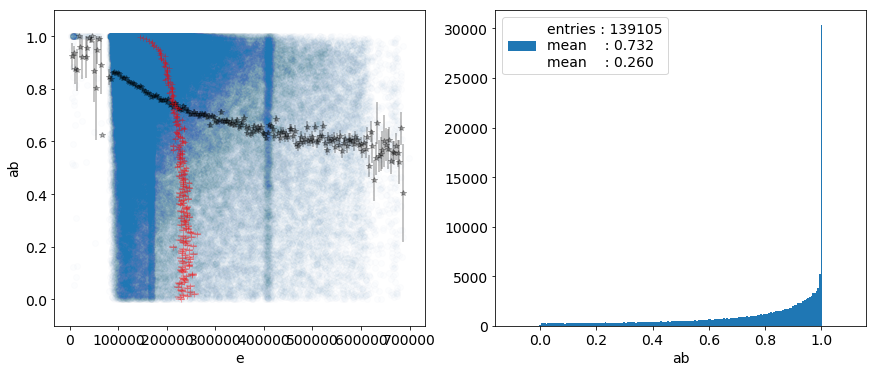

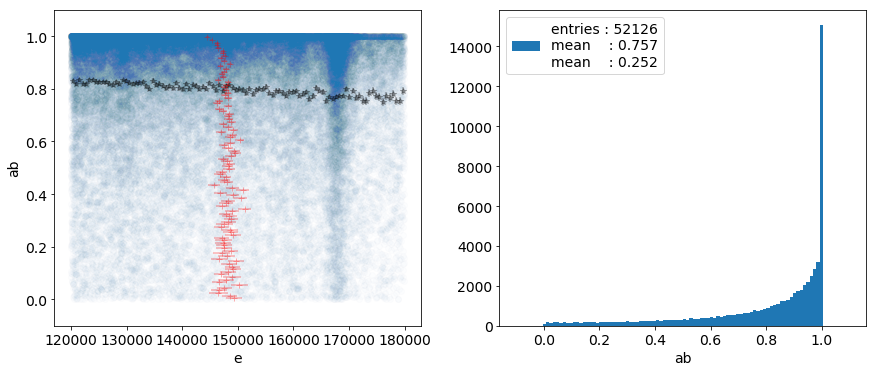

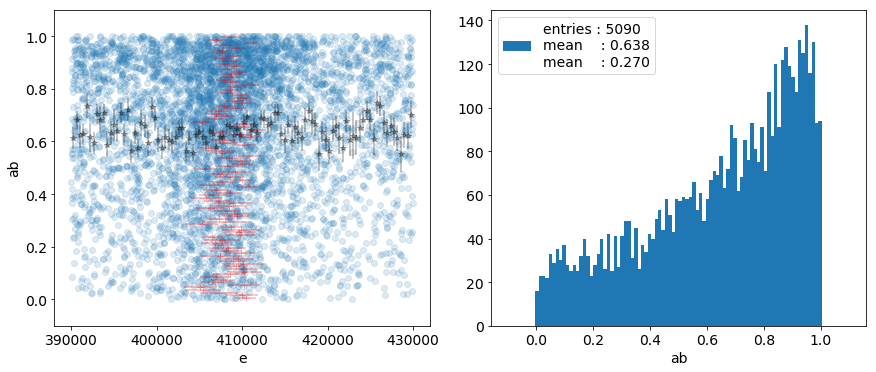

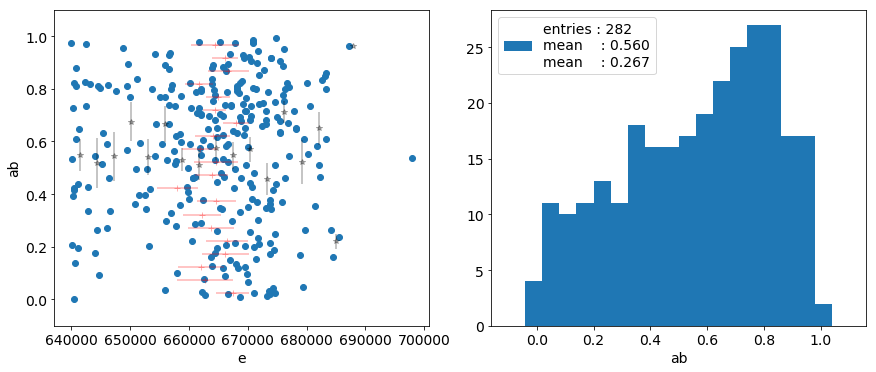

In [69]:
var_vs_var(esum, 'e', eax.range  , 'ab', ( -0.1, 1.1), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'ab', ( -0.1, 1.1), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'ab', ( -0.1, 1.1), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'ab', ( -0.1, 1.1), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


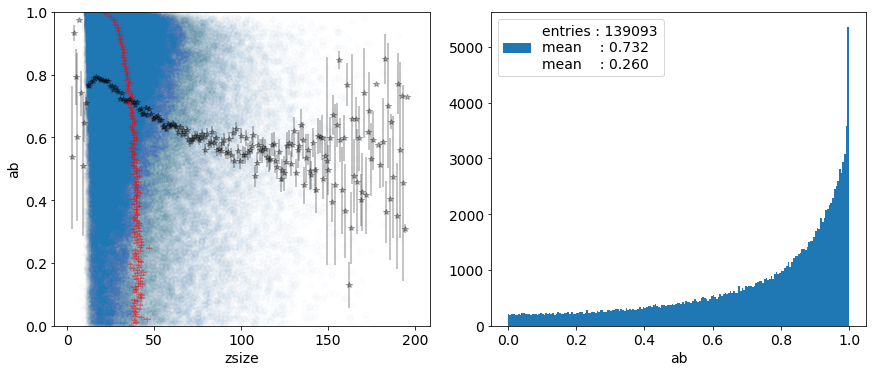

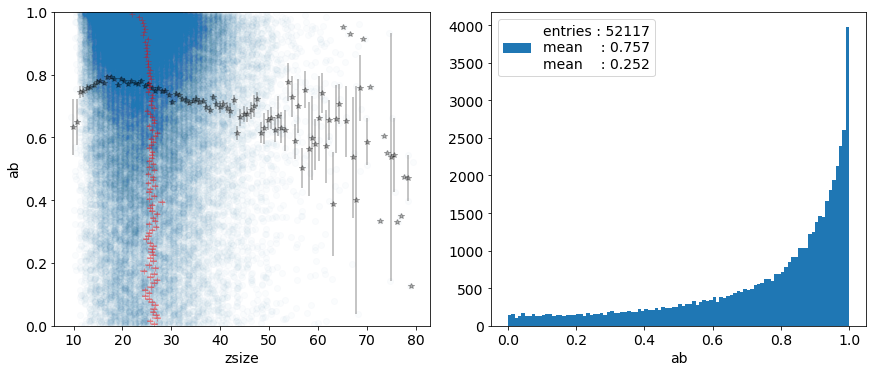

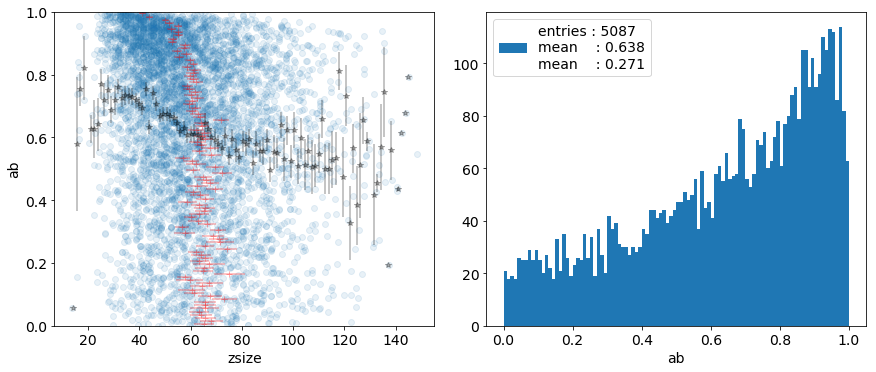

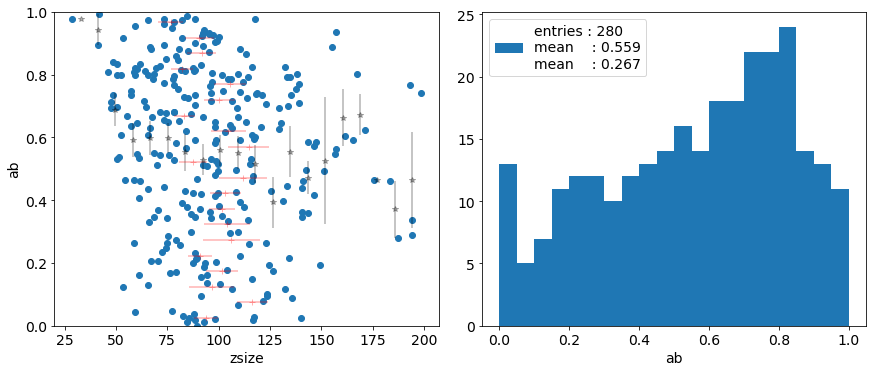

In [70]:
var_vs_var(esum, 'zsize', (0., 200), 'ab', ( 0, 1), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'ab', ( 0, 1), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'ab', ( 0, 1), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'ab', ( 0, 1), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## rmax

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


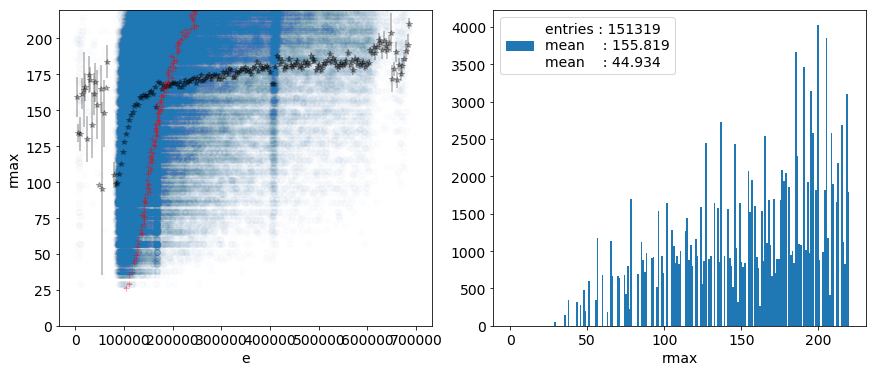

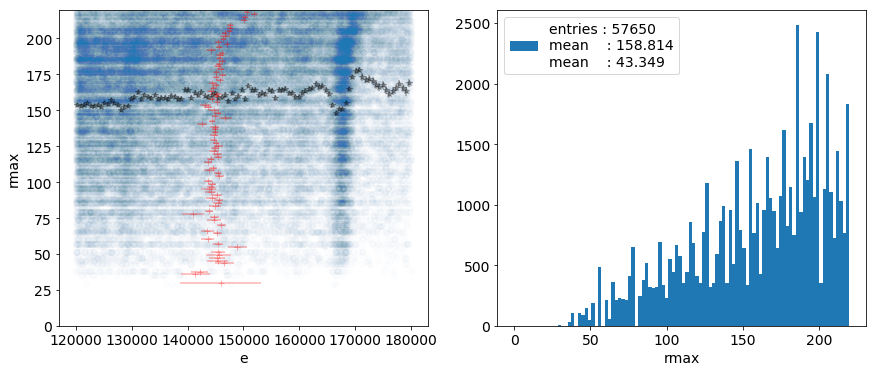

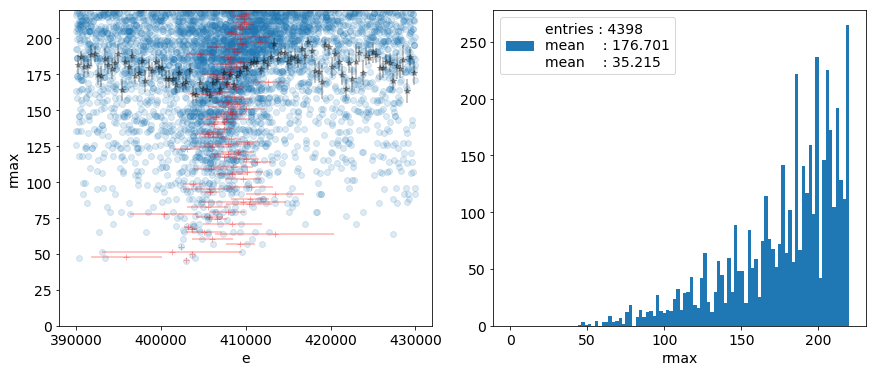

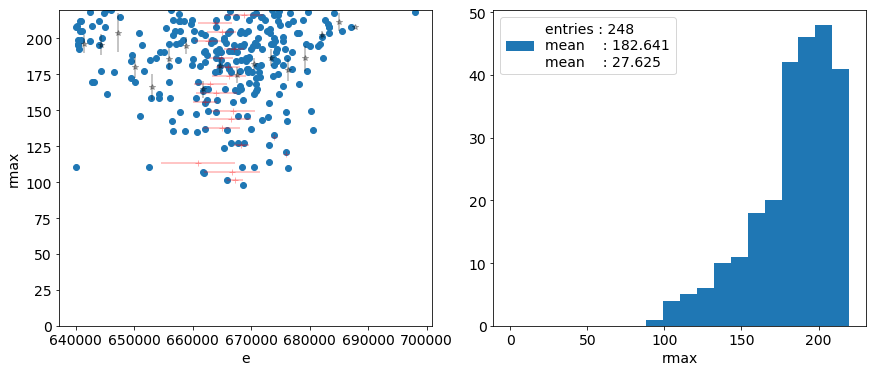

In [71]:
var_vs_var(esum, 'e', eax.range  , 'rmax', ( 0., 220), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'rmax', ( 0., 220), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'rmax', ( 0., 220), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'rmax', ( 0., 220), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


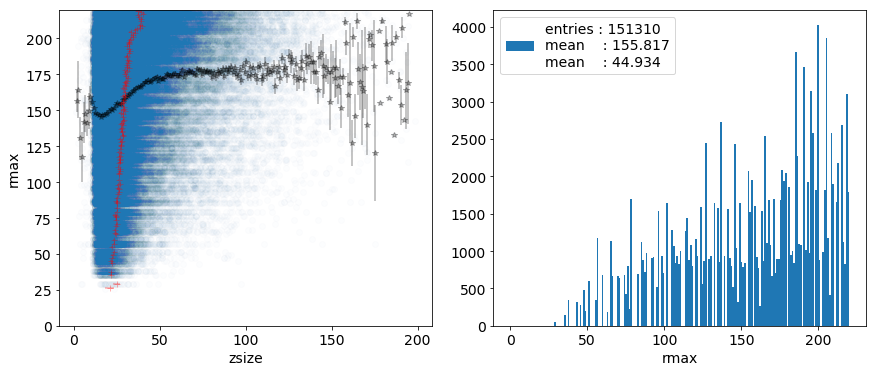

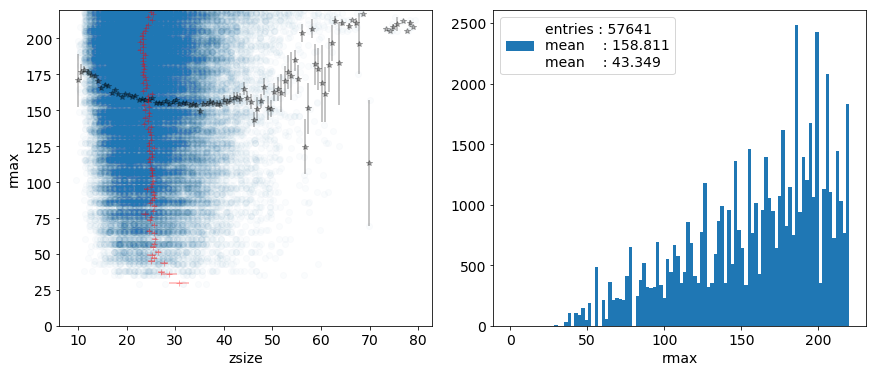

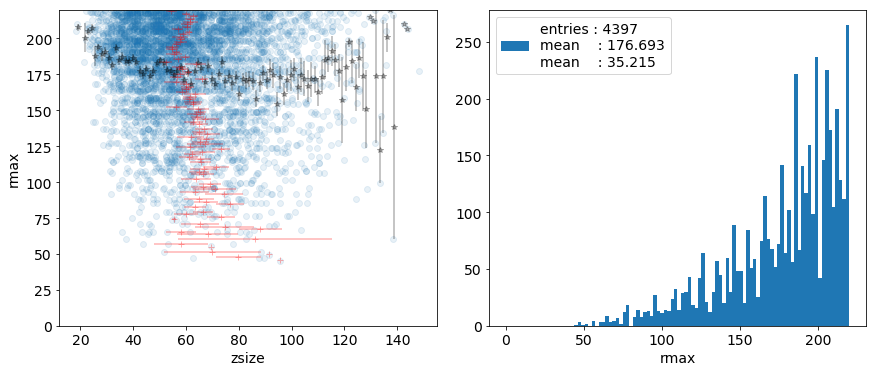

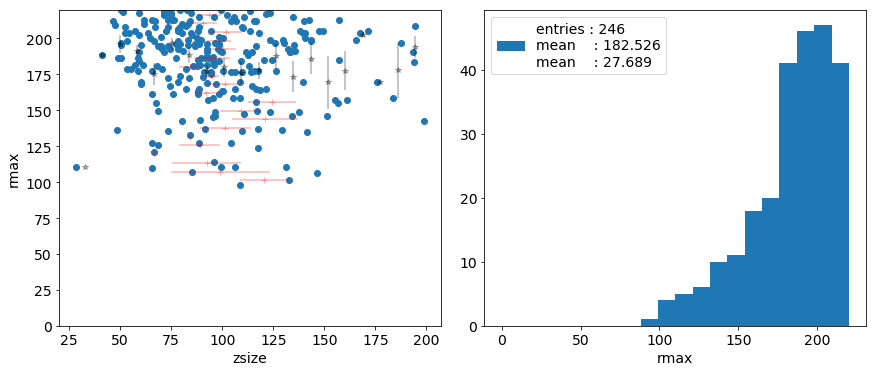

In [72]:
var_vs_var(esum, 'zsize', (0., 200), 'rmax', ( 0, 220), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'rmax', ( 0, 220), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'rmax', ( 0, 220), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'rmax', ( 0, 220), nbins = etlax.nbins, sel = tlsel, alpha = 1.)

## rsize

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


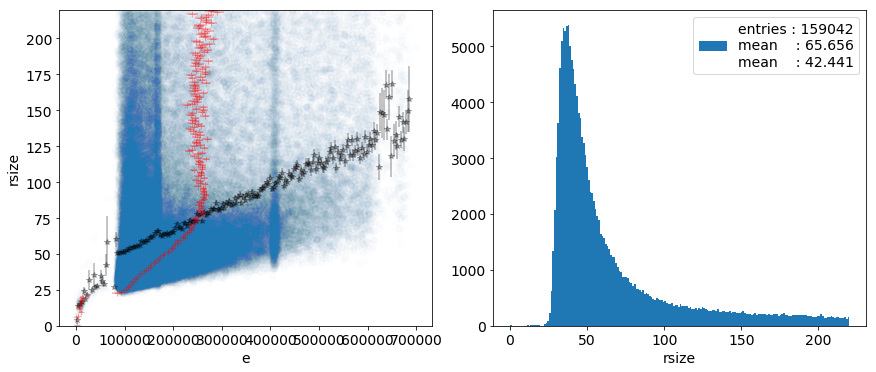

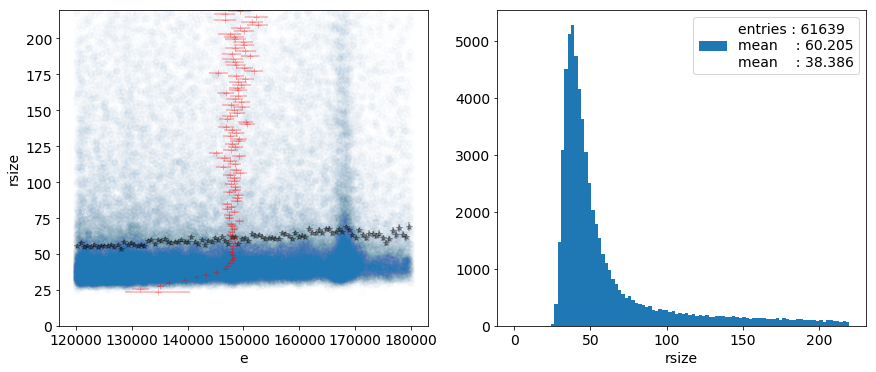

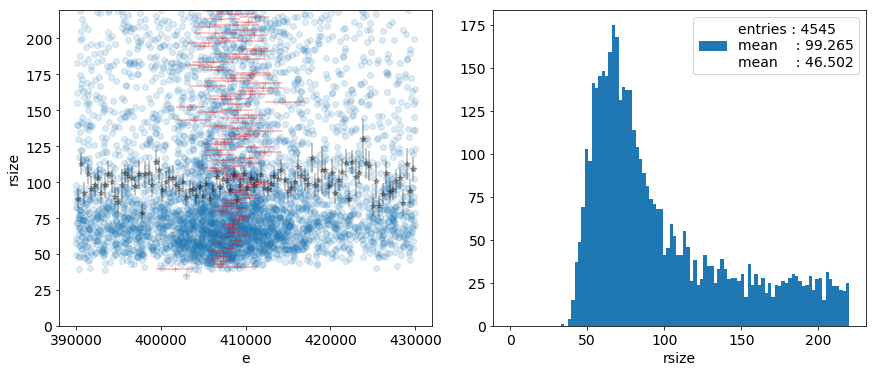

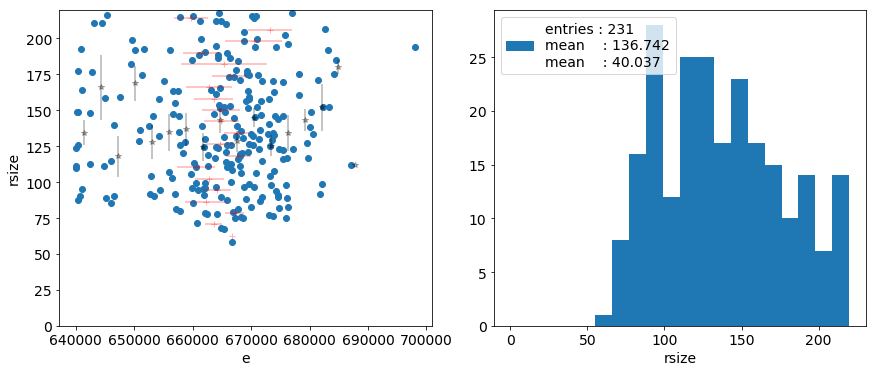

In [73]:
var_vs_var(esum, 'e', eax.range  , 'rsize', ( 0., 220), nbins = eax.nbins  , alpha = 0.01)
var_vs_var(esum, 'e', ecsax.range, 'rsize', ( 0., 220), nbins = ecsax.nbins, alpha = 0.01)
var_vs_var(esum, 'e', edsax.range, 'rsize', ( 0., 220), nbins = edsax.nbins, alpha = 0.15)
var_vs_var(esum, 'e', etlax.range, 'rsize', ( 0., 220), nbins = etlax.nbins, alpha = 1.)

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


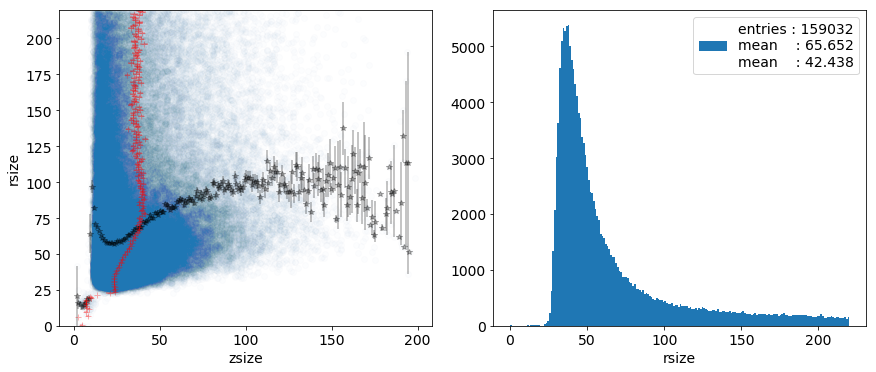

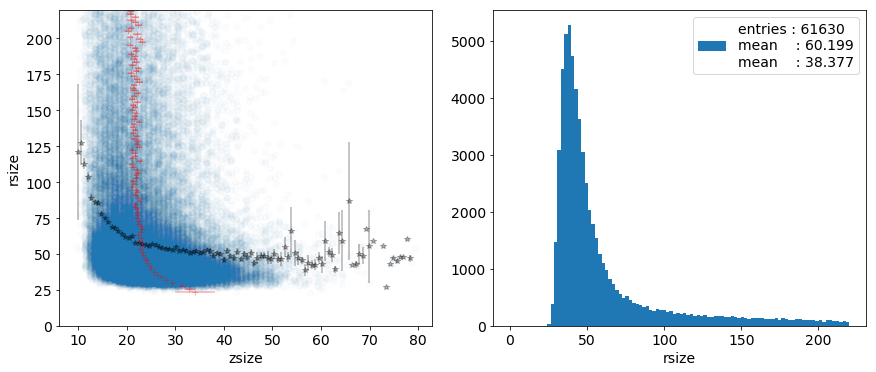

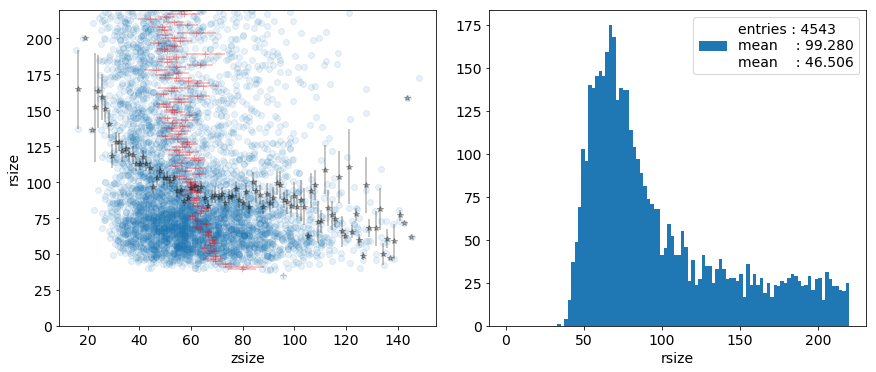

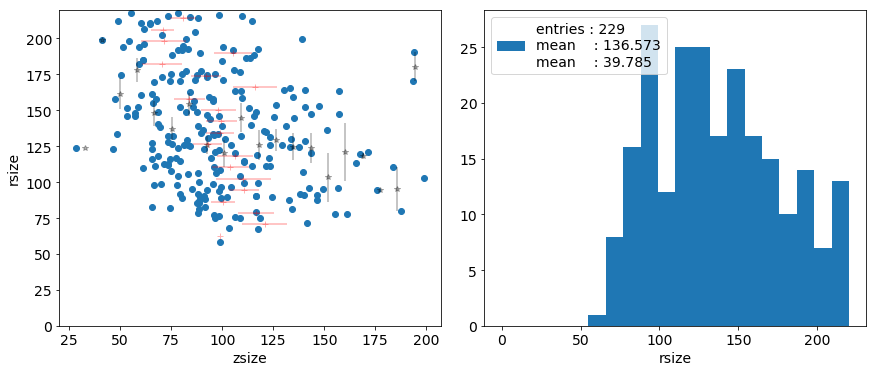

In [74]:
var_vs_var(esum, 'zsize', (0., 200), 'rsize', ( 0, 220), nbins =   eax.nbins, sel = esel , alpha = 0.01)
var_vs_var(esum, 'zsize', (0.,  80), 'rsize', ( 0, 220), nbins = ecsax.nbins, sel = cssel, alpha = 0.02)
var_vs_var(esum, 'zsize', (0., 150), 'rsize', ( 0, 220), nbins = edsax.nbins, sel = dssel, alpha = 0.1)
var_vs_var(esum, 'zsize', (0., 200), 'rsize', ( 0, 220), nbins = etlax.nbins, sel = tlsel, alpha = 1.)